<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_10_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

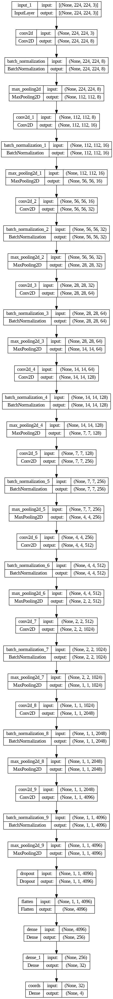

In [18]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True, show_layer_names=True, rankdir='TB', expand_nested=True)

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [24]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 41.7833 - IoU: 0.0348
Epoch 1: val_IoU improved from -inf to 0.02879, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 103ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 39ms/step
4


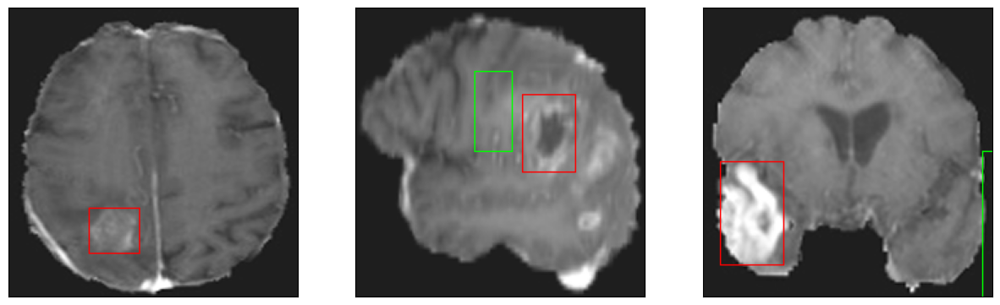

26/26 [==============================] - 38s 723ms/step - loss: 41.7833 - IoU: 0.0348 - val_loss: 58.8911 - val_IoU: 0.0288
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 27.0969 - IoU: 0.0666
Epoch 2: val_IoU improved from 0.02879 to 0.04735, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


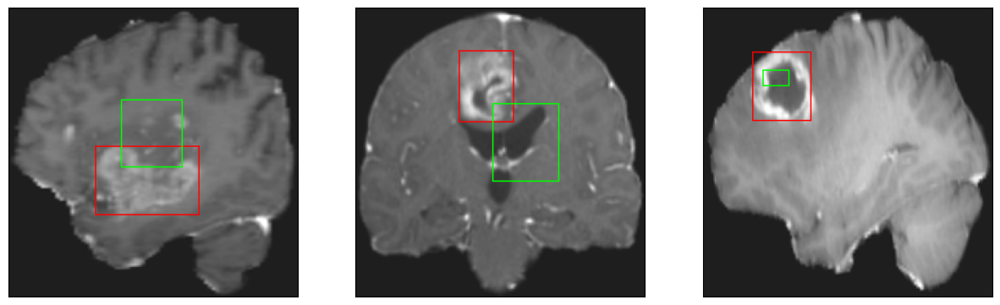

26/26 [==============================] - 14s 539ms/step - loss: 27.0969 - IoU: 0.0666 - val_loss: 29.5010 - val_IoU: 0.0473
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 25.8962 - IoU: 0.0783
Epoch 3: val_IoU did not improve from 0.04735
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


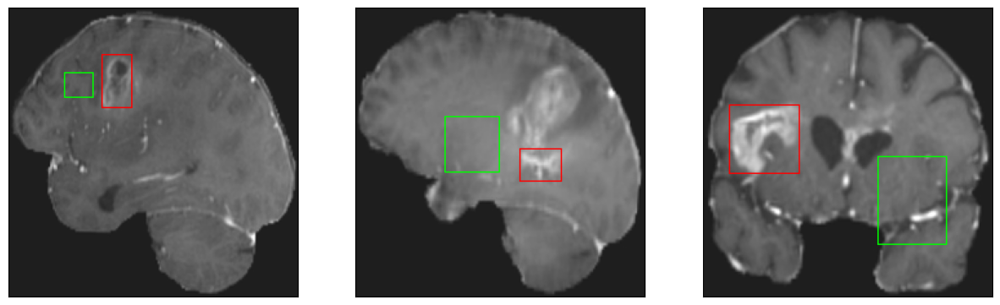

26/26 [==============================] - 8s 297ms/step - loss: 25.8962 - IoU: 0.0783 - val_loss: 30.4903 - val_IoU: 0.0426
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 25.8650 - IoU: 0.0895
Epoch 4: val_IoU did not improve from 0.04735
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


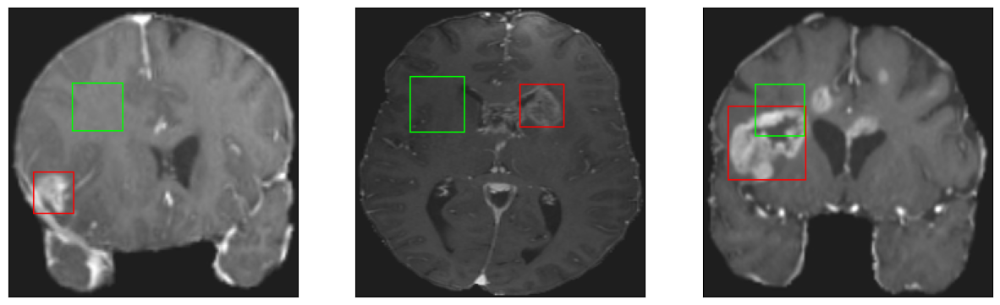

26/26 [==============================] - 7s 284ms/step - loss: 25.8650 - IoU: 0.0895 - val_loss: 32.4057 - val_IoU: 0.0264
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 24.5225 - IoU: 0.1054
Epoch 5: val_IoU improved from 0.04735 to 0.08999, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


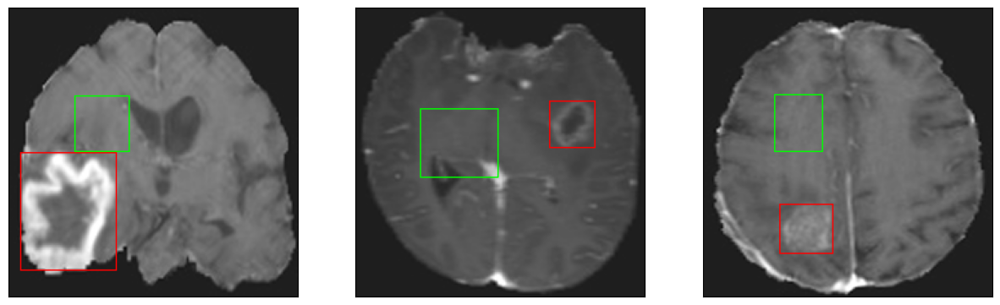

26/26 [==============================] - 24s 947ms/step - loss: 24.5225 - IoU: 0.1054 - val_loss: 23.8331 - val_IoU: 0.0900
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 23.0469 - IoU: 0.1189
Epoch 6: val_IoU did not improve from 0.08999
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


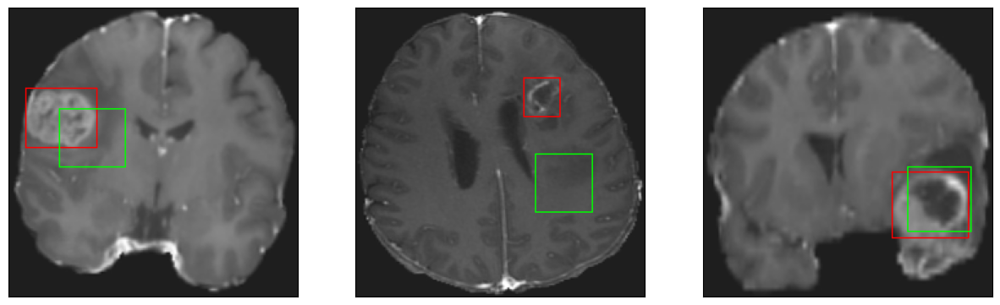

26/26 [==============================] - 7s 282ms/step - loss: 23.0469 - IoU: 0.1189 - val_loss: 24.8601 - val_IoU: 0.0868
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 21.2675 - IoU: 0.1484
Epoch 7: val_IoU did not improve from 0.08999
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


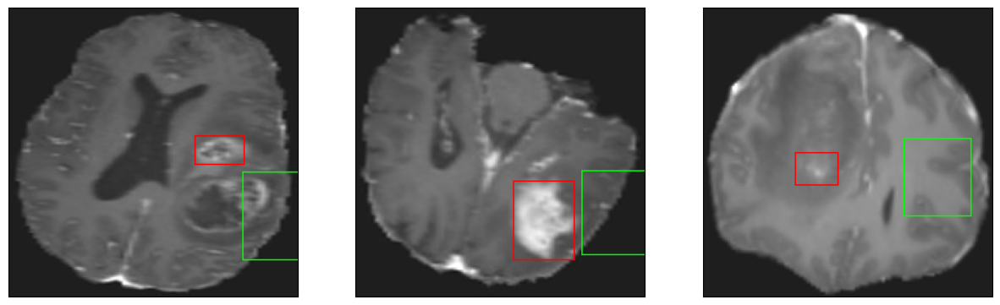

26/26 [==============================] - 7s 287ms/step - loss: 21.2675 - IoU: 0.1484 - val_loss: 29.3393 - val_IoU: 0.0874
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 19.3160 - IoU: 0.1867
Epoch 8: val_IoU improved from 0.08999 to 0.11708, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


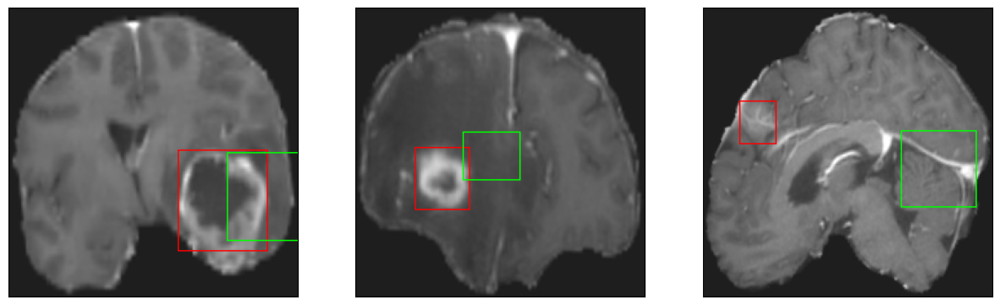

26/26 [==============================] - 26s 1s/step - loss: 19.3160 - IoU: 0.1867 - val_loss: 25.4952 - val_IoU: 0.1171
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 16.7640 - IoU: 0.2396
Epoch 9: val_IoU did not improve from 0.11708
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


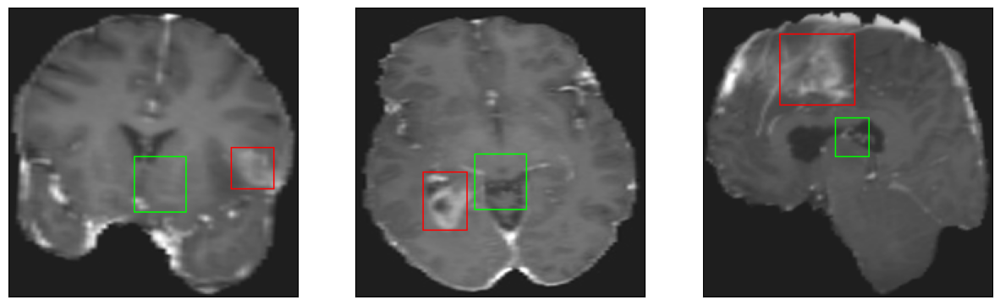

26/26 [==============================] - 7s 276ms/step - loss: 16.7640 - IoU: 0.2396 - val_loss: 22.8714 - val_IoU: 0.0959
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 16.3068 - IoU: 0.2371
Epoch 10: val_IoU improved from 0.11708 to 0.17536, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


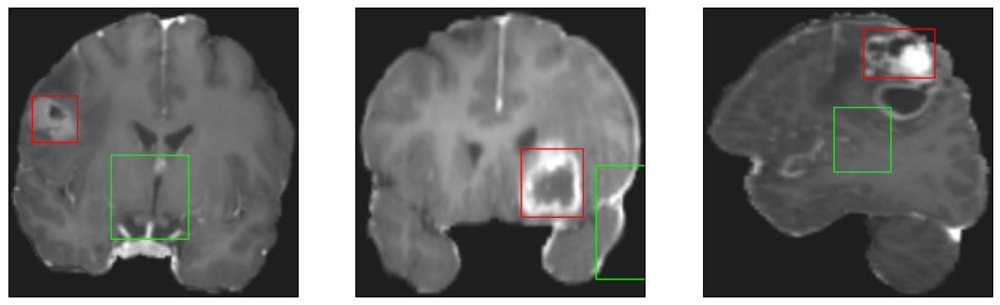

26/26 [==============================] - 14s 531ms/step - loss: 16.3068 - IoU: 0.2371 - val_loss: 27.7889 - val_IoU: 0.1754
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 14.9323 - IoU: 0.2753
Epoch 11: val_IoU improved from 0.17536 to 0.22274, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


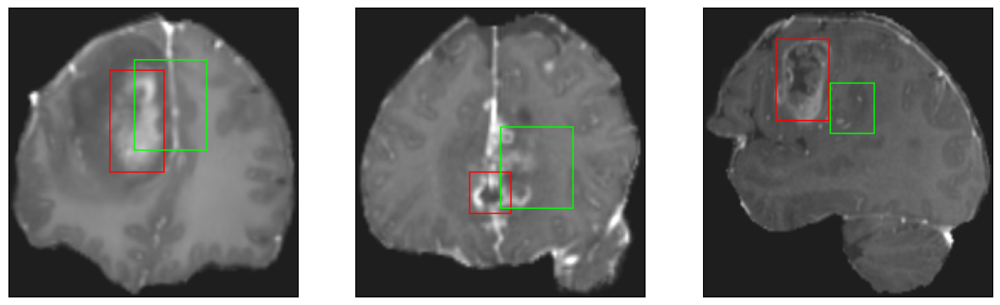

26/26 [==============================] - 14s 569ms/step - loss: 14.9323 - IoU: 0.2753 - val_loss: 21.0750 - val_IoU: 0.2227
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 13.7599 - IoU: 0.3075
Epoch 12: val_IoU did not improve from 0.22274
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


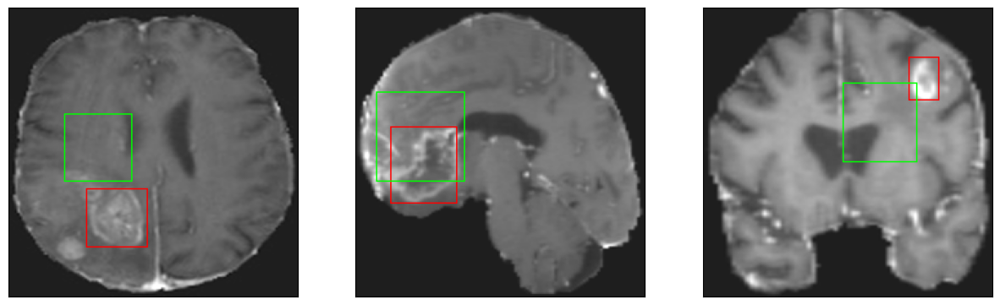

26/26 [==============================] - 7s 276ms/step - loss: 13.7599 - IoU: 0.3075 - val_loss: 19.8480 - val_IoU: 0.1791
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 13.5300 - IoU: 0.2975
Epoch 13: val_IoU improved from 0.22274 to 0.30054, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


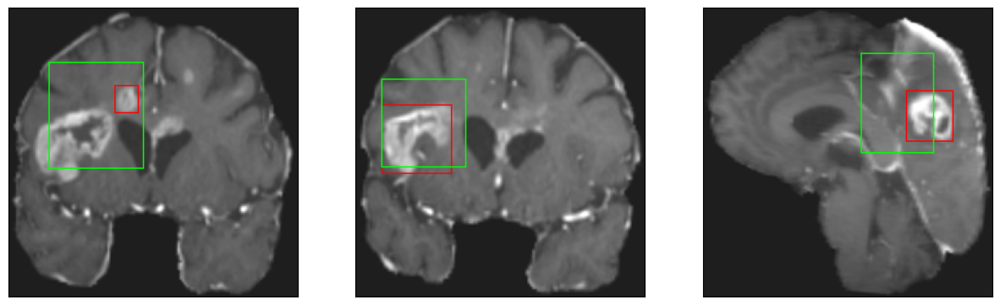

26/26 [==============================] - 16s 615ms/step - loss: 13.5300 - IoU: 0.2975 - val_loss: 17.0801 - val_IoU: 0.3005
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 13.5576 - IoU: 0.3041
Epoch 14: val_IoU did not improve from 0.30054
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 43ms/step
4


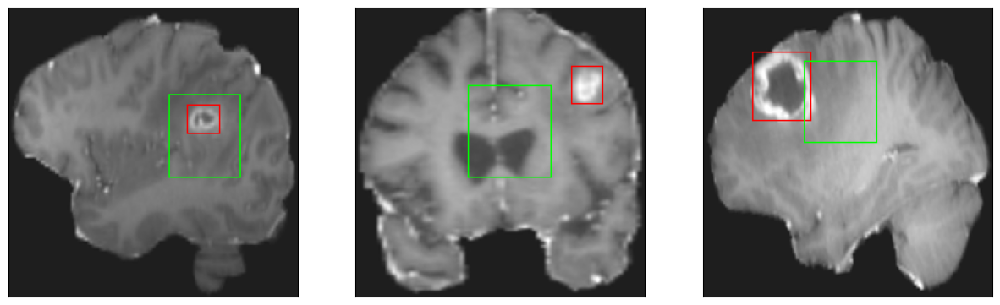

26/26 [==============================] - 7s 274ms/step - loss: 13.5576 - IoU: 0.3041 - val_loss: 17.6501 - val_IoU: 0.2549
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 13.2319 - IoU: 0.3036
Epoch 15: val_IoU improved from 0.30054 to 0.30861, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


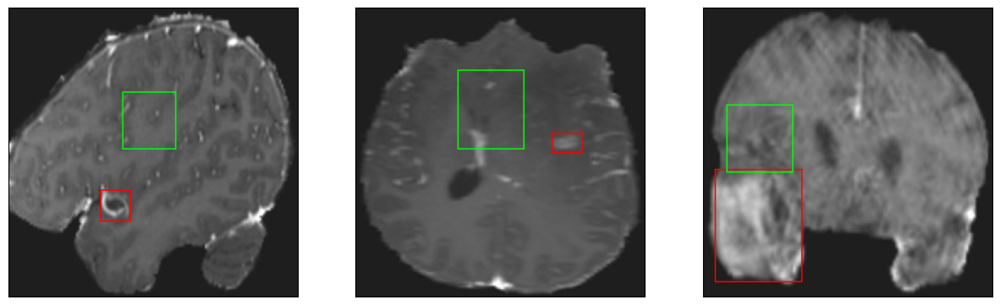

26/26 [==============================] - 19s 760ms/step - loss: 13.2319 - IoU: 0.3036 - val_loss: 15.2836 - val_IoU: 0.3086
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 12.0030 - IoU: 0.3423
Epoch 16: val_IoU improved from 0.30861 to 0.34795, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


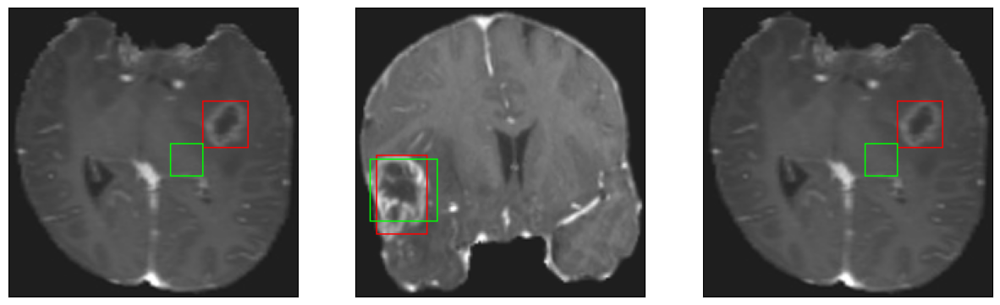

26/26 [==============================] - 17s 683ms/step - loss: 12.0030 - IoU: 0.3423 - val_loss: 12.2233 - val_IoU: 0.3479
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 11.6542 - IoU: 0.3557
Epoch 17: val_IoU did not improve from 0.34795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


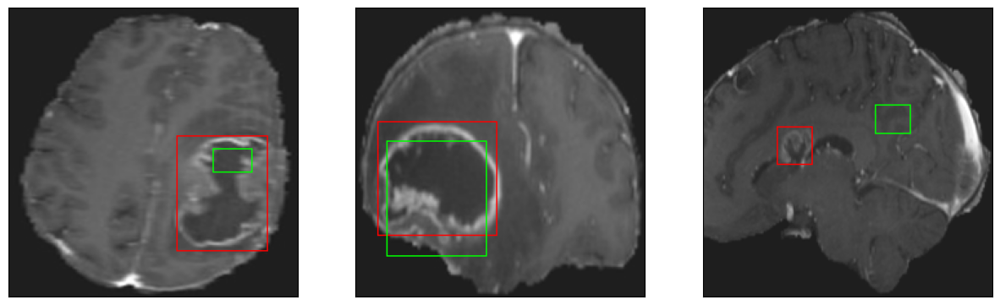

26/26 [==============================] - 7s 289ms/step - loss: 11.6542 - IoU: 0.3557 - val_loss: 14.4218 - val_IoU: 0.2993
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 11.5728 - IoU: 0.3600
Epoch 18: val_IoU did not improve from 0.34795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


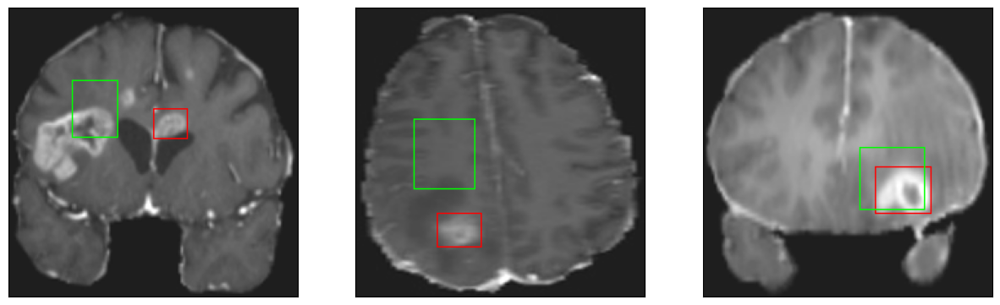

26/26 [==============================] - 7s 289ms/step - loss: 11.5728 - IoU: 0.3600 - val_loss: 16.6483 - val_IoU: 0.2278
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 11.3345 - IoU: 0.3648
Epoch 19: val_IoU did not improve from 0.34795
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


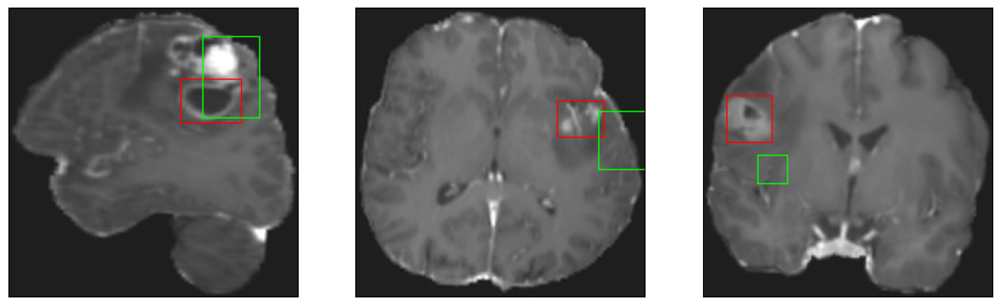

26/26 [==============================] - 8s 298ms/step - loss: 11.3345 - IoU: 0.3648 - val_loss: 13.2759 - val_IoU: 0.3007
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 10.5484 - IoU: 0.3818
Epoch 20: val_IoU did not improve from 0.34795
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


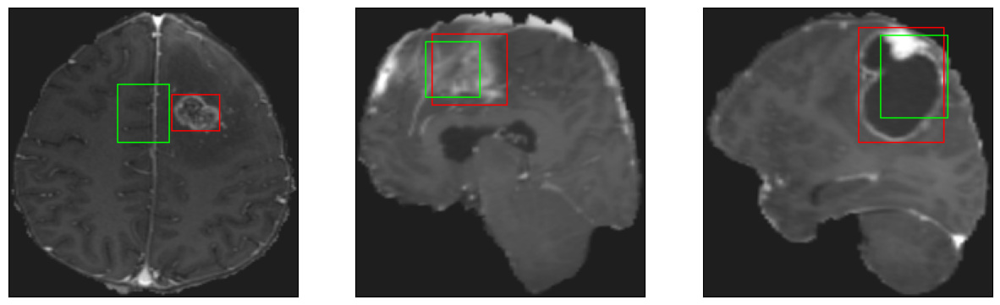

26/26 [==============================] - 7s 281ms/step - loss: 10.5484 - IoU: 0.3818 - val_loss: 12.9569 - val_IoU: 0.3282
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 11.1009 - IoU: 0.3571
Epoch 21: val_IoU improved from 0.34795 to 0.42740, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


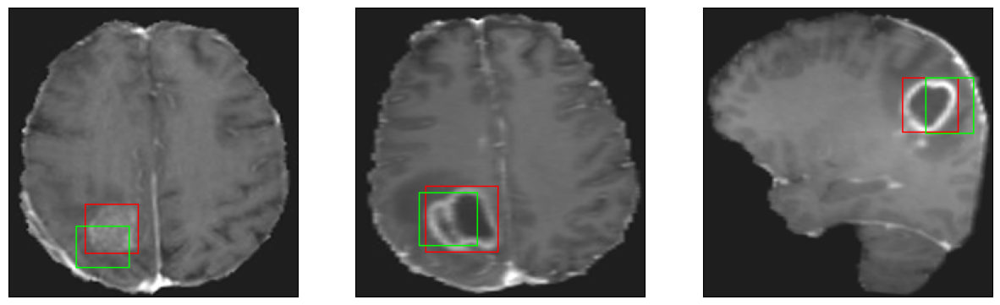

26/26 [==============================] - 21s 848ms/step - loss: 11.1009 - IoU: 0.3571 - val_loss: 10.5378 - val_IoU: 0.4274
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 11.0470 - IoU: 0.3701
Epoch 22: val_IoU did not improve from 0.42740
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


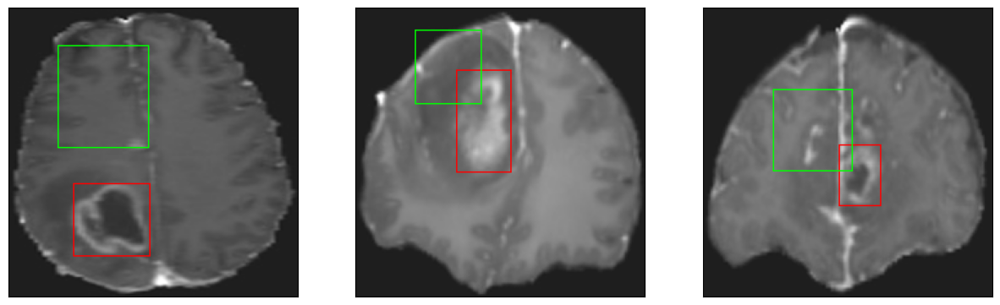

26/26 [==============================] - 7s 287ms/step - loss: 11.0470 - IoU: 0.3701 - val_loss: 21.9852 - val_IoU: 0.1683
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 10.4694 - IoU: 0.3912
Epoch 23: val_IoU did not improve from 0.42740
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


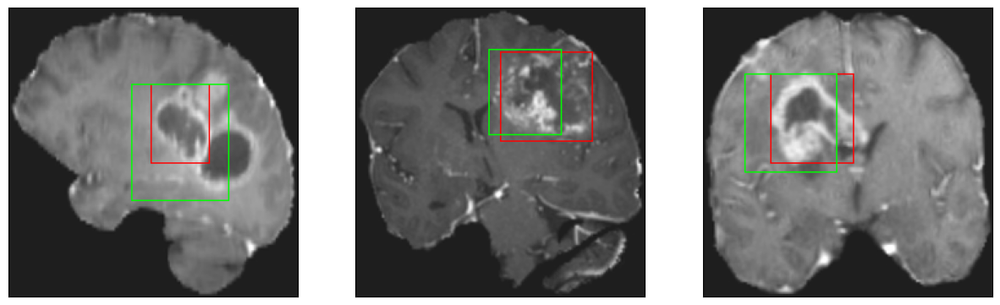

26/26 [==============================] - 7s 269ms/step - loss: 10.4694 - IoU: 0.3912 - val_loss: 12.7878 - val_IoU: 0.3658
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 10.1532 - IoU: 0.3973
Epoch 24: val_IoU did not improve from 0.42740
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


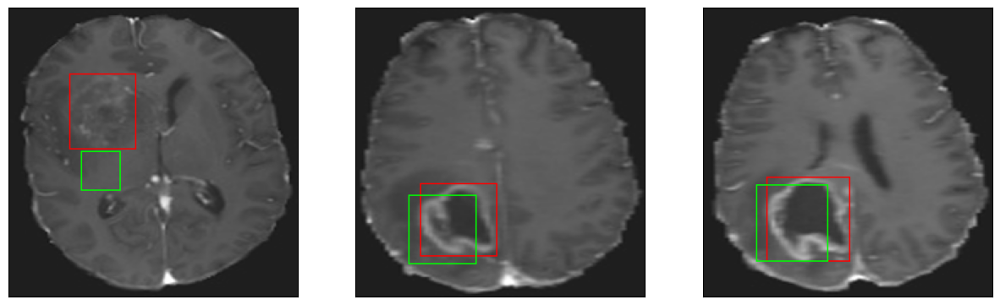

26/26 [==============================] - 7s 272ms/step - loss: 10.1532 - IoU: 0.3973 - val_loss: 11.7702 - val_IoU: 0.3855
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 9.7461 - IoU: 0.4142
Epoch 25: val_IoU did not improve from 0.42740
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


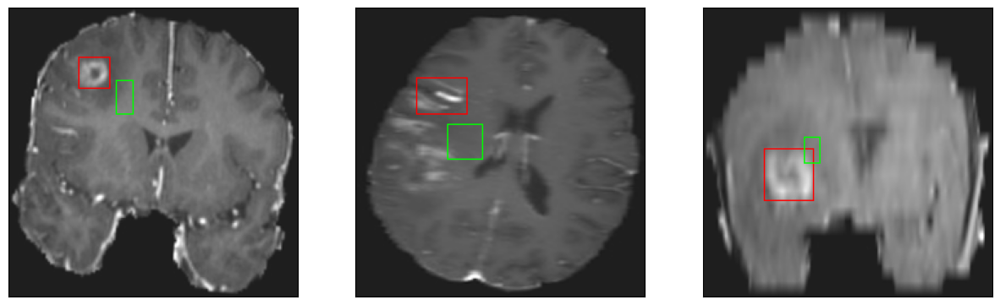

26/26 [==============================] - 8s 292ms/step - loss: 9.7461 - IoU: 0.4142 - val_loss: 17.9490 - val_IoU: 0.2067
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 9.9369 - IoU: 0.4075
Epoch 26: val_IoU did not improve from 0.42740
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


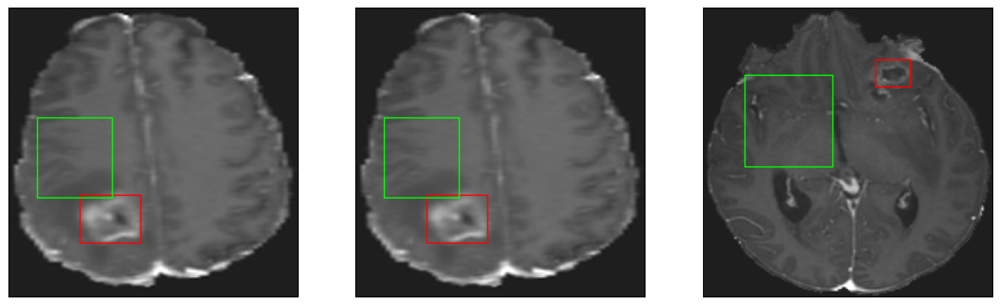

26/26 [==============================] - 7s 282ms/step - loss: 9.9369 - IoU: 0.4075 - val_loss: 17.6527 - val_IoU: 0.2486
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 10.2788 - IoU: 0.3891
Epoch 27: val_IoU did not improve from 0.42740
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


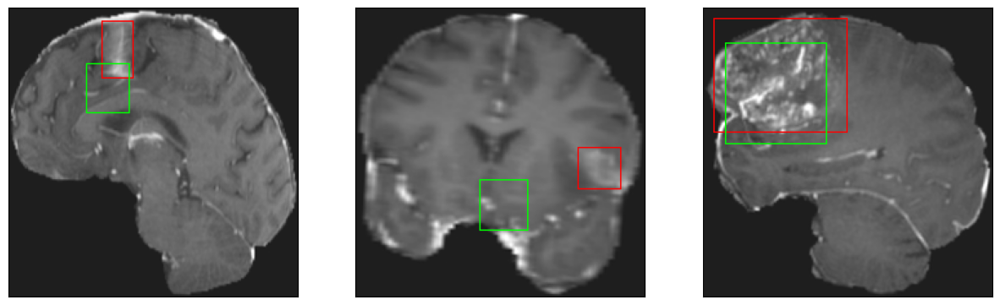

26/26 [==============================] - 7s 277ms/step - loss: 10.2788 - IoU: 0.3891 - val_loss: 11.1965 - val_IoU: 0.4240
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 10.4291 - IoU: 0.3821
Epoch 28: val_IoU did not improve from 0.42740
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


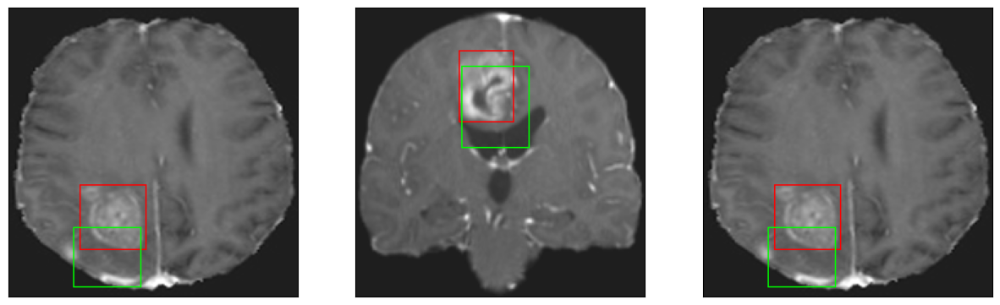

26/26 [==============================] - 7s 278ms/step - loss: 10.4291 - IoU: 0.3821 - val_loss: 10.9393 - val_IoU: 0.4265
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 9.5998 - IoU: 0.4132
Epoch 29: val_IoU improved from 0.42740 to 0.44898, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


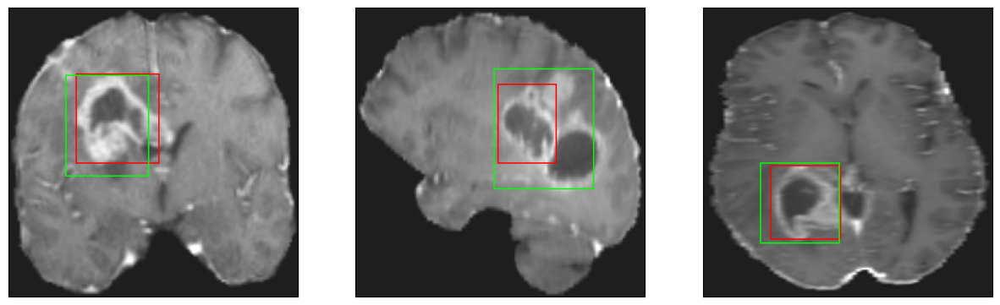

26/26 [==============================] - 30s 1s/step - loss: 9.5998 - IoU: 0.4132 - val_loss: 10.5078 - val_IoU: 0.4490
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 8.9260 - IoU: 0.4395
Epoch 30: val_IoU improved from 0.44898 to 0.45043, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


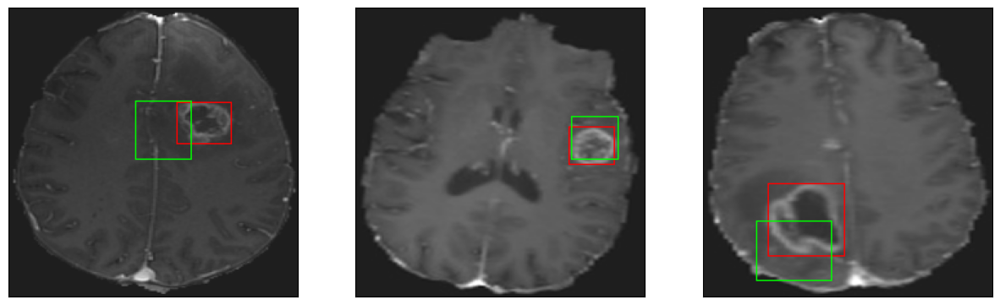

26/26 [==============================] - 14s 550ms/step - loss: 8.9260 - IoU: 0.4395 - val_loss: 10.0162 - val_IoU: 0.4504
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 9.3878 - IoU: 0.4259
Epoch 31: val_IoU did not improve from 0.45043
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


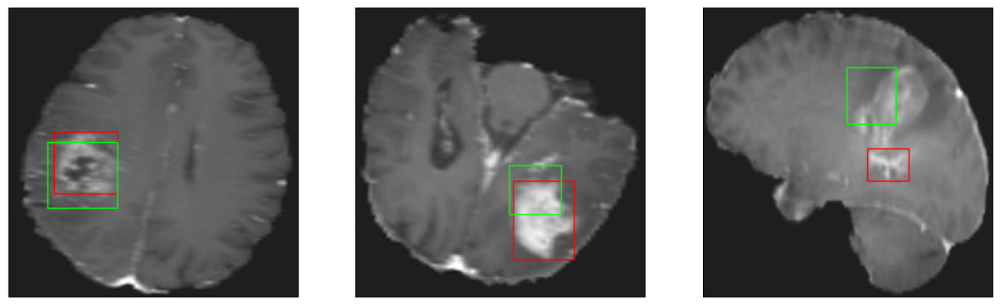

26/26 [==============================] - 8s 298ms/step - loss: 9.3878 - IoU: 0.4259 - val_loss: 11.5375 - val_IoU: 0.3769
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 9.3881 - IoU: 0.4225
Epoch 32: val_IoU did not improve from 0.45043
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


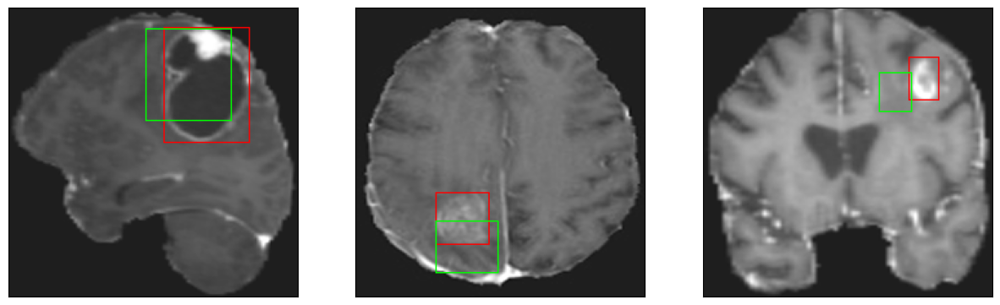

26/26 [==============================] - 7s 283ms/step - loss: 9.3881 - IoU: 0.4225 - val_loss: 9.8746 - val_IoU: 0.4351
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 9.1264 - IoU: 0.4311
Epoch 33: val_IoU did not improve from 0.45043
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


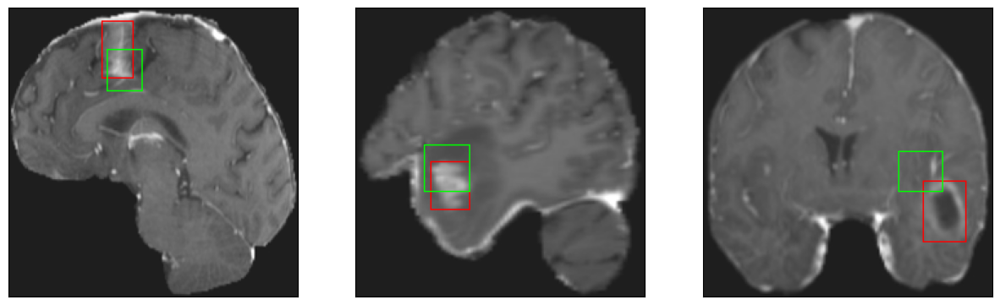

26/26 [==============================] - 8s 299ms/step - loss: 9.1264 - IoU: 0.4311 - val_loss: 11.6363 - val_IoU: 0.3805
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 9.4015 - IoU: 0.4200
Epoch 34: val_IoU did not improve from 0.45043
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


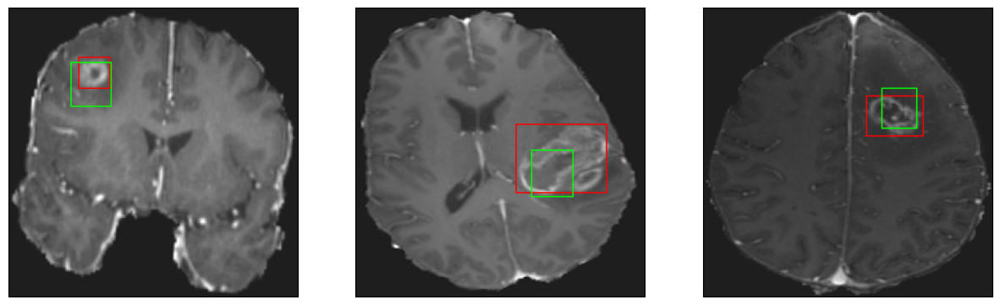

26/26 [==============================] - 7s 283ms/step - loss: 9.4015 - IoU: 0.4200 - val_loss: 12.4934 - val_IoU: 0.3662
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 8.9719 - IoU: 0.4386
Epoch 35: val_IoU did not improve from 0.45043
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


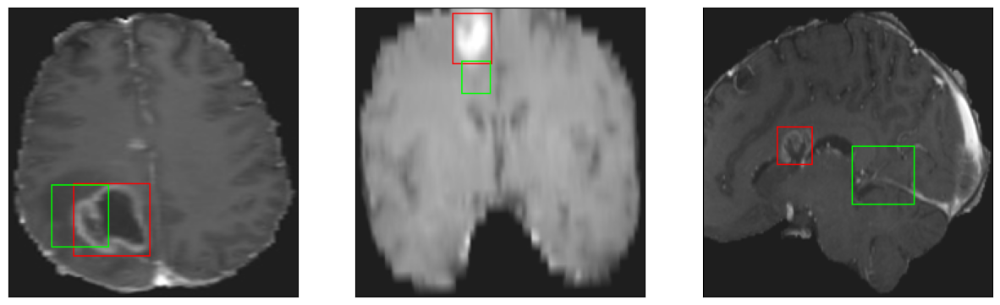

26/26 [==============================] - 8s 293ms/step - loss: 8.9719 - IoU: 0.4386 - val_loss: 11.5276 - val_IoU: 0.4189
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 8.7592 - IoU: 0.4410
Epoch 36: val_IoU did not improve from 0.45043
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


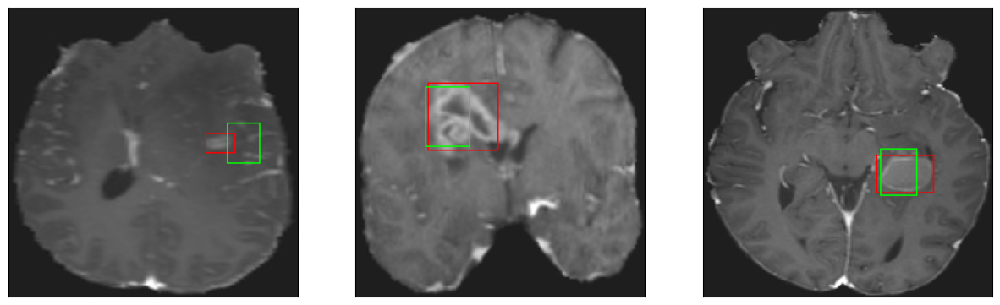

26/26 [==============================] - 7s 288ms/step - loss: 8.7592 - IoU: 0.4410 - val_loss: 10.1563 - val_IoU: 0.4320
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 8.5724 - IoU: 0.4535
Epoch 37: val_IoU did not improve from 0.45043
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


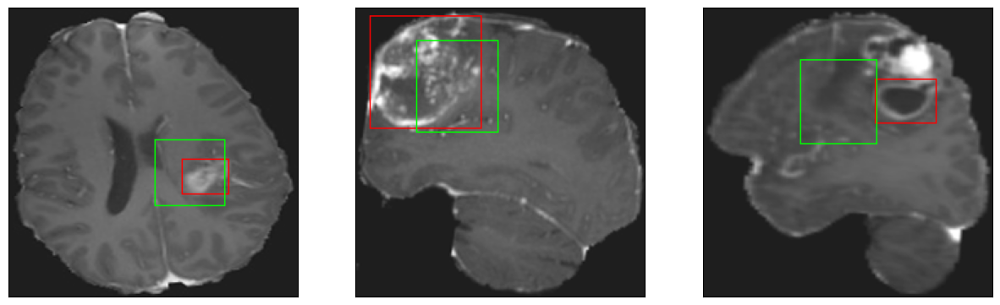

26/26 [==============================] - 7s 276ms/step - loss: 8.5724 - IoU: 0.4535 - val_loss: 15.2397 - val_IoU: 0.3104
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 8.3887 - IoU: 0.4597
Epoch 38: val_IoU did not improve from 0.45043
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


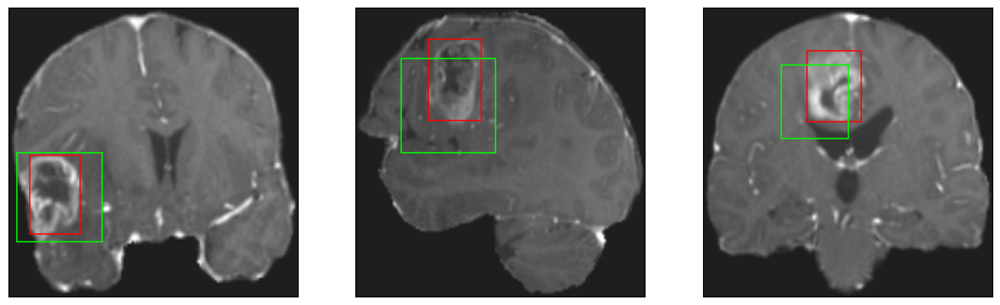

26/26 [==============================] - 8s 298ms/step - loss: 8.3887 - IoU: 0.4597 - val_loss: 13.0946 - val_IoU: 0.3897
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 8.4043 - IoU: 0.4624
Epoch 39: val_IoU improved from 0.45043 to 0.45145, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


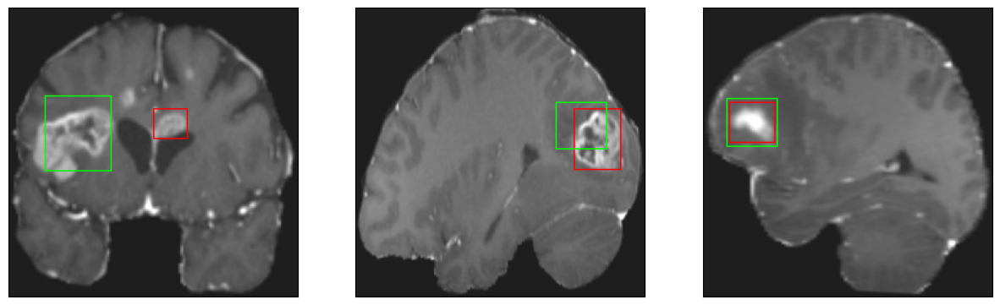

26/26 [==============================] - 36s 1s/step - loss: 8.4043 - IoU: 0.4624 - val_loss: 10.0576 - val_IoU: 0.4515
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 9.0643 - IoU: 0.4256
Epoch 40: val_IoU improved from 0.45145 to 0.46014, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


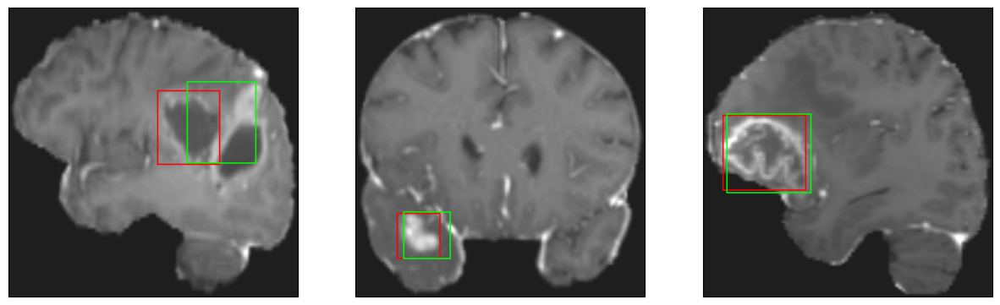

26/26 [==============================] - 17s 662ms/step - loss: 9.0643 - IoU: 0.4256 - val_loss: 10.8630 - val_IoU: 0.4601
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 8.8364 - IoU: 0.4466
Epoch 41: val_IoU did not improve from 0.46014
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 47ms/step
4


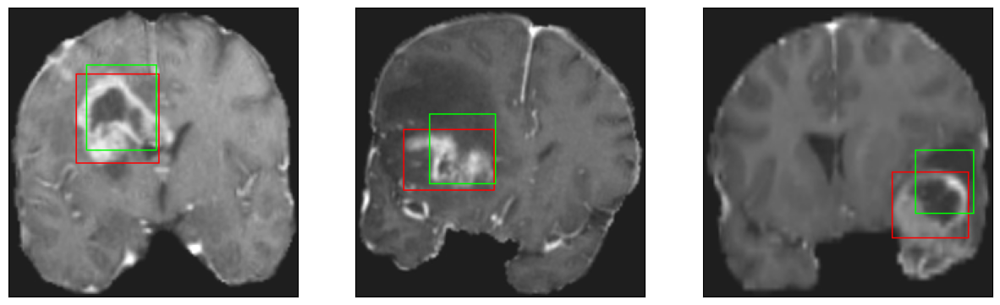

26/26 [==============================] - 8s 295ms/step - loss: 8.8364 - IoU: 0.4466 - val_loss: 11.8785 - val_IoU: 0.3522
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 8.4017 - IoU: 0.4508
Epoch 42: val_IoU did not improve from 0.46014
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


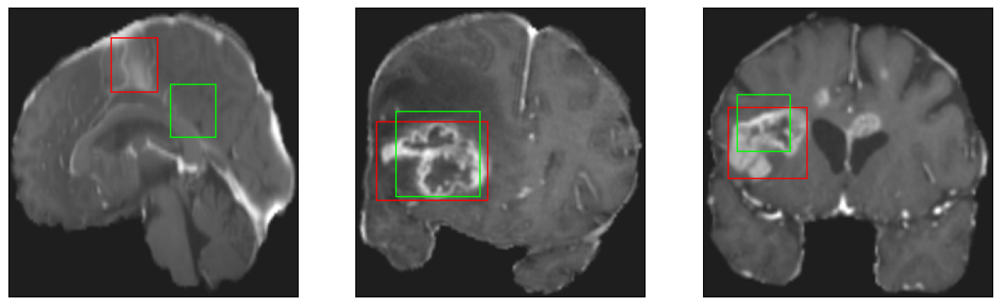

26/26 [==============================] - 8s 293ms/step - loss: 8.4017 - IoU: 0.4508 - val_loss: 9.8484 - val_IoU: 0.4481
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 8.1372 - IoU: 0.4719
Epoch 43: val_IoU did not improve from 0.46014
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


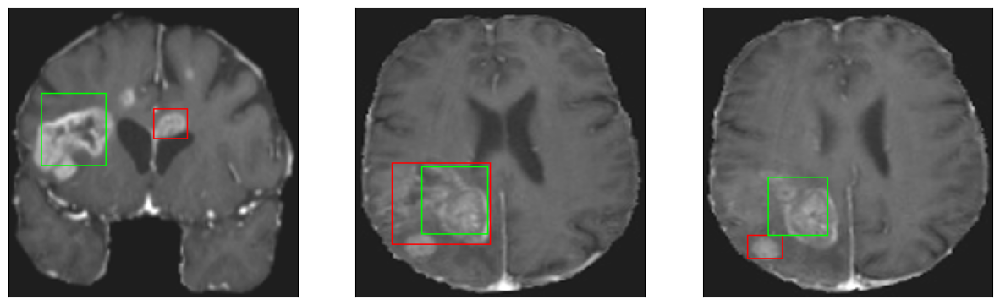

26/26 [==============================] - 8s 296ms/step - loss: 8.1372 - IoU: 0.4719 - val_loss: 11.6606 - val_IoU: 0.3682
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 8.0173 - IoU: 0.4758
Epoch 44: val_IoU did not improve from 0.46014
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


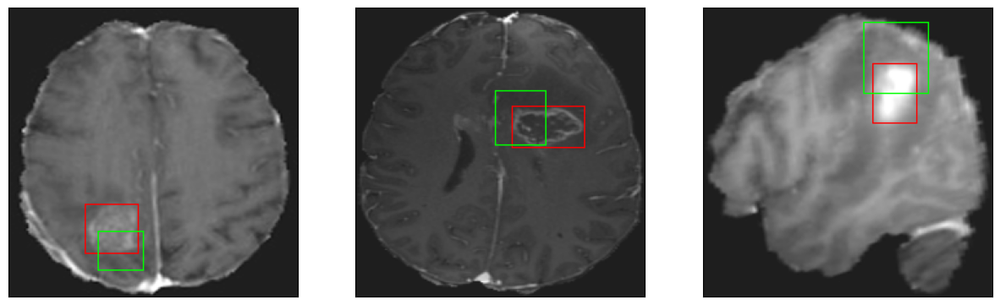

26/26 [==============================] - 8s 307ms/step - loss: 8.0173 - IoU: 0.4758 - val_loss: 10.8960 - val_IoU: 0.3929
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 8.2675 - IoU: 0.4666
Epoch 45: val_IoU did not improve from 0.46014
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


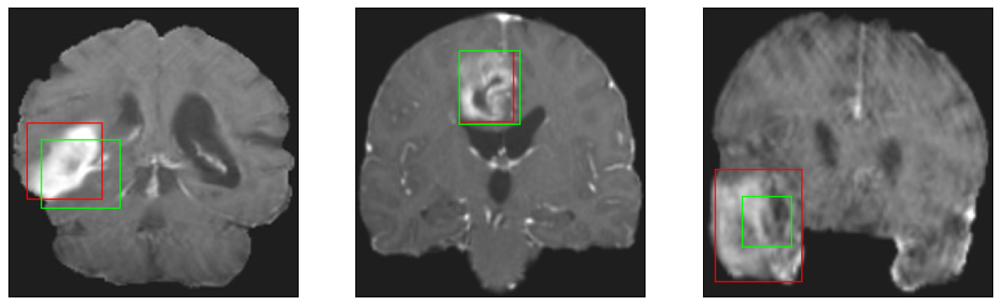

26/26 [==============================] - 8s 296ms/step - loss: 8.2675 - IoU: 0.4666 - val_loss: 10.8361 - val_IoU: 0.4085
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 8.4953 - IoU: 0.4533
Epoch 46: val_IoU did not improve from 0.46014
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


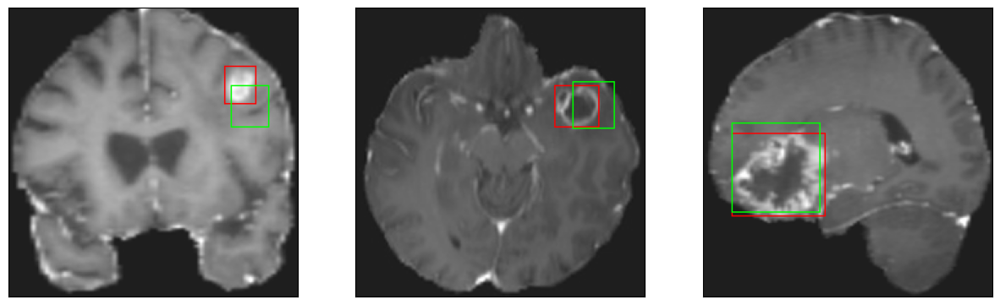

26/26 [==============================] - 7s 289ms/step - loss: 8.4953 - IoU: 0.4533 - val_loss: 10.2124 - val_IoU: 0.4385
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 8.2293 - IoU: 0.4658
Epoch 47: val_IoU did not improve from 0.46014
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


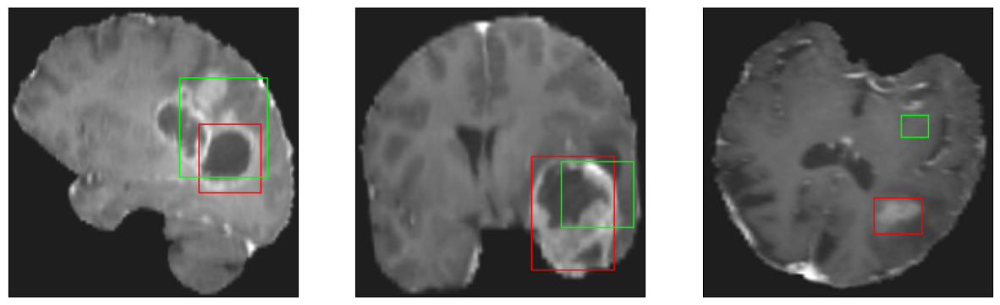

26/26 [==============================] - 7s 269ms/step - loss: 8.2293 - IoU: 0.4658 - val_loss: 12.2498 - val_IoU: 0.3107
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 8.2254 - IoU: 0.4658
Epoch 48: val_IoU did not improve from 0.46014
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


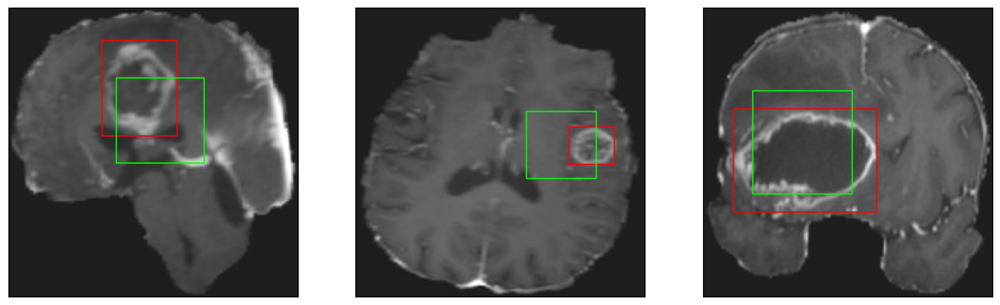

26/26 [==============================] - 8s 291ms/step - loss: 8.2254 - IoU: 0.4658 - val_loss: 14.5793 - val_IoU: 0.3201
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 8.1305 - IoU: 0.4684
Epoch 49: val_IoU improved from 0.46014 to 0.47283, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


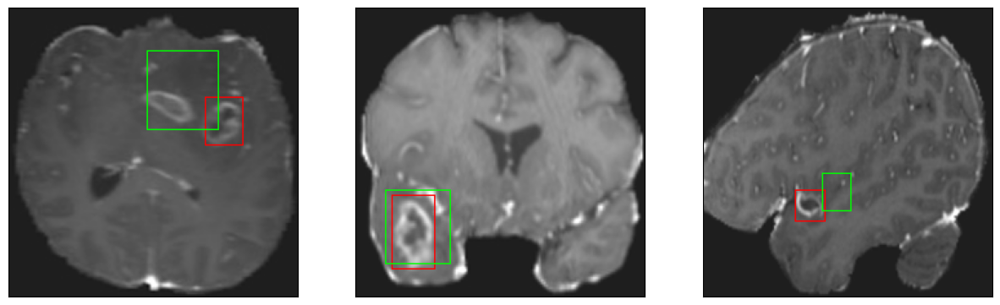

26/26 [==============================] - 28s 1s/step - loss: 8.1305 - IoU: 0.4684 - val_loss: 10.2834 - val_IoU: 0.4728
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 8.2382 - IoU: 0.4606
Epoch 50: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


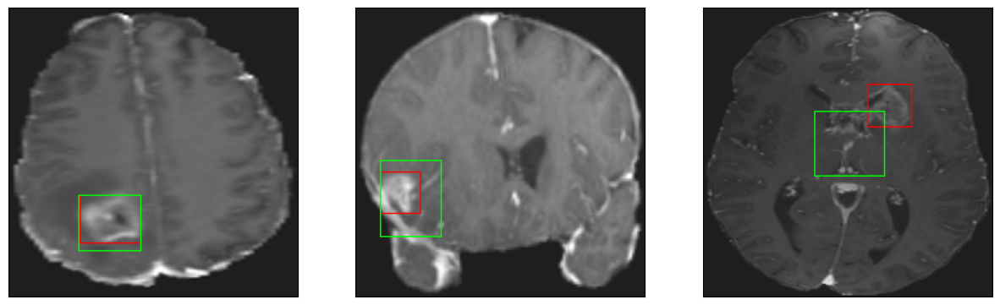

26/26 [==============================] - 8s 309ms/step - loss: 8.2382 - IoU: 0.4606 - val_loss: 10.1471 - val_IoU: 0.4295
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 7.9025 - IoU: 0.4691
Epoch 51: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


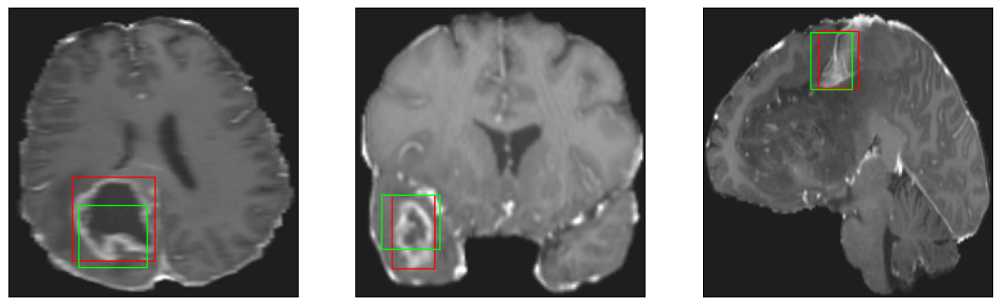

26/26 [==============================] - 7s 280ms/step - loss: 7.9025 - IoU: 0.4691 - val_loss: 10.3110 - val_IoU: 0.4238
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 8.0568 - IoU: 0.4669
Epoch 52: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4


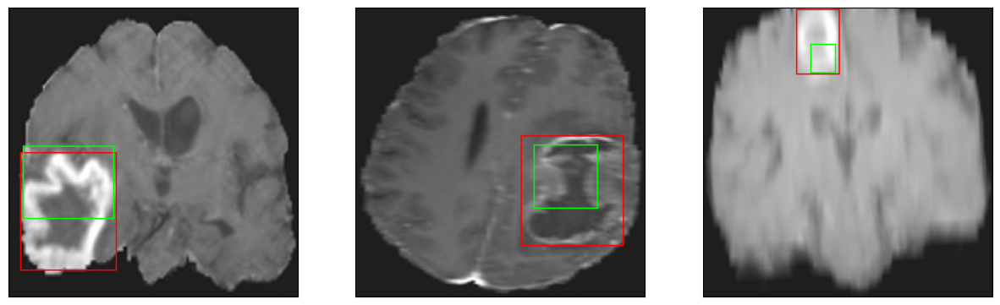

26/26 [==============================] - 8s 320ms/step - loss: 8.0568 - IoU: 0.4669 - val_loss: 10.7528 - val_IoU: 0.4035
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 7.4537 - IoU: 0.5051
Epoch 53: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


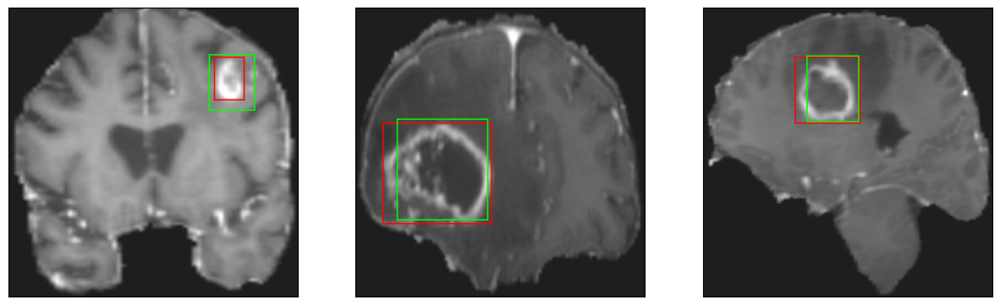

26/26 [==============================] - 7s 274ms/step - loss: 7.4537 - IoU: 0.5051 - val_loss: 10.9319 - val_IoU: 0.4139
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 7.7479 - IoU: 0.4887
Epoch 54: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


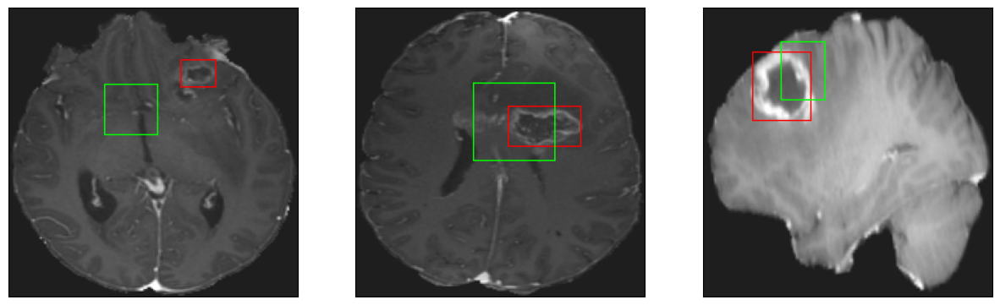

26/26 [==============================] - 7s 287ms/step - loss: 7.7479 - IoU: 0.4887 - val_loss: 10.5487 - val_IoU: 0.4305
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 7.9798 - IoU: 0.4766
Epoch 55: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


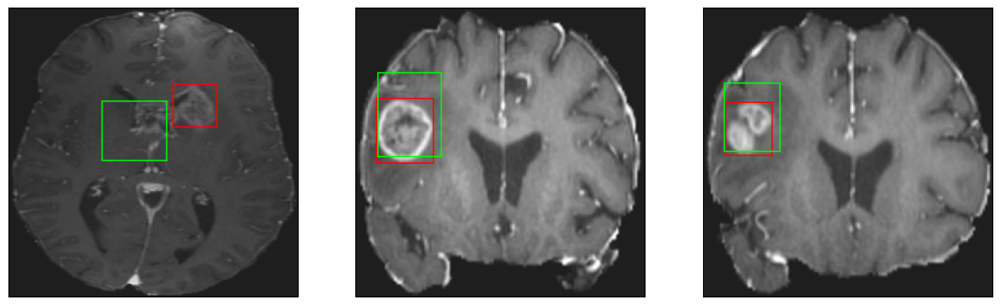

26/26 [==============================] - 7s 271ms/step - loss: 7.9798 - IoU: 0.4766 - val_loss: 12.2606 - val_IoU: 0.3536
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 7.3460 - IoU: 0.4950
Epoch 56: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


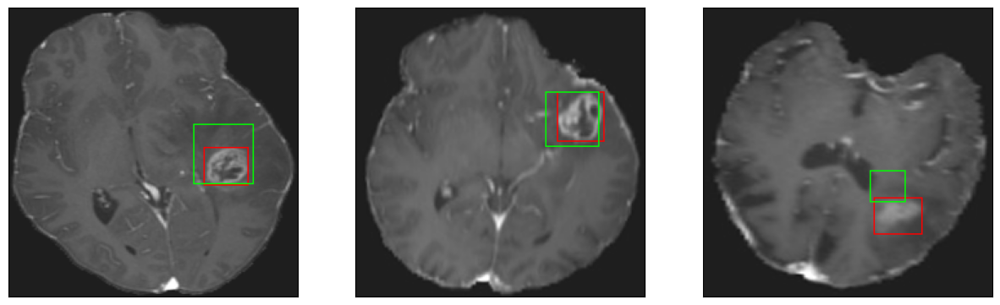

26/26 [==============================] - 8s 316ms/step - loss: 7.3460 - IoU: 0.4950 - val_loss: 10.6982 - val_IoU: 0.4422
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 7.4999 - IoU: 0.4970
Epoch 57: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


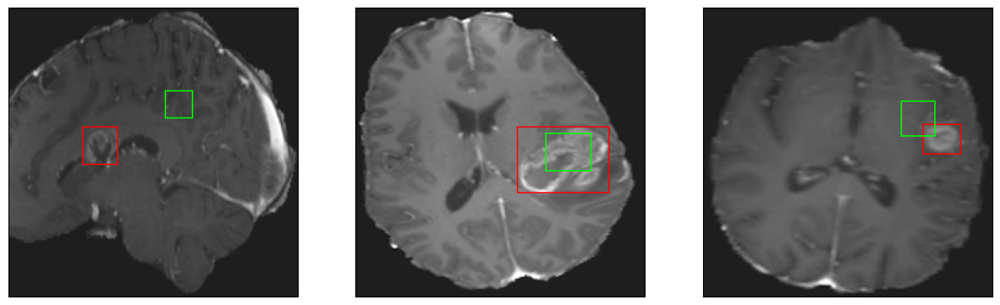

26/26 [==============================] - 7s 288ms/step - loss: 7.4999 - IoU: 0.4970 - val_loss: 11.3114 - val_IoU: 0.3948
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 7.6328 - IoU: 0.4844
Epoch 58: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


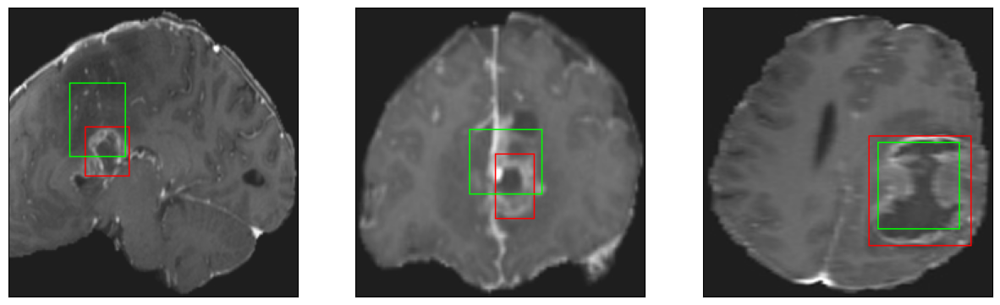

26/26 [==============================] - 7s 271ms/step - loss: 7.6328 - IoU: 0.4844 - val_loss: 10.3465 - val_IoU: 0.4577
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 7.6210 - IoU: 0.4990
Epoch 59: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


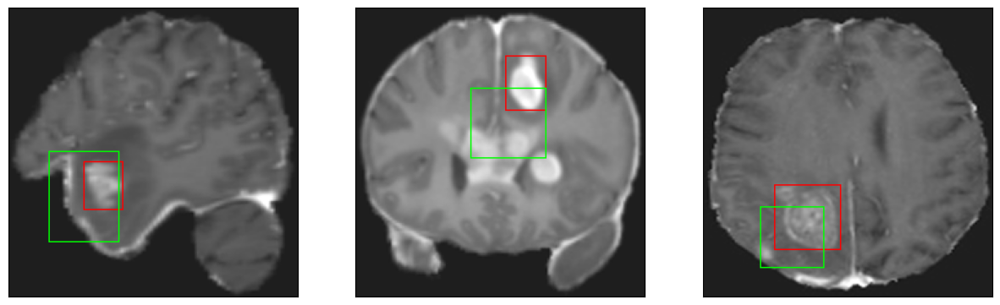

26/26 [==============================] - 8s 307ms/step - loss: 7.6210 - IoU: 0.4990 - val_loss: 10.1997 - val_IoU: 0.4537
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 7.7920 - IoU: 0.4775
Epoch 60: val_IoU did not improve from 0.47283
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


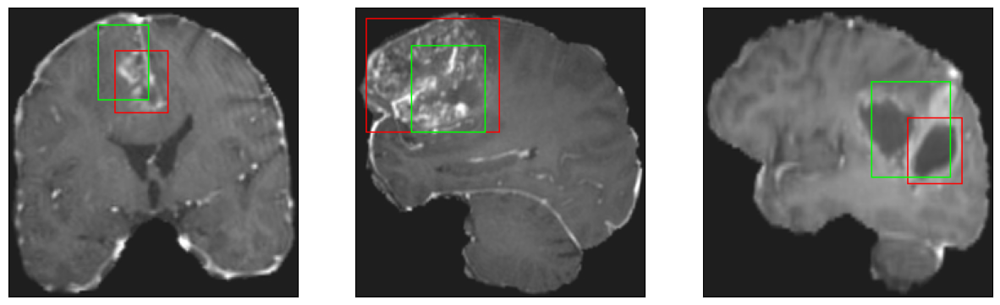

26/26 [==============================] - 7s 278ms/step - loss: 7.7920 - IoU: 0.4775 - val_loss: 15.3529 - val_IoU: 0.3138
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 7.7384 - IoU: 0.4849
Epoch 61: val_IoU improved from 0.47283 to 0.50645, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


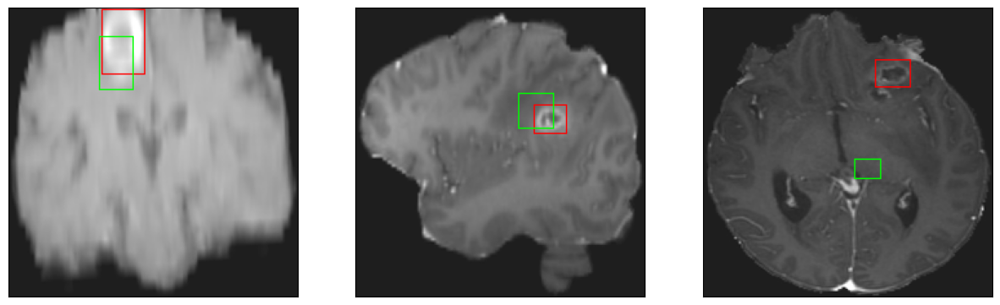

26/26 [==============================] - 28s 1s/step - loss: 7.7384 - IoU: 0.4849 - val_loss: 9.2346 - val_IoU: 0.5064
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 7.6493 - IoU: 0.4896
Epoch 62: val_IoU improved from 0.50645 to 0.51387, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


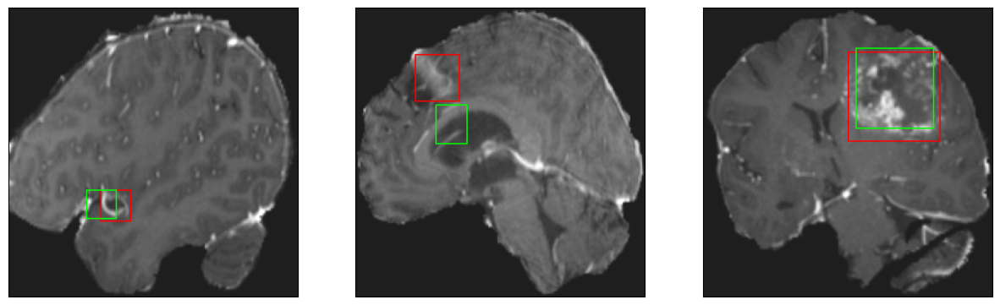

26/26 [==============================] - 14s 560ms/step - loss: 7.6493 - IoU: 0.4896 - val_loss: 8.7713 - val_IoU: 0.5139
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 7.6083 - IoU: 0.4934
Epoch 63: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


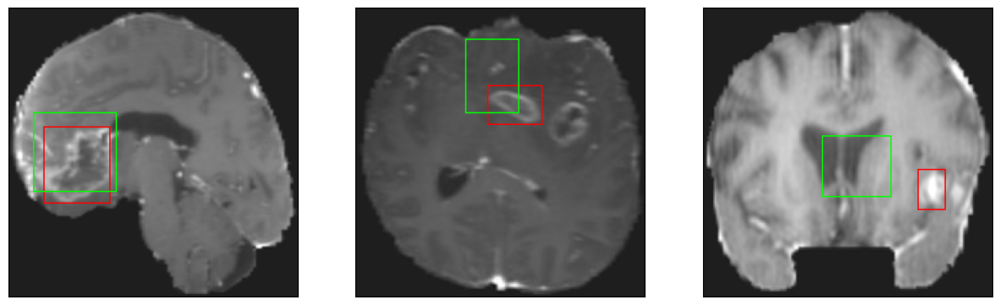

26/26 [==============================] - 8s 290ms/step - loss: 7.6083 - IoU: 0.4934 - val_loss: 9.8658 - val_IoU: 0.4692
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 7.2688 - IoU: 0.5040
Epoch 64: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 47ms/step
4


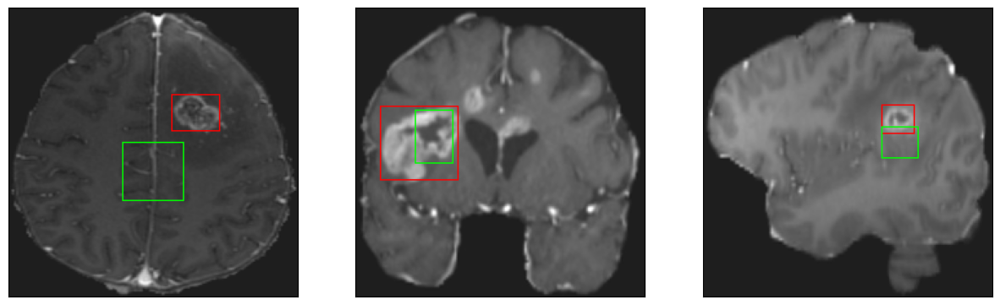

26/26 [==============================] - 8s 316ms/step - loss: 7.2688 - IoU: 0.5040 - val_loss: 10.0300 - val_IoU: 0.4519
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 7.4491 - IoU: 0.4912
Epoch 65: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


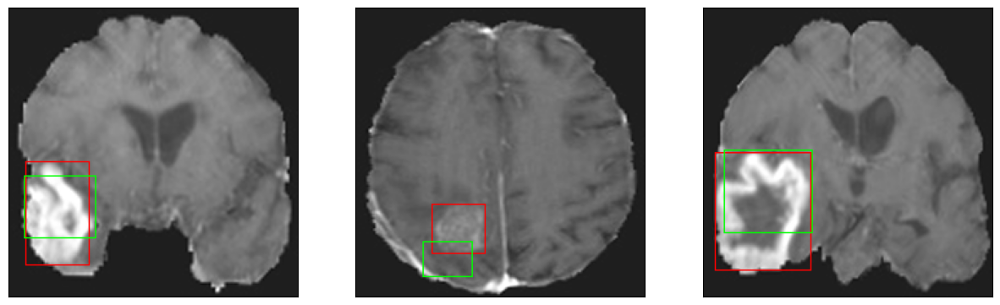

26/26 [==============================] - 8s 290ms/step - loss: 7.4491 - IoU: 0.4912 - val_loss: 9.3855 - val_IoU: 0.4921
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 7.3405 - IoU: 0.5075
Epoch 66: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


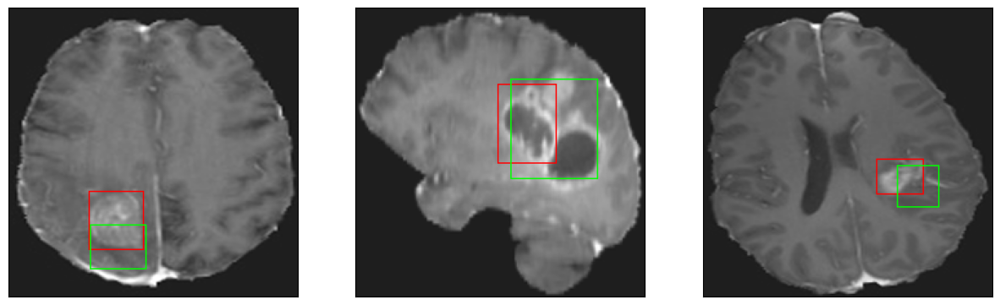

26/26 [==============================] - 8s 312ms/step - loss: 7.3405 - IoU: 0.5075 - val_loss: 9.1682 - val_IoU: 0.4761
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 7.1710 - IoU: 0.5031
Epoch 67: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


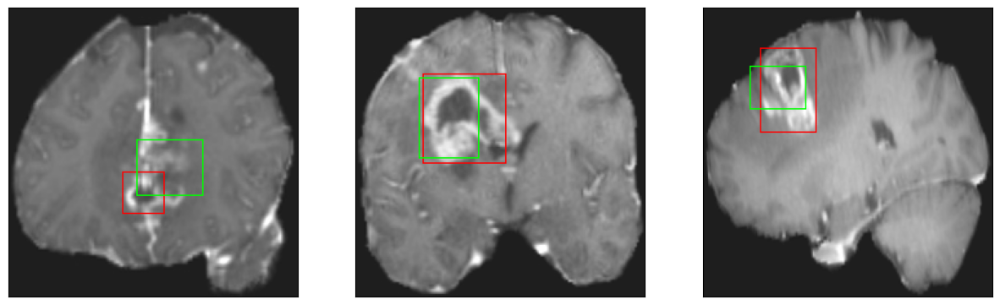

26/26 [==============================] - 8s 302ms/step - loss: 7.1710 - IoU: 0.5031 - val_loss: 9.9998 - val_IoU: 0.4570
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 7.4414 - IoU: 0.4939
Epoch 68: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


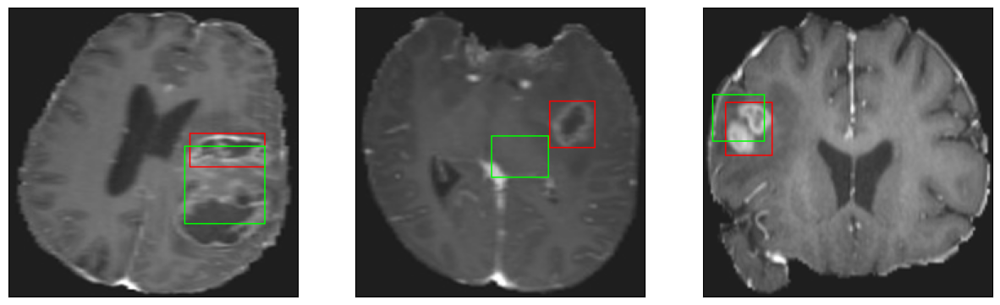

26/26 [==============================] - 8s 311ms/step - loss: 7.4414 - IoU: 0.4939 - val_loss: 9.1327 - val_IoU: 0.5035
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 7.0833 - IoU: 0.5137
Epoch 69: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


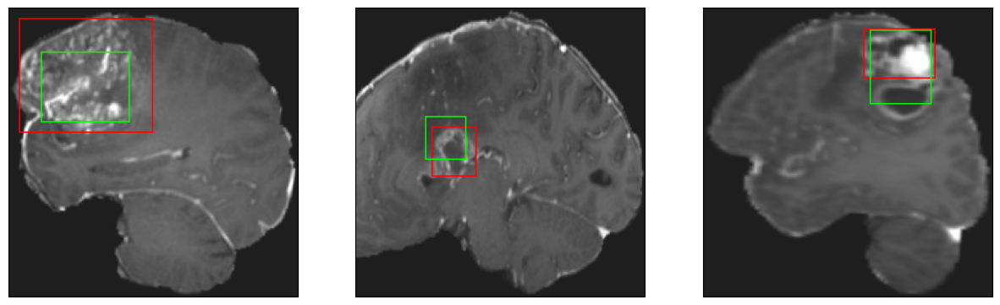

26/26 [==============================] - 8s 296ms/step - loss: 7.0833 - IoU: 0.5137 - val_loss: 9.6901 - val_IoU: 0.4559
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 6.8597 - IoU: 0.5199
Epoch 70: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


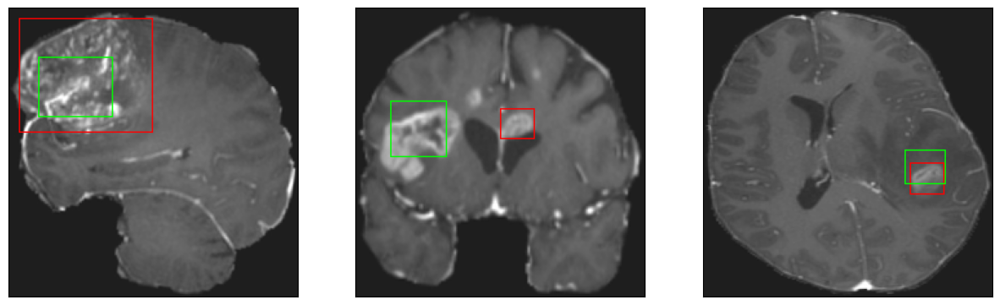

26/26 [==============================] - 7s 280ms/step - loss: 6.8597 - IoU: 0.5199 - val_loss: 10.5740 - val_IoU: 0.4158
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 7.1453 - IoU: 0.4993
Epoch 71: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


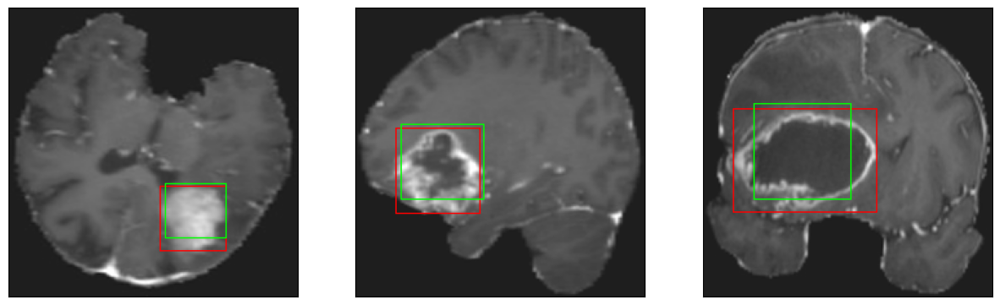

26/26 [==============================] - 8s 298ms/step - loss: 7.1453 - IoU: 0.4993 - val_loss: 9.0235 - val_IoU: 0.5025
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 7.6089 - IoU: 0.4964
Epoch 72: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


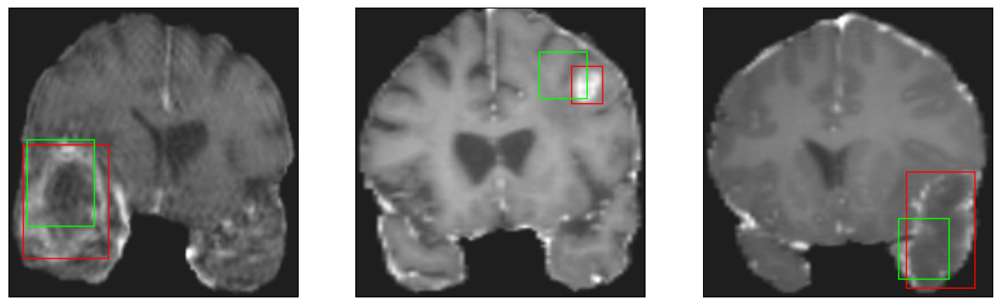

26/26 [==============================] - 8s 301ms/step - loss: 7.6089 - IoU: 0.4964 - val_loss: 10.5395 - val_IoU: 0.3962
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 7.3888 - IoU: 0.4890
Epoch 73: val_IoU did not improve from 0.51387
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


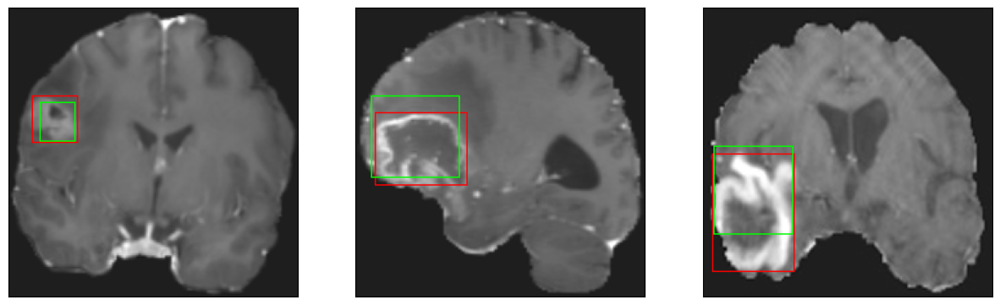

26/26 [==============================] - 8s 308ms/step - loss: 7.3888 - IoU: 0.4890 - val_loss: 9.0248 - val_IoU: 0.4861
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 7.3087 - IoU: 0.5069
Epoch 74: val_IoU improved from 0.51387 to 0.52722, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


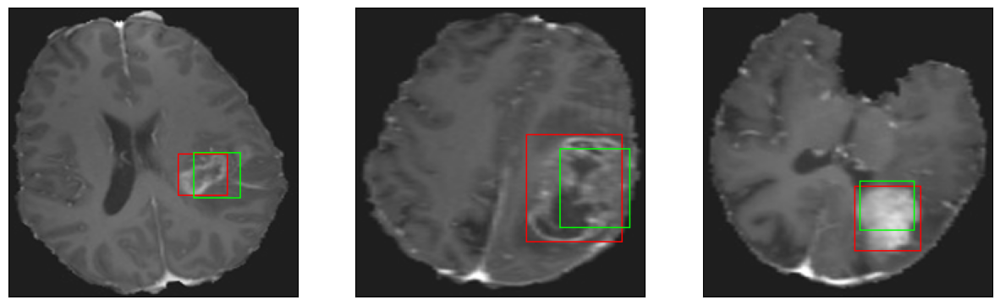

26/26 [==============================] - 35s 1s/step - loss: 7.3087 - IoU: 0.5069 - val_loss: 8.4429 - val_IoU: 0.5272
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 6.9131 - IoU: 0.5155
Epoch 75: val_IoU did not improve from 0.52722
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


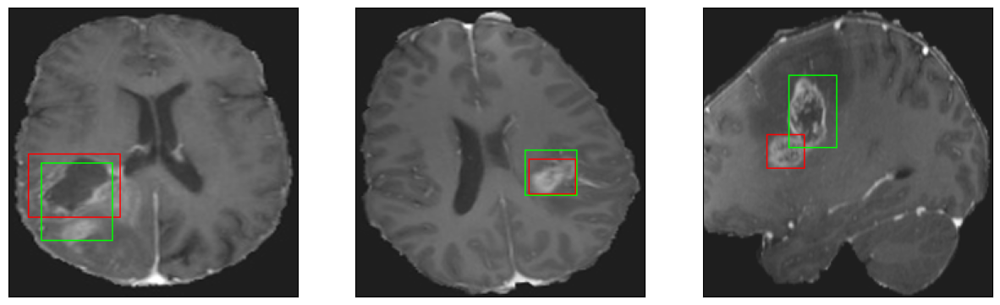

26/26 [==============================] - 8s 301ms/step - loss: 6.9131 - IoU: 0.5155 - val_loss: 10.6174 - val_IoU: 0.4394
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 7.0942 - IoU: 0.5025
Epoch 76: val_IoU did not improve from 0.52722
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


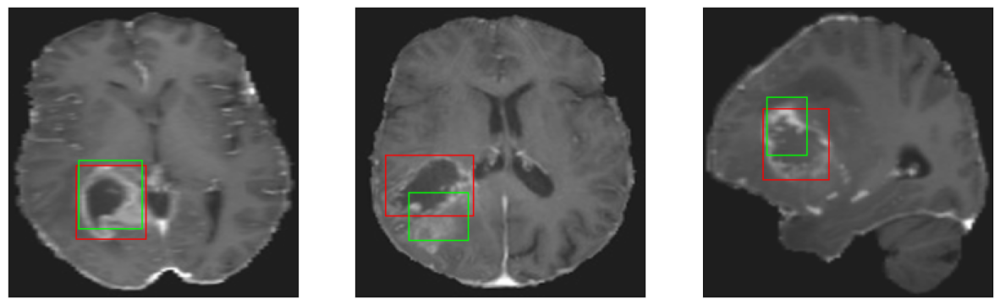

26/26 [==============================] - 7s 279ms/step - loss: 7.0942 - IoU: 0.5025 - val_loss: 9.2148 - val_IoU: 0.4958
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 6.8606 - IoU: 0.5261
Epoch 77: val_IoU did not improve from 0.52722
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


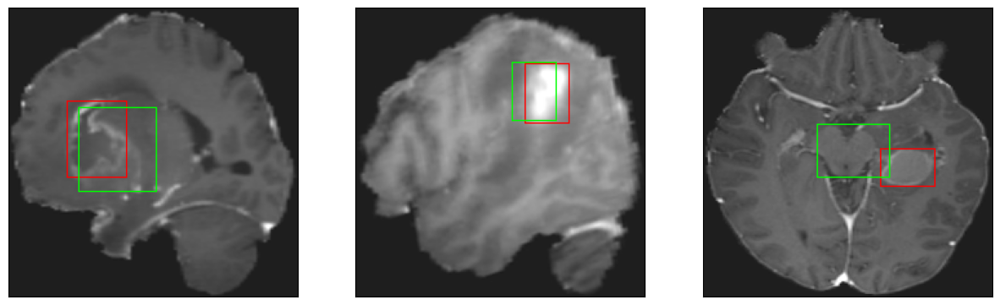

26/26 [==============================] - 8s 315ms/step - loss: 6.8606 - IoU: 0.5261 - val_loss: 14.0038 - val_IoU: 0.3572
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 6.5528 - IoU: 0.5384
Epoch 78: val_IoU did not improve from 0.52722
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


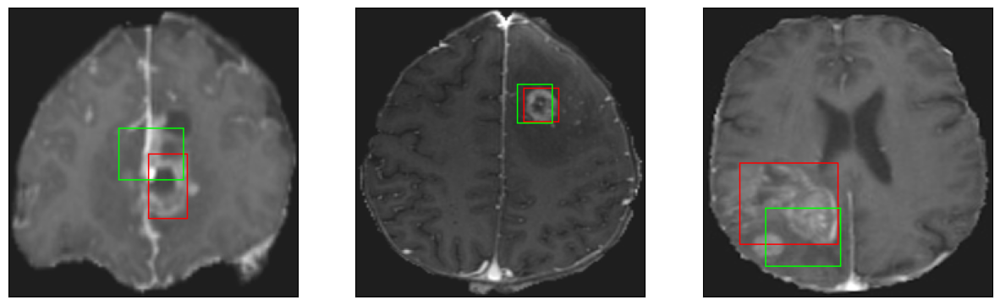

26/26 [==============================] - 8s 299ms/step - loss: 6.5528 - IoU: 0.5384 - val_loss: 10.6460 - val_IoU: 0.4146
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 6.6372 - IoU: 0.5351
Epoch 79: val_IoU did not improve from 0.52722
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


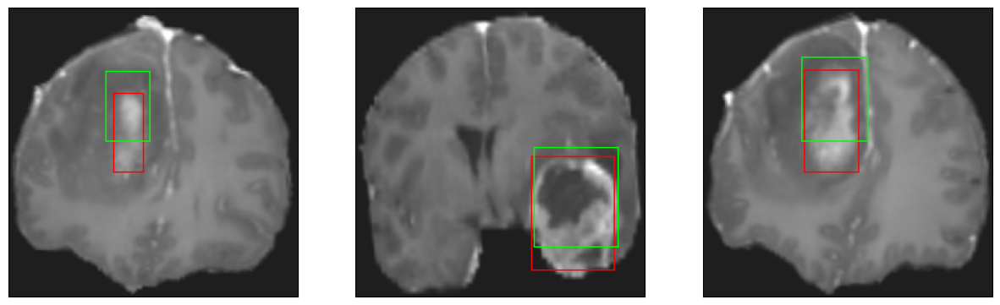

26/26 [==============================] - 8s 320ms/step - loss: 6.6372 - IoU: 0.5351 - val_loss: 11.3336 - val_IoU: 0.4327
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 7.1226 - IoU: 0.5100
Epoch 80: val_IoU did not improve from 0.52722
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


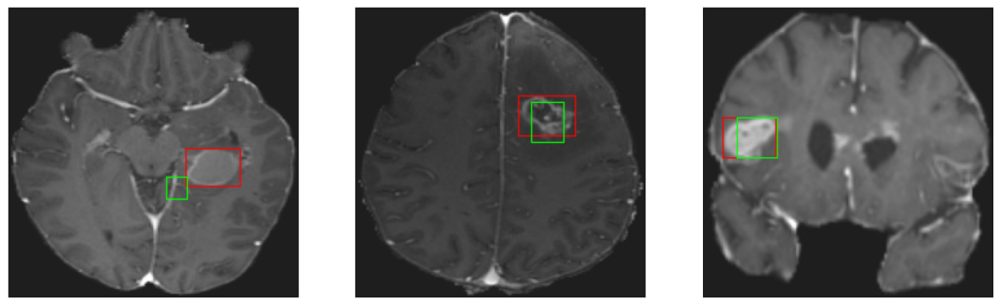

26/26 [==============================] - 7s 268ms/step - loss: 7.1226 - IoU: 0.5100 - val_loss: 9.3022 - val_IoU: 0.4879
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 6.9781 - IoU: 0.5159
Epoch 81: val_IoU did not improve from 0.52722
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


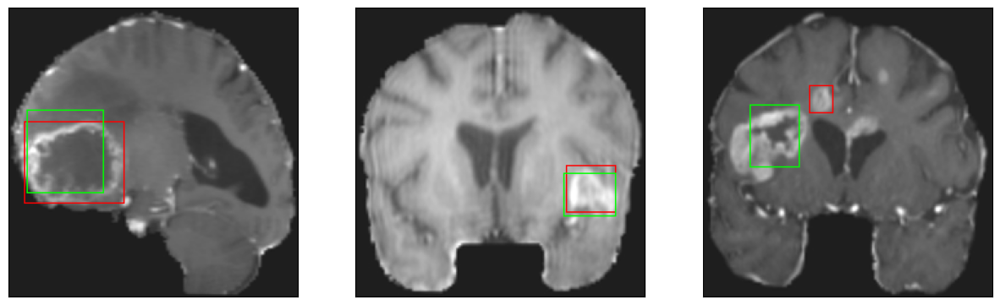

26/26 [==============================] - 8s 308ms/step - loss: 6.9781 - IoU: 0.5159 - val_loss: 10.9111 - val_IoU: 0.4403
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 6.9405 - IoU: 0.5131
Epoch 82: val_IoU did not improve from 0.52722
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


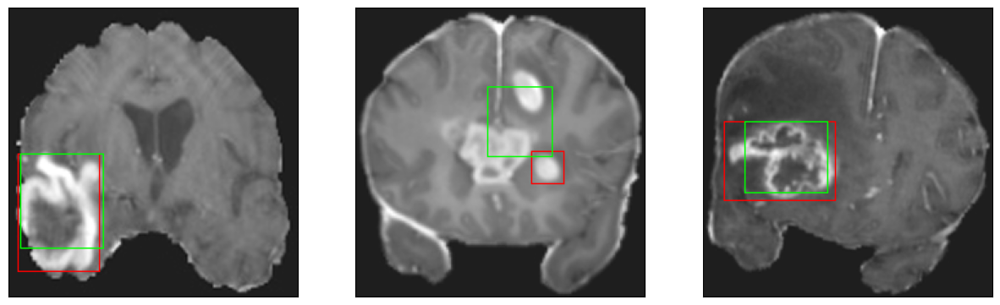

26/26 [==============================] - 8s 310ms/step - loss: 6.9405 - IoU: 0.5131 - val_loss: 9.0014 - val_IoU: 0.5106
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 6.7183 - IoU: 0.5271
Epoch 83: val_IoU improved from 0.52722 to 0.52795, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


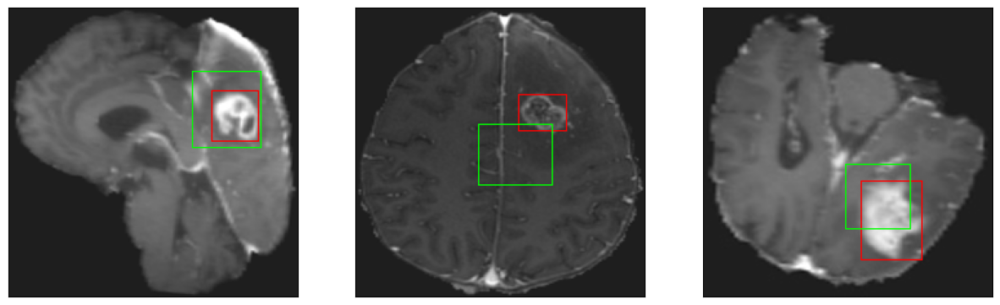

26/26 [==============================] - 32s 1s/step - loss: 6.7183 - IoU: 0.5271 - val_loss: 8.7850 - val_IoU: 0.5280
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 6.4746 - IoU: 0.5431
Epoch 84: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


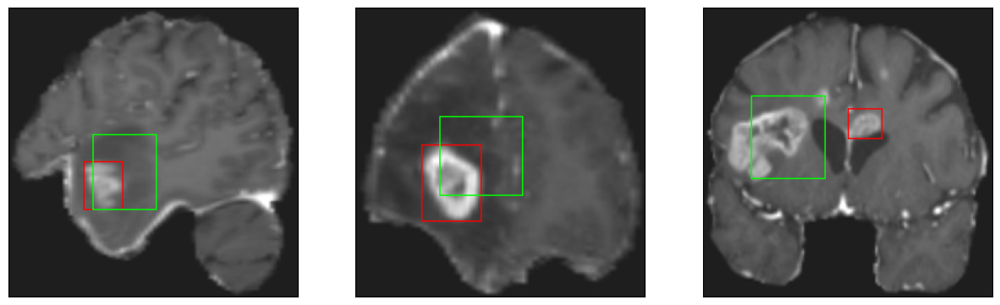

26/26 [==============================] - 7s 290ms/step - loss: 6.4746 - IoU: 0.5431 - val_loss: 12.2674 - val_IoU: 0.3860
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 6.8131 - IoU: 0.5198
Epoch 85: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


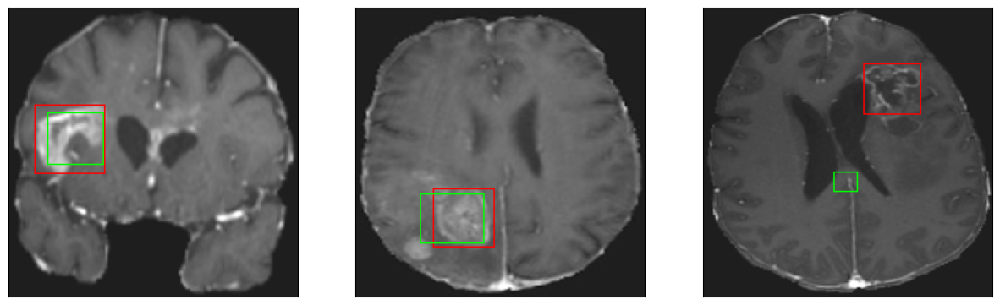

26/26 [==============================] - 7s 282ms/step - loss: 6.8131 - IoU: 0.5198 - val_loss: 9.9644 - val_IoU: 0.4415
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 6.9374 - IoU: 0.5190
Epoch 86: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


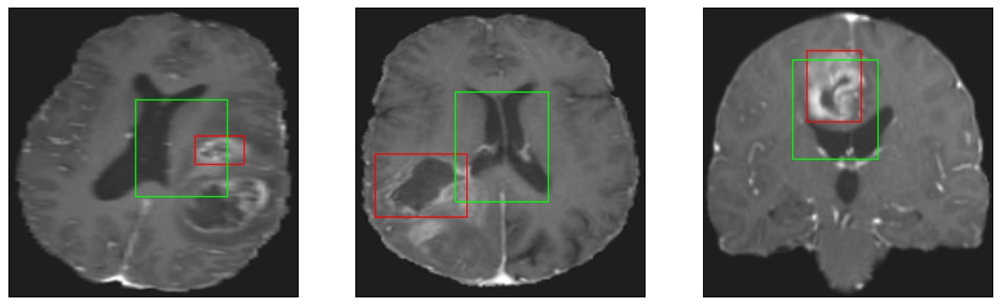

26/26 [==============================] - 8s 310ms/step - loss: 6.9374 - IoU: 0.5190 - val_loss: 25.7792 - val_IoU: 0.1525
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 6.4593 - IoU: 0.5332
Epoch 87: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


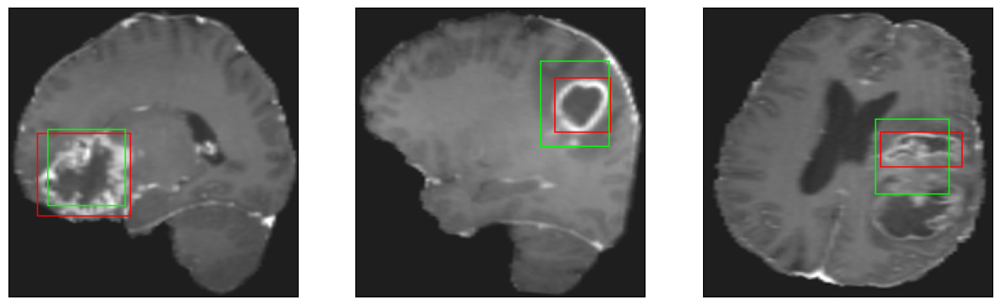

26/26 [==============================] - 8s 293ms/step - loss: 6.4593 - IoU: 0.5332 - val_loss: 10.7835 - val_IoU: 0.4147
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 6.4322 - IoU: 0.5407
Epoch 88: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


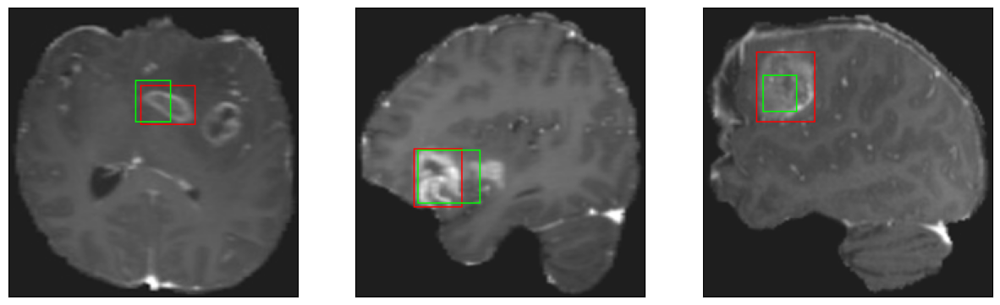

26/26 [==============================] - 8s 295ms/step - loss: 6.4322 - IoU: 0.5407 - val_loss: 10.7256 - val_IoU: 0.4333
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 6.3188 - IoU: 0.5495
Epoch 89: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


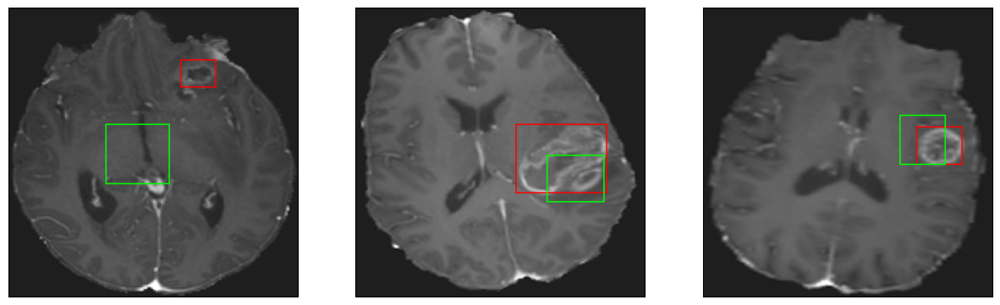

26/26 [==============================] - 8s 308ms/step - loss: 6.3188 - IoU: 0.5495 - val_loss: 11.5442 - val_IoU: 0.4125
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 6.4103 - IoU: 0.5456
Epoch 90: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


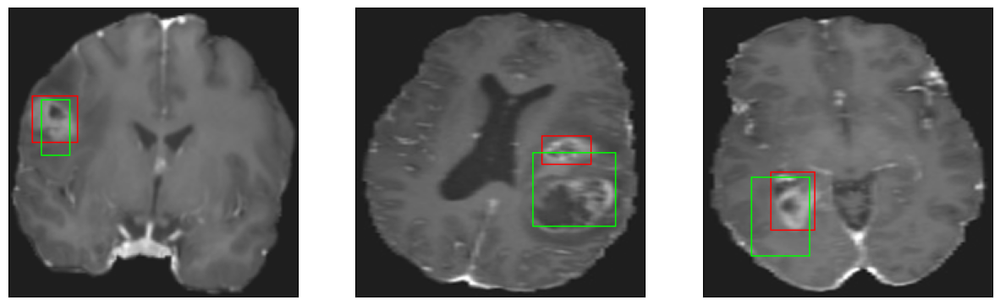

26/26 [==============================] - 8s 304ms/step - loss: 6.4103 - IoU: 0.5456 - val_loss: 10.2777 - val_IoU: 0.4717
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 6.4661 - IoU: 0.5427
Epoch 91: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


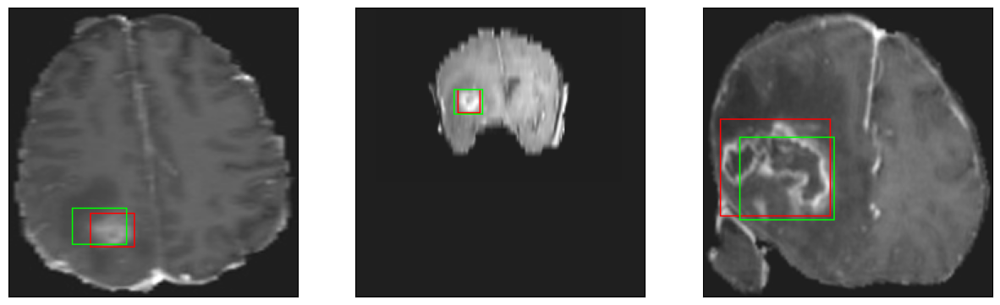

26/26 [==============================] - 8s 311ms/step - loss: 6.4661 - IoU: 0.5427 - val_loss: 8.8041 - val_IoU: 0.5070
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 6.3489 - IoU: 0.5401
Epoch 92: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


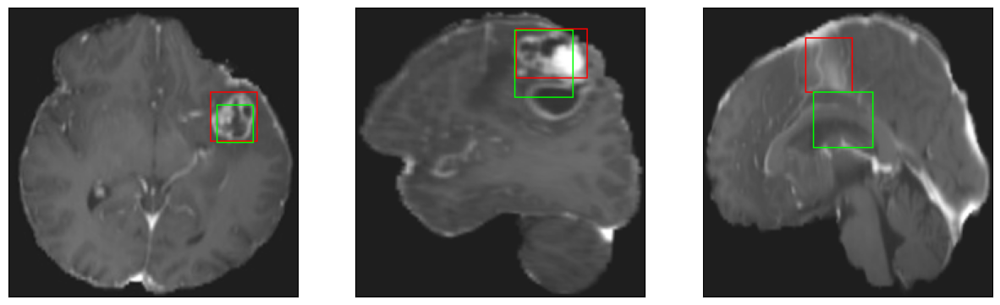

26/26 [==============================] - 8s 321ms/step - loss: 6.3489 - IoU: 0.5401 - val_loss: 9.0716 - val_IoU: 0.5025
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 6.7637 - IoU: 0.5203
Epoch 93: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


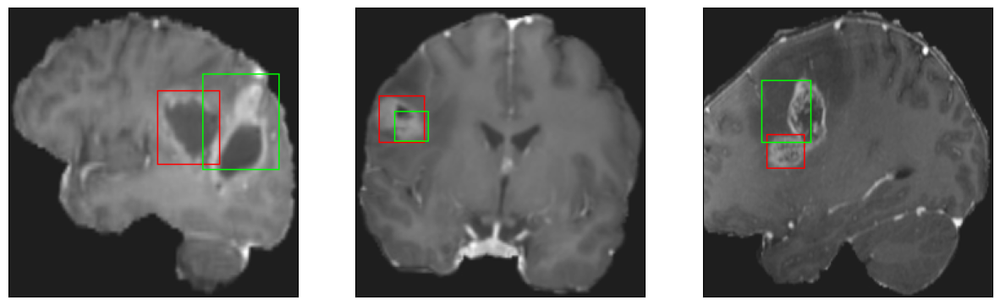

26/26 [==============================] - 8s 310ms/step - loss: 6.7637 - IoU: 0.5203 - val_loss: 9.5634 - val_IoU: 0.4735
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 6.4693 - IoU: 0.5449
Epoch 94: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


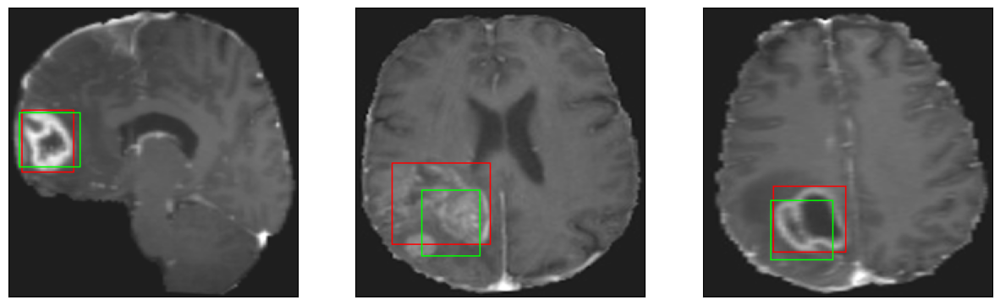

26/26 [==============================] - 8s 305ms/step - loss: 6.4693 - IoU: 0.5449 - val_loss: 9.2953 - val_IoU: 0.4954
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 6.4794 - IoU: 0.5367
Epoch 95: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


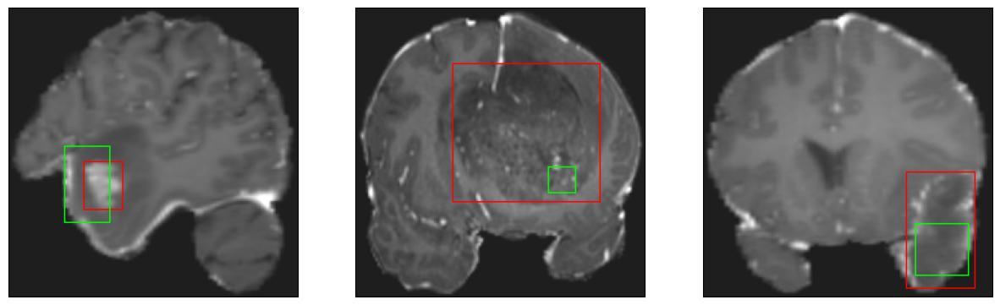

26/26 [==============================] - 7s 288ms/step - loss: 6.4794 - IoU: 0.5367 - val_loss: 8.8608 - val_IoU: 0.4992
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 6.2770 - IoU: 0.5511
Epoch 96: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


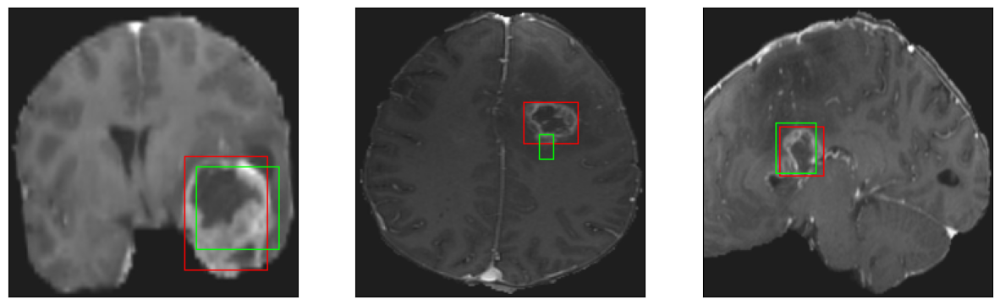

26/26 [==============================] - 8s 311ms/step - loss: 6.2770 - IoU: 0.5511 - val_loss: 9.2843 - val_IoU: 0.4968
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 6.2599 - IoU: 0.5514
Epoch 97: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


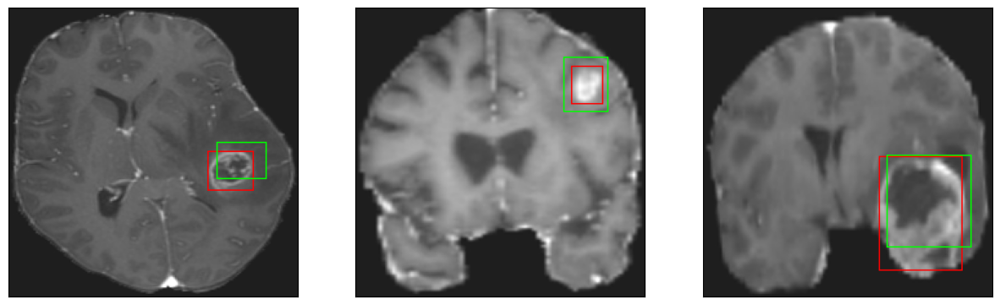

26/26 [==============================] - 8s 300ms/step - loss: 6.2599 - IoU: 0.5514 - val_loss: 9.2503 - val_IoU: 0.4821
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 6.5243 - IoU: 0.5335
Epoch 98: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


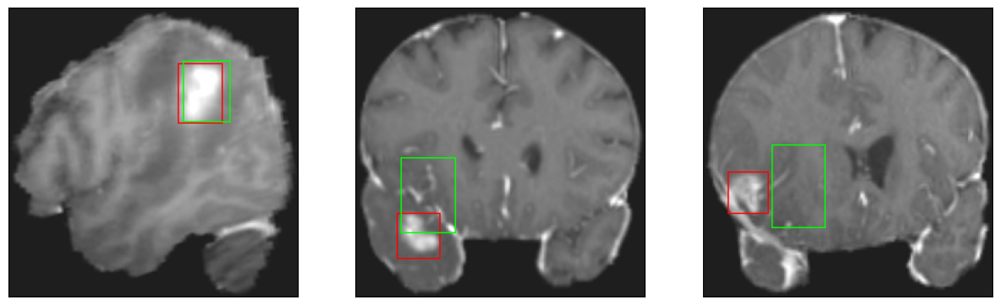

26/26 [==============================] - 8s 315ms/step - loss: 6.5243 - IoU: 0.5335 - val_loss: 11.5454 - val_IoU: 0.4110
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 6.2941 - IoU: 0.5479
Epoch 99: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


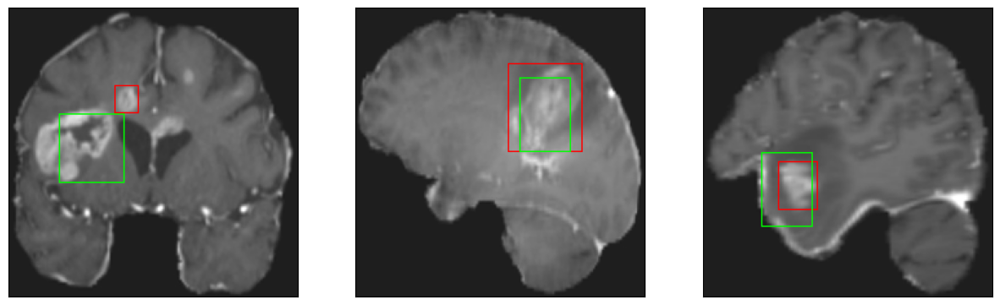

26/26 [==============================] - 8s 316ms/step - loss: 6.2941 - IoU: 0.5479 - val_loss: 9.0387 - val_IoU: 0.4899
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 6.5921 - IoU: 0.5260
Epoch 100: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


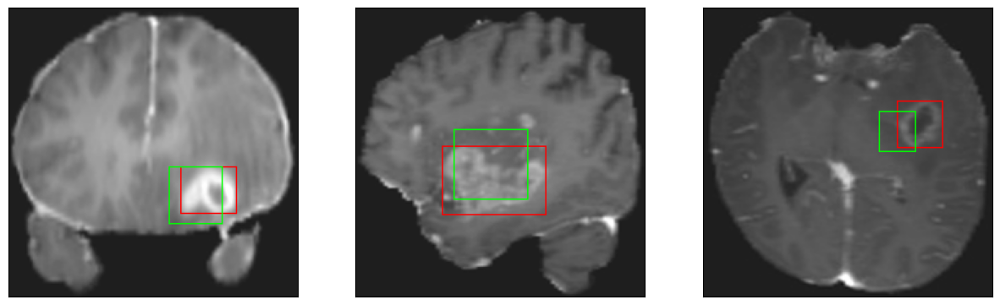

26/26 [==============================] - 8s 299ms/step - loss: 6.5921 - IoU: 0.5260 - val_loss: 8.9171 - val_IoU: 0.5060
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 6.1340 - IoU: 0.5576
Epoch 101: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


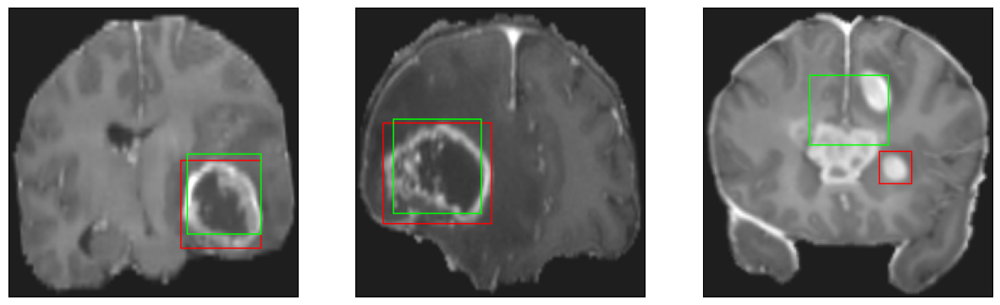

26/26 [==============================] - 8s 308ms/step - loss: 6.1340 - IoU: 0.5576 - val_loss: 8.3411 - val_IoU: 0.5234
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 6.4976 - IoU: 0.5404
Epoch 102: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


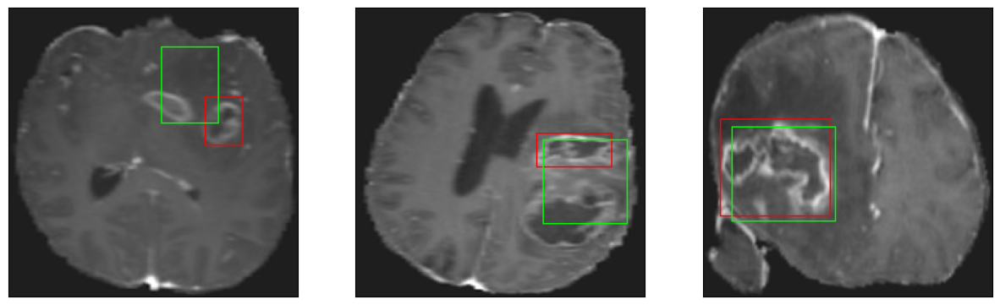

26/26 [==============================] - 8s 310ms/step - loss: 6.4976 - IoU: 0.5404 - val_loss: 8.4647 - val_IoU: 0.5269
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 6.5785 - IoU: 0.5332
Epoch 103: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


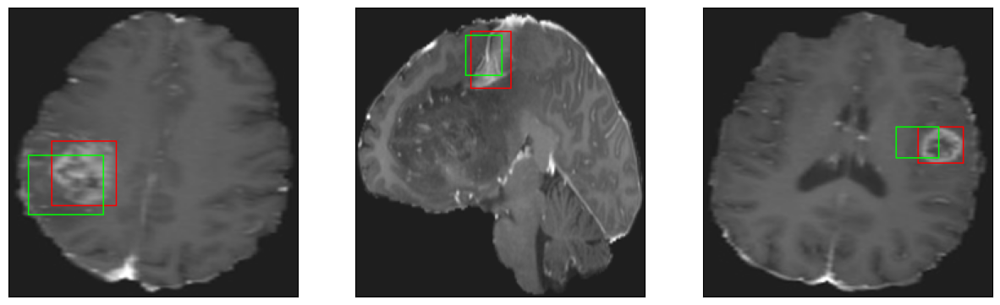

26/26 [==============================] - 8s 306ms/step - loss: 6.5785 - IoU: 0.5332 - val_loss: 9.5268 - val_IoU: 0.4580
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 6.5552 - IoU: 0.5440
Epoch 104: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


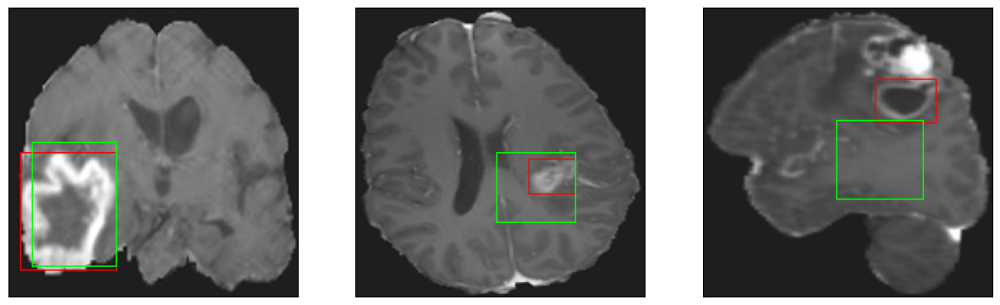

26/26 [==============================] - 8s 293ms/step - loss: 6.5552 - IoU: 0.5440 - val_loss: 16.6680 - val_IoU: 0.3251
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 6.6752 - IoU: 0.5270
Epoch 105: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


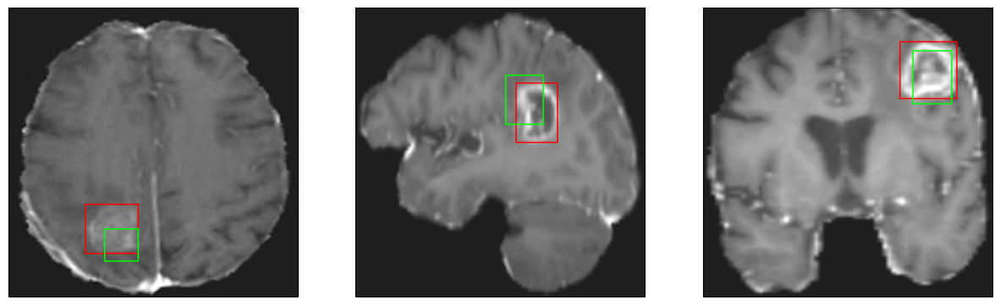

26/26 [==============================] - 8s 304ms/step - loss: 6.6752 - IoU: 0.5270 - val_loss: 11.2406 - val_IoU: 0.4253
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 6.3443 - IoU: 0.5503
Epoch 106: val_IoU did not improve from 0.52795
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


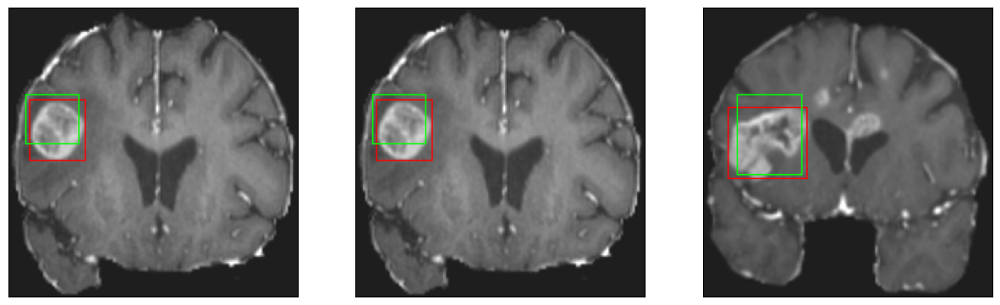

26/26 [==============================] - 7s 291ms/step - loss: 6.3443 - IoU: 0.5503 - val_loss: 9.2424 - val_IoU: 0.4936
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 6.5132 - IoU: 0.5348
Epoch 107: val_IoU improved from 0.52795 to 0.53458, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


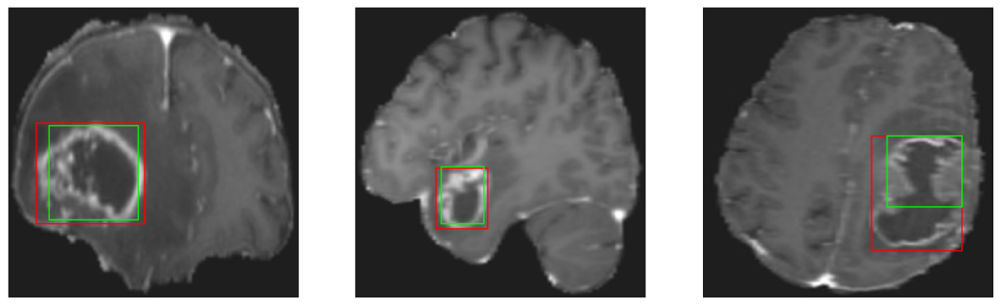

26/26 [==============================] - 32s 1s/step - loss: 6.5132 - IoU: 0.5348 - val_loss: 8.3675 - val_IoU: 0.5346
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 6.3923 - IoU: 0.5449
Epoch 108: val_IoU did not improve from 0.53458
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


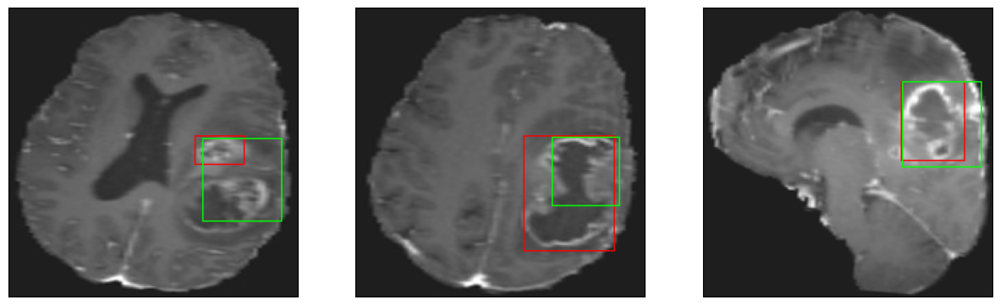

26/26 [==============================] - 8s 307ms/step - loss: 6.3923 - IoU: 0.5449 - val_loss: 8.9959 - val_IoU: 0.4988
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 6.3756 - IoU: 0.5368
Epoch 109: val_IoU did not improve from 0.53458
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


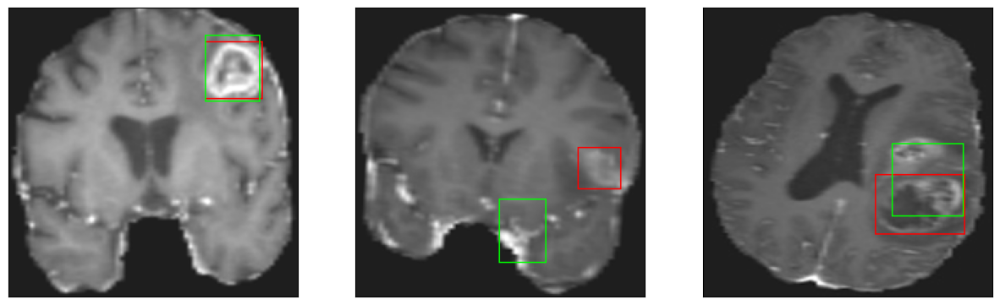

26/26 [==============================] - 8s 315ms/step - loss: 6.3756 - IoU: 0.5368 - val_loss: 9.3073 - val_IoU: 0.4919
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 6.2572 - IoU: 0.5494
Epoch 110: val_IoU improved from 0.53458 to 0.53623, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


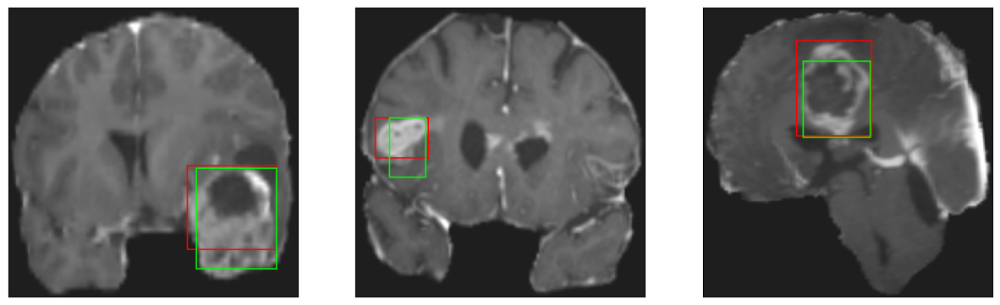

26/26 [==============================] - 21s 813ms/step - loss: 6.2572 - IoU: 0.5494 - val_loss: 8.5990 - val_IoU: 0.5362
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 6.2049 - IoU: 0.5490
Epoch 111: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


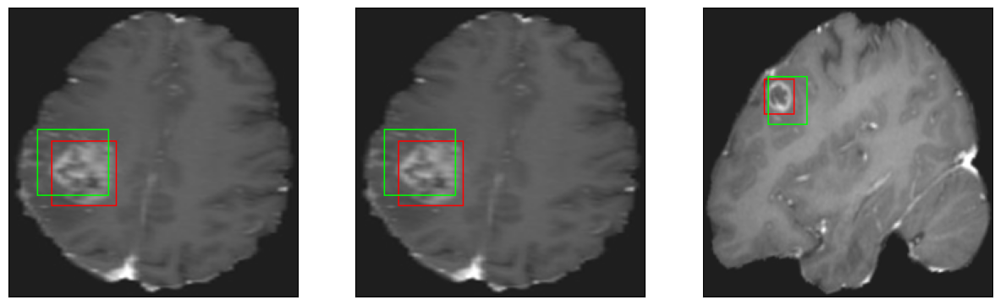

26/26 [==============================] - 8s 327ms/step - loss: 6.2049 - IoU: 0.5490 - val_loss: 9.1996 - val_IoU: 0.5034
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 5.8371 - IoU: 0.5726
Epoch 112: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


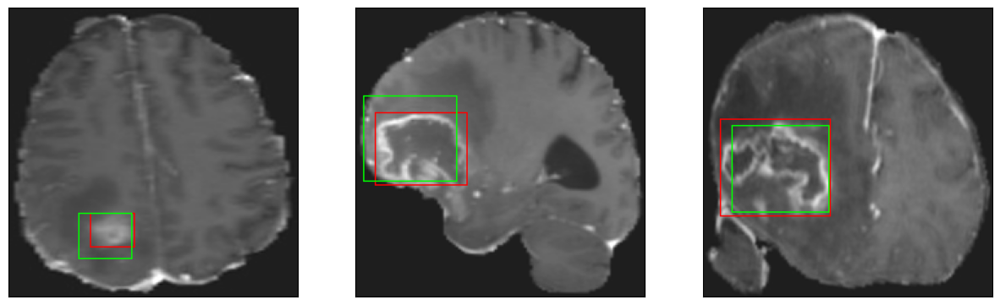

26/26 [==============================] - 8s 313ms/step - loss: 5.8371 - IoU: 0.5726 - val_loss: 9.1257 - val_IoU: 0.4870
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 6.1564 - IoU: 0.5565
Epoch 113: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4


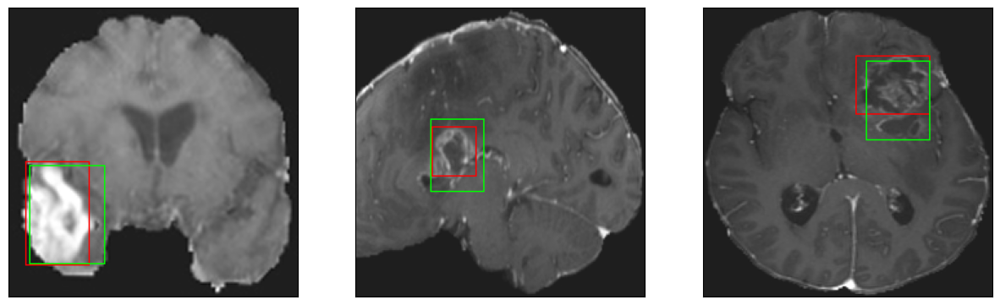

26/26 [==============================] - 8s 301ms/step - loss: 6.1564 - IoU: 0.5565 - val_loss: 9.7878 - val_IoU: 0.5044
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 6.7113 - IoU: 0.5261
Epoch 114: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


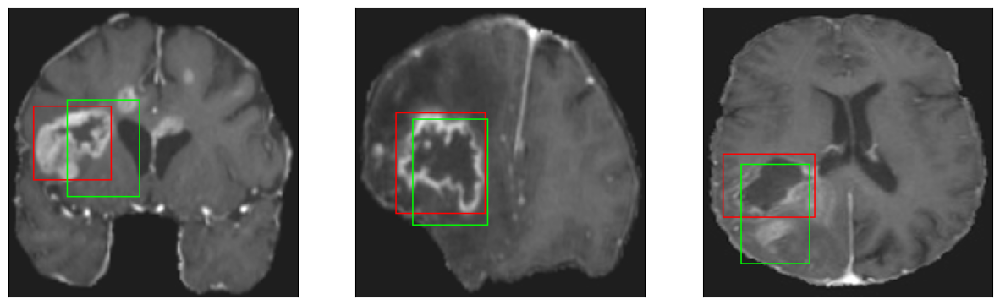

26/26 [==============================] - 8s 314ms/step - loss: 6.7113 - IoU: 0.5261 - val_loss: 11.1020 - val_IoU: 0.4650
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 6.2468 - IoU: 0.5439
Epoch 115: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


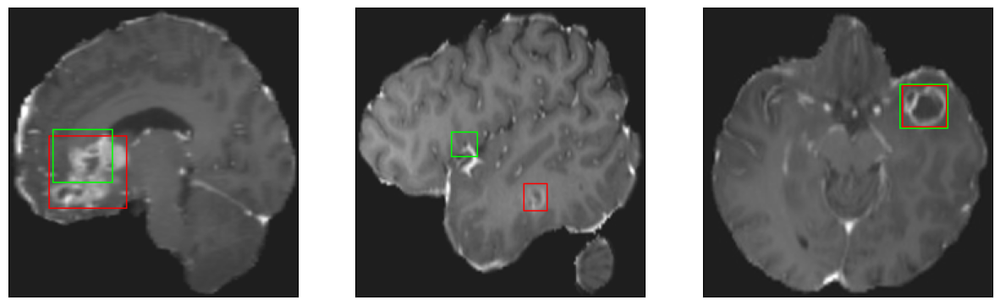

26/26 [==============================] - 7s 277ms/step - loss: 6.2468 - IoU: 0.5439 - val_loss: 9.8777 - val_IoU: 0.4475
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 6.2307 - IoU: 0.5421
Epoch 116: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


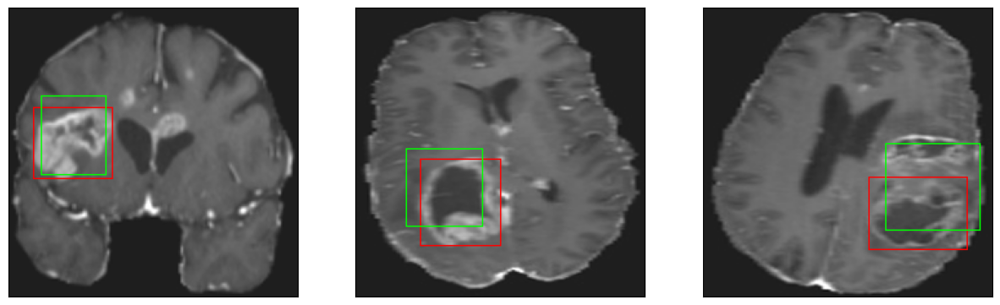

26/26 [==============================] - 8s 298ms/step - loss: 6.2307 - IoU: 0.5421 - val_loss: 9.6154 - val_IoU: 0.4633
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 5.8020 - IoU: 0.5780
Epoch 117: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


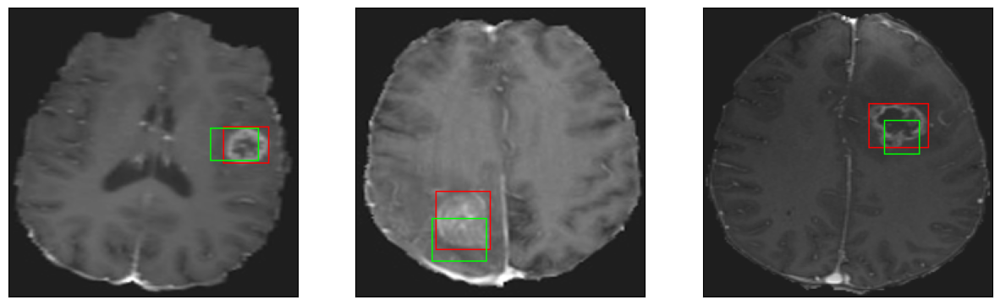

26/26 [==============================] - 8s 309ms/step - loss: 5.8020 - IoU: 0.5780 - val_loss: 9.2446 - val_IoU: 0.4939
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 6.2761 - IoU: 0.5557
Epoch 118: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


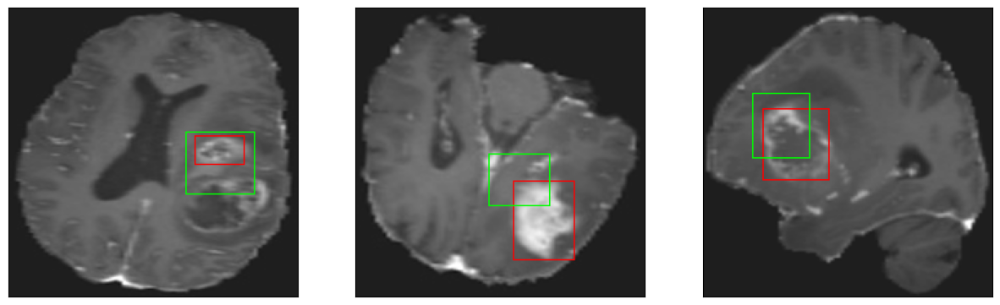

26/26 [==============================] - 8s 290ms/step - loss: 6.2761 - IoU: 0.5557 - val_loss: 10.0985 - val_IoU: 0.4587
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 6.1310 - IoU: 0.5514
Epoch 119: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4


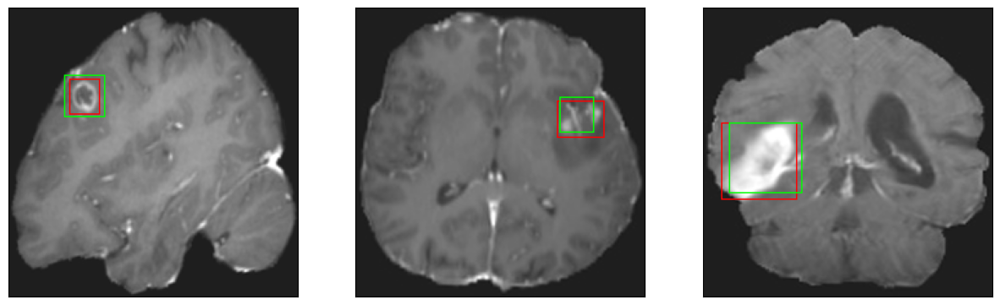

26/26 [==============================] - 8s 319ms/step - loss: 6.1310 - IoU: 0.5514 - val_loss: 8.6496 - val_IoU: 0.5337
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 6.0239 - IoU: 0.5579
Epoch 120: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


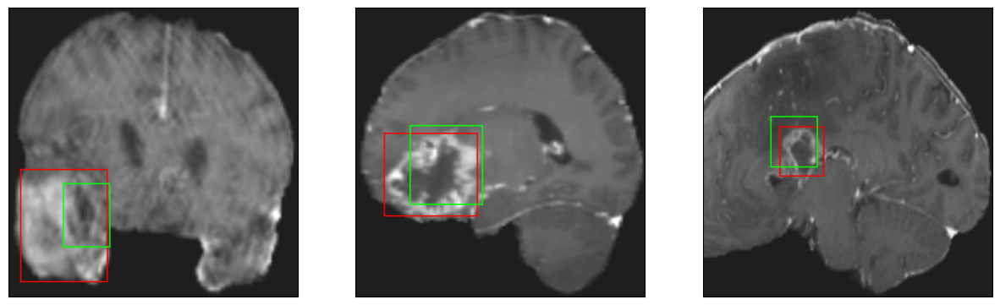

26/26 [==============================] - 8s 321ms/step - loss: 6.0239 - IoU: 0.5579 - val_loss: 9.0521 - val_IoU: 0.4971
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 6.2214 - IoU: 0.5436
Epoch 121: val_IoU did not improve from 0.53623
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


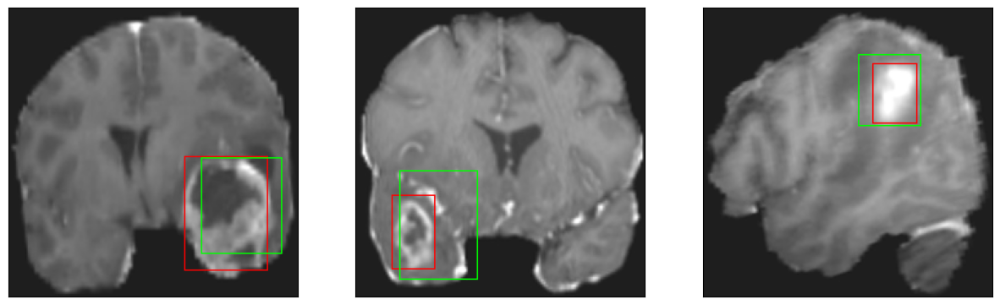

26/26 [==============================] - 8s 310ms/step - loss: 6.2214 - IoU: 0.5436 - val_loss: 15.2512 - val_IoU: 0.3902
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 6.1192 - IoU: 0.5533
Epoch 122: val_IoU improved from 0.53623 to 0.55325, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


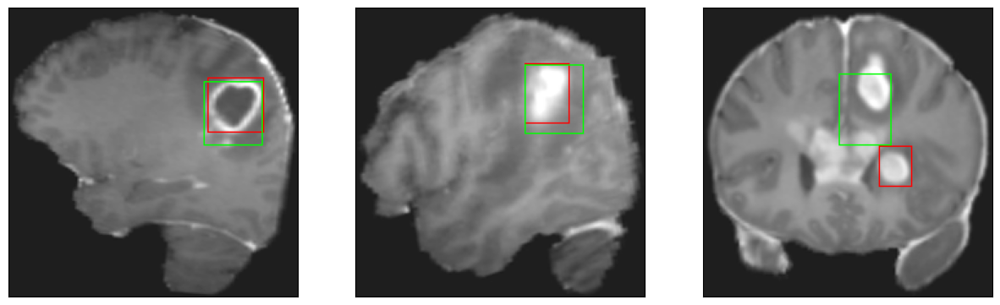

26/26 [==============================] - 32s 1s/step - loss: 6.1192 - IoU: 0.5533 - val_loss: 8.2259 - val_IoU: 0.5533
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 6.6326 - IoU: 0.5408
Epoch 123: val_IoU did not improve from 0.55325
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


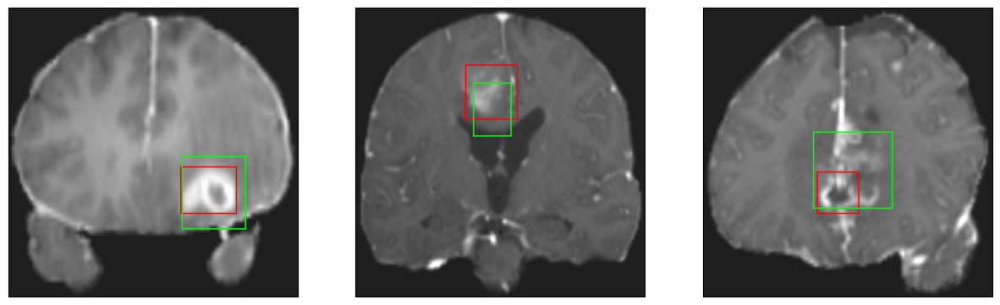

26/26 [==============================] - 8s 308ms/step - loss: 6.6326 - IoU: 0.5408 - val_loss: 8.7145 - val_IoU: 0.5478
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 6.5239 - IoU: 0.5289
Epoch 124: val_IoU did not improve from 0.55325
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


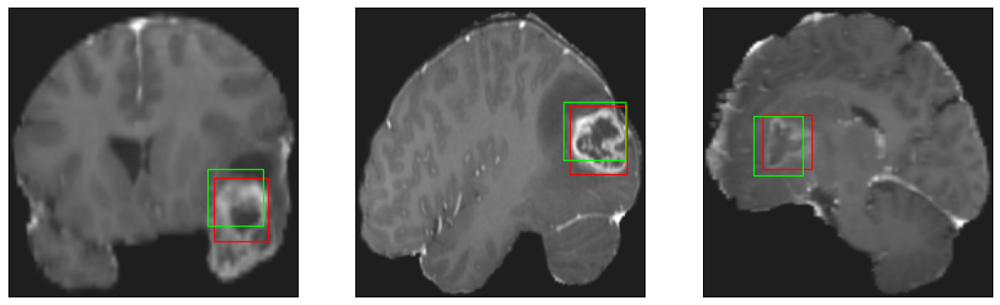

26/26 [==============================] - 8s 304ms/step - loss: 6.5239 - IoU: 0.5289 - val_loss: 9.1805 - val_IoU: 0.4888
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 6.0107 - IoU: 0.5614
Epoch 125: val_IoU did not improve from 0.55325
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


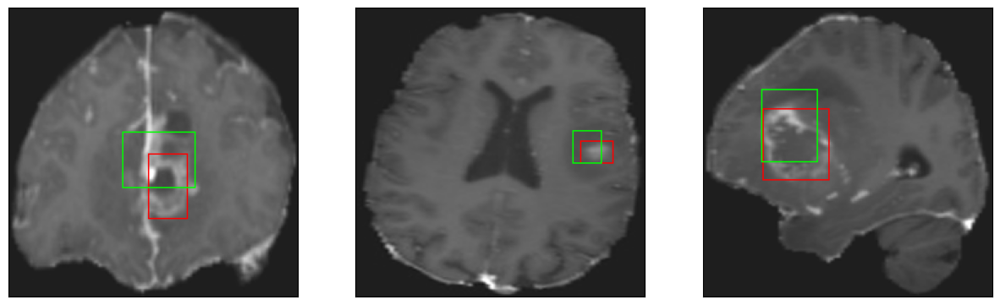

26/26 [==============================] - 8s 303ms/step - loss: 6.0107 - IoU: 0.5614 - val_loss: 8.6796 - val_IoU: 0.5095
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 6.0103 - IoU: 0.5524
Epoch 126: val_IoU did not improve from 0.55325
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


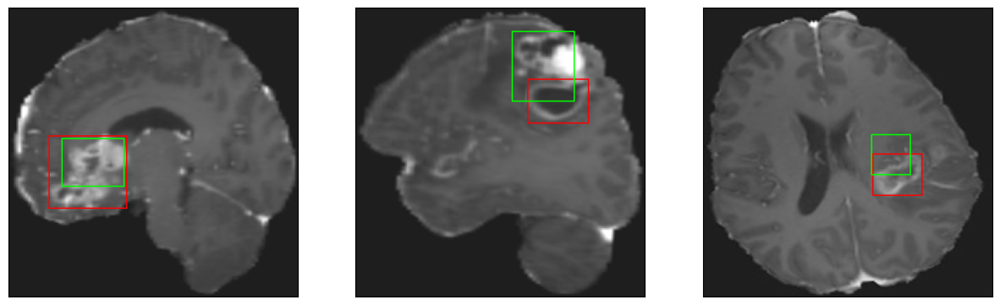

26/26 [==============================] - 8s 320ms/step - loss: 6.0103 - IoU: 0.5524 - val_loss: 9.3080 - val_IoU: 0.4713
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 5.5435 - IoU: 0.5851
Epoch 127: val_IoU improved from 0.55325 to 0.55553, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 49ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4


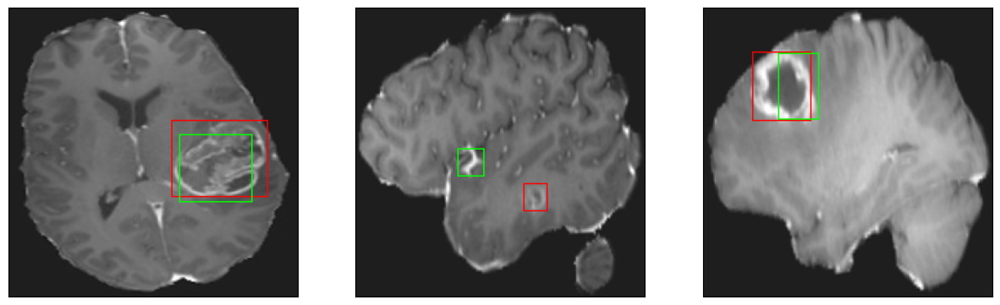

26/26 [==============================] - 37s 1s/step - loss: 5.5435 - IoU: 0.5851 - val_loss: 7.9883 - val_IoU: 0.5555
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 6.0265 - IoU: 0.5668
Epoch 128: val_IoU did not improve from 0.55553
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


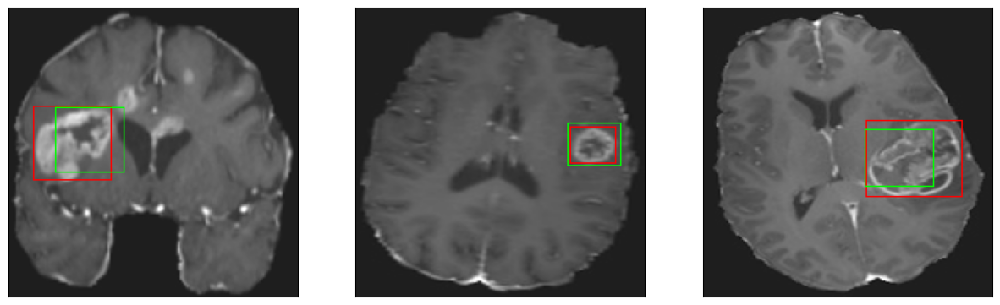

26/26 [==============================] - 7s 282ms/step - loss: 6.0265 - IoU: 0.5668 - val_loss: 9.5700 - val_IoU: 0.4716
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 6.1543 - IoU: 0.5538
Epoch 129: val_IoU did not improve from 0.55553
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


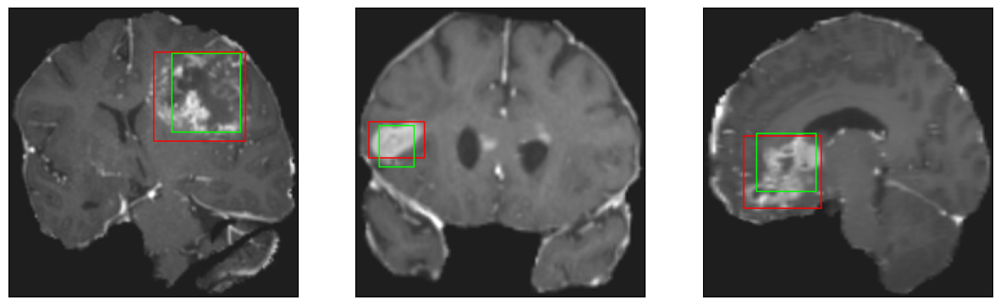

26/26 [==============================] - 8s 296ms/step - loss: 6.1543 - IoU: 0.5538 - val_loss: 8.5598 - val_IoU: 0.5157
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 5.6330 - IoU: 0.5763
Epoch 130: val_IoU did not improve from 0.55553
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


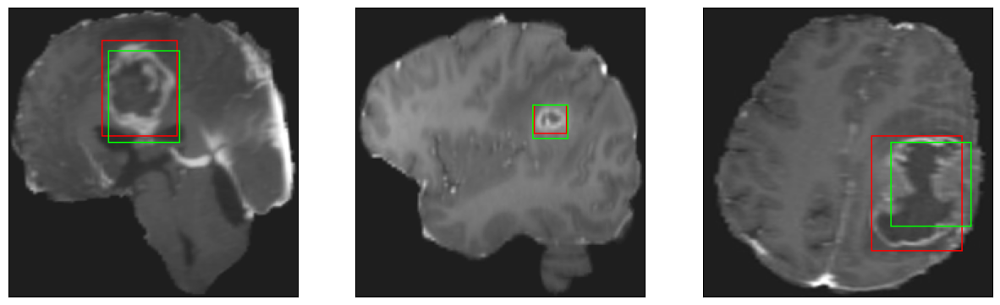

26/26 [==============================] - 8s 301ms/step - loss: 5.6330 - IoU: 0.5763 - val_loss: 8.3688 - val_IoU: 0.5517
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 5.8961 - IoU: 0.5624
Epoch 131: val_IoU improved from 0.55553 to 0.55610, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


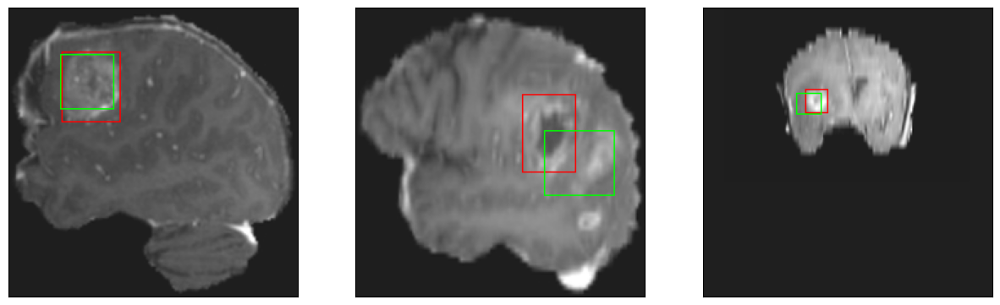

26/26 [==============================] - 41s 2s/step - loss: 5.8961 - IoU: 0.5624 - val_loss: 8.2162 - val_IoU: 0.5561
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 5.9658 - IoU: 0.5650
Epoch 132: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


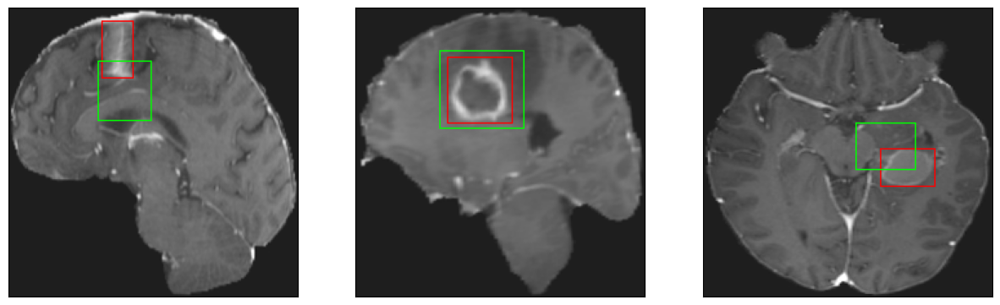

26/26 [==============================] - 8s 295ms/step - loss: 5.9658 - IoU: 0.5650 - val_loss: 9.0242 - val_IoU: 0.5142
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 6.2199 - IoU: 0.5645
Epoch 133: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


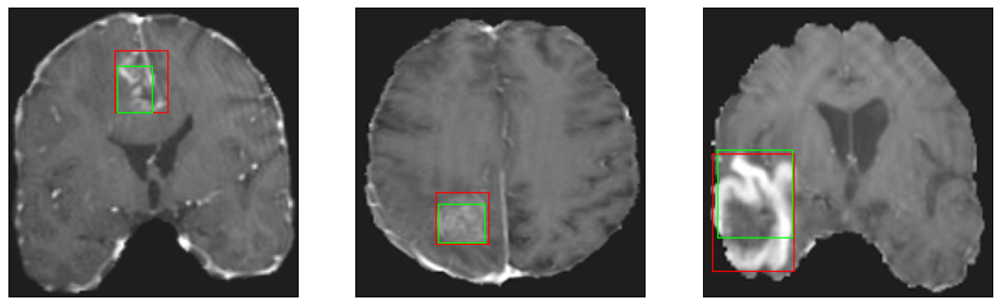

26/26 [==============================] - 8s 300ms/step - loss: 6.2199 - IoU: 0.5645 - val_loss: 8.9309 - val_IoU: 0.5055
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 5.8654 - IoU: 0.5542
Epoch 134: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


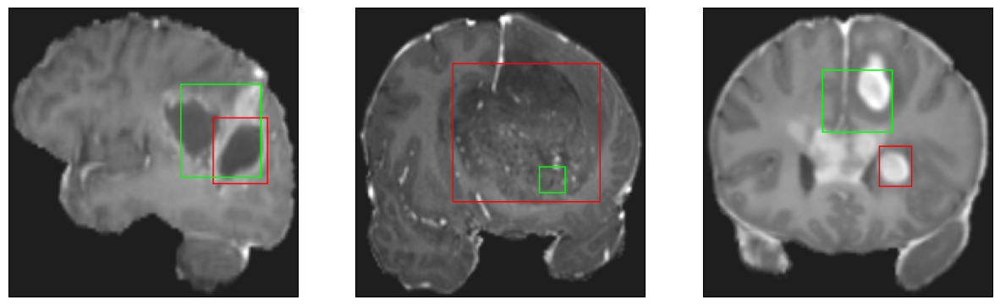

26/26 [==============================] - 8s 308ms/step - loss: 5.8654 - IoU: 0.5542 - val_loss: 9.1422 - val_IoU: 0.4968
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 5.8983 - IoU: 0.5690
Epoch 135: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


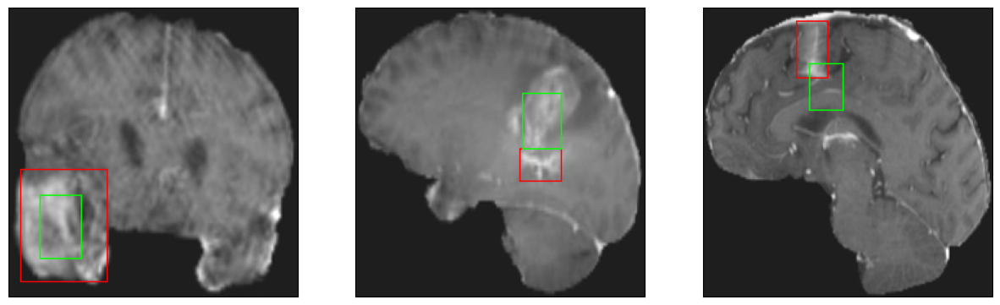

26/26 [==============================] - 7s 274ms/step - loss: 5.8983 - IoU: 0.5690 - val_loss: 8.9034 - val_IoU: 0.4981
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 5.9045 - IoU: 0.5650
Epoch 136: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


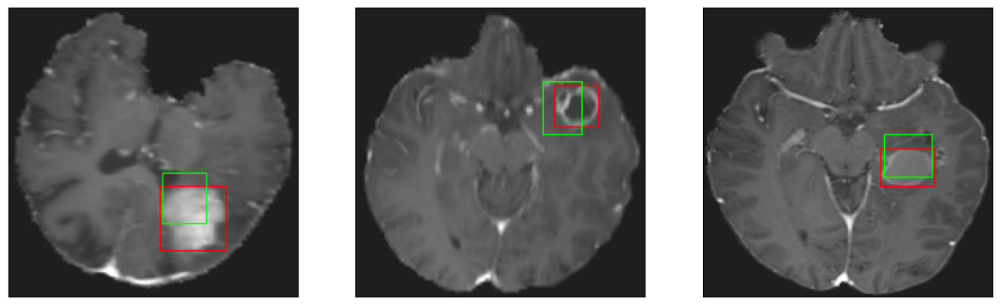

26/26 [==============================] - 7s 284ms/step - loss: 5.9045 - IoU: 0.5650 - val_loss: 8.9655 - val_IoU: 0.5159
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 6.1044 - IoU: 0.5595
Epoch 137: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


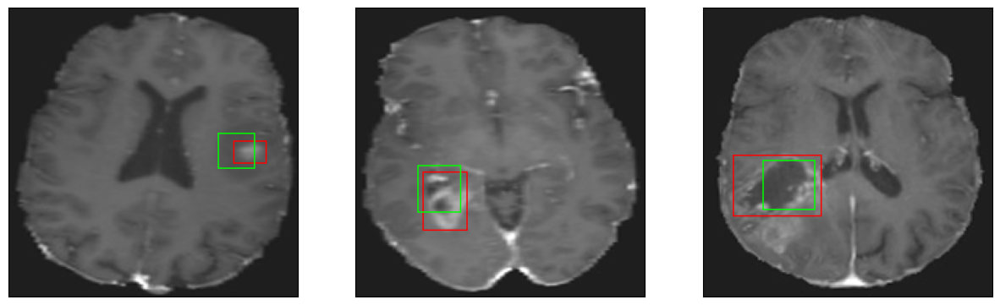

26/26 [==============================] - 8s 301ms/step - loss: 6.1044 - IoU: 0.5595 - val_loss: 8.6786 - val_IoU: 0.5163
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 5.5639 - IoU: 0.5839
Epoch 138: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


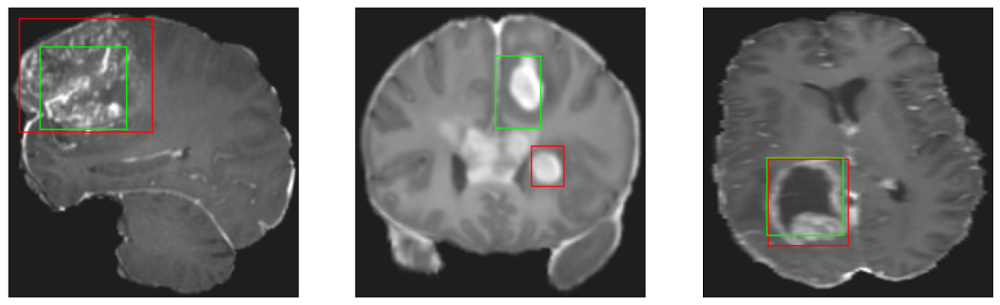

26/26 [==============================] - 7s 272ms/step - loss: 5.5639 - IoU: 0.5839 - val_loss: 8.9156 - val_IoU: 0.5106
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 5.9618 - IoU: 0.5604
Epoch 139: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4


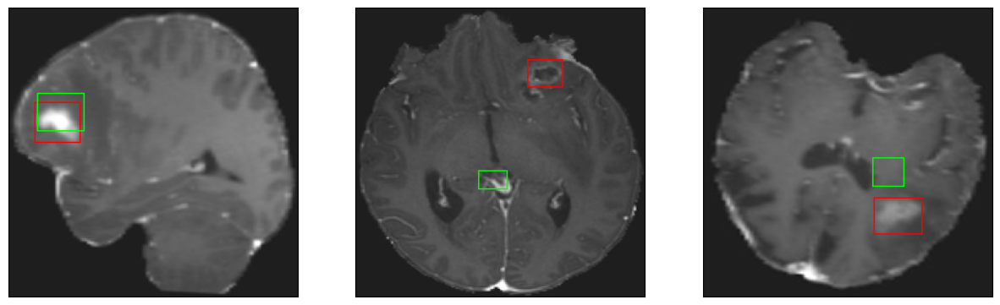

26/26 [==============================] - 8s 305ms/step - loss: 5.9618 - IoU: 0.5604 - val_loss: 9.5169 - val_IoU: 0.4564
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 5.9551 - IoU: 0.5661
Epoch 140: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


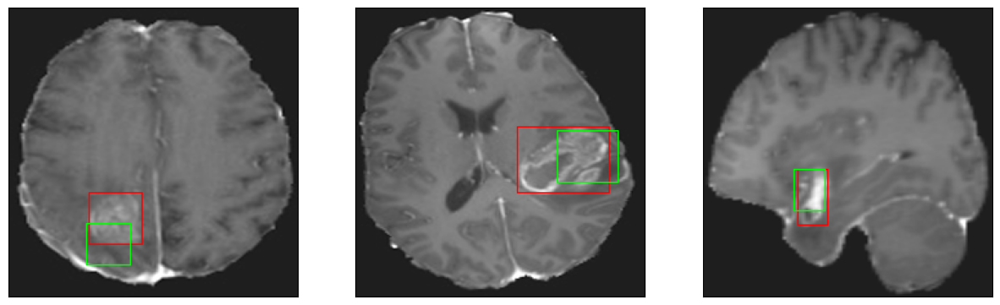

26/26 [==============================] - 8s 296ms/step - loss: 5.9551 - IoU: 0.5661 - val_loss: 9.0148 - val_IoU: 0.5070
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 5.7870 - IoU: 0.5756
Epoch 141: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


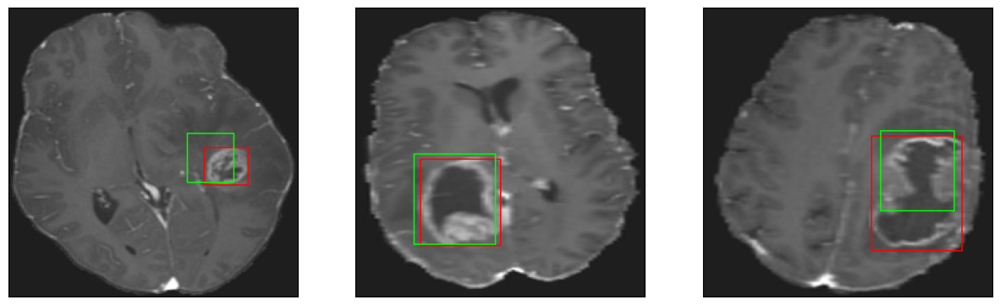

26/26 [==============================] - 8s 294ms/step - loss: 5.7870 - IoU: 0.5756 - val_loss: 9.4025 - val_IoU: 0.4487
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 5.9089 - IoU: 0.5743
Epoch 142: val_IoU did not improve from 0.55610
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


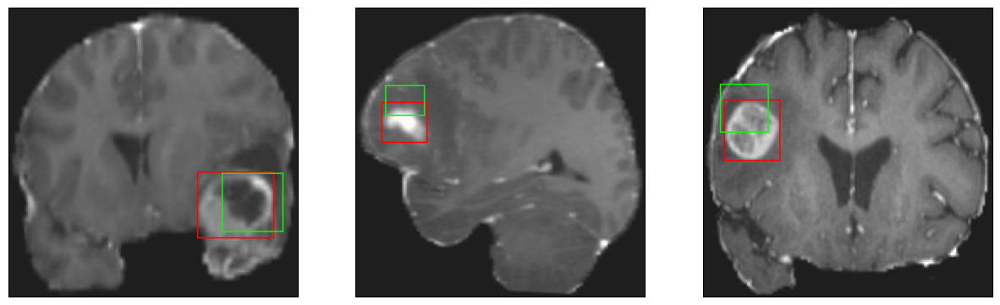

26/26 [==============================] - 8s 321ms/step - loss: 5.9089 - IoU: 0.5743 - val_loss: 8.8487 - val_IoU: 0.5247
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 6.1025 - IoU: 0.5461
Epoch 143: val_IoU improved from 0.55610 to 0.57625, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


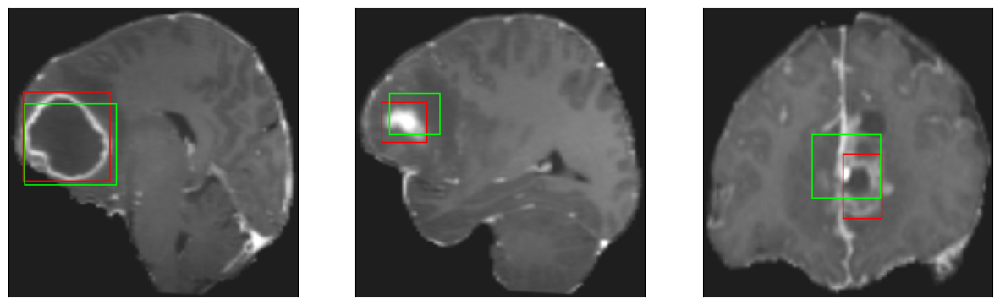

26/26 [==============================] - 49s 2s/step - loss: 6.1025 - IoU: 0.5461 - val_loss: 7.7378 - val_IoU: 0.5763
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 5.9558 - IoU: 0.5610
Epoch 144: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


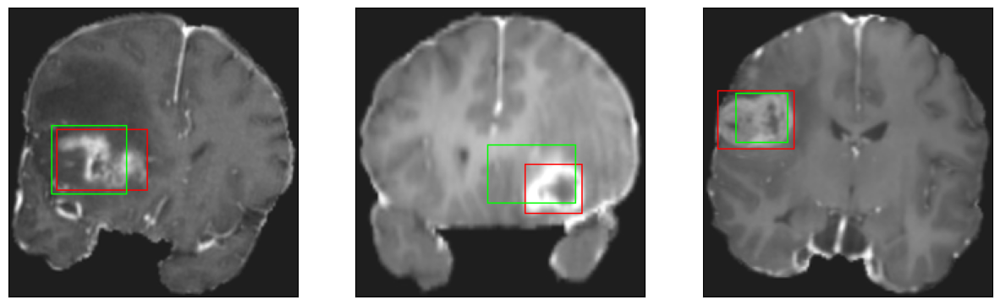

26/26 [==============================] - 8s 296ms/step - loss: 5.9558 - IoU: 0.5610 - val_loss: 9.4737 - val_IoU: 0.4936
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 5.6288 - IoU: 0.5867
Epoch 145: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


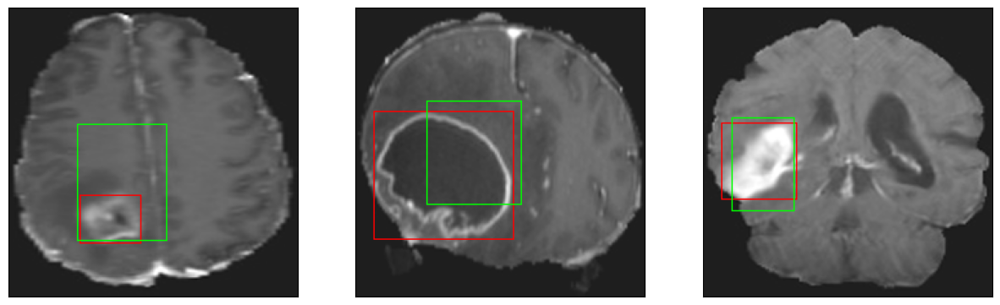

26/26 [==============================] - 8s 311ms/step - loss: 5.6288 - IoU: 0.5867 - val_loss: 18.1756 - val_IoU: 0.2706
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 5.6870 - IoU: 0.5747
Epoch 146: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


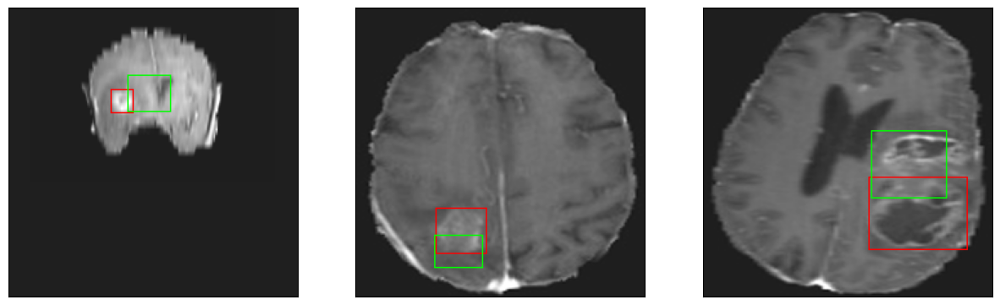

26/26 [==============================] - 8s 290ms/step - loss: 5.6870 - IoU: 0.5747 - val_loss: 9.6250 - val_IoU: 0.4776
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 5.8213 - IoU: 0.5755
Epoch 147: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


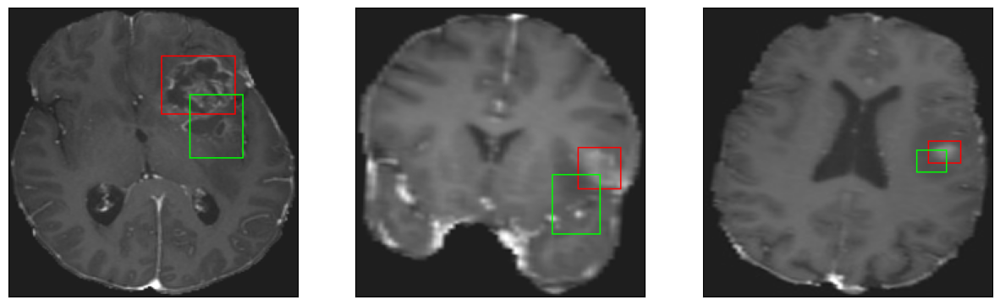

26/26 [==============================] - 8s 314ms/step - loss: 5.8213 - IoU: 0.5755 - val_loss: 8.9465 - val_IoU: 0.5042
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 5.8772 - IoU: 0.5719
Epoch 148: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


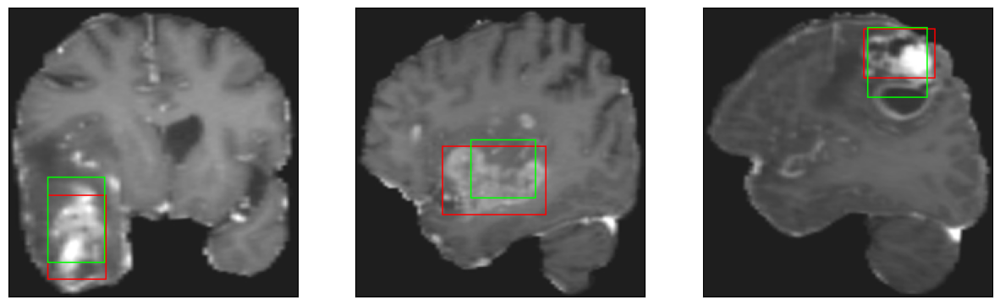

26/26 [==============================] - 8s 311ms/step - loss: 5.8772 - IoU: 0.5719 - val_loss: 8.4881 - val_IoU: 0.5268
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 5.8212 - IoU: 0.5752
Epoch 149: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


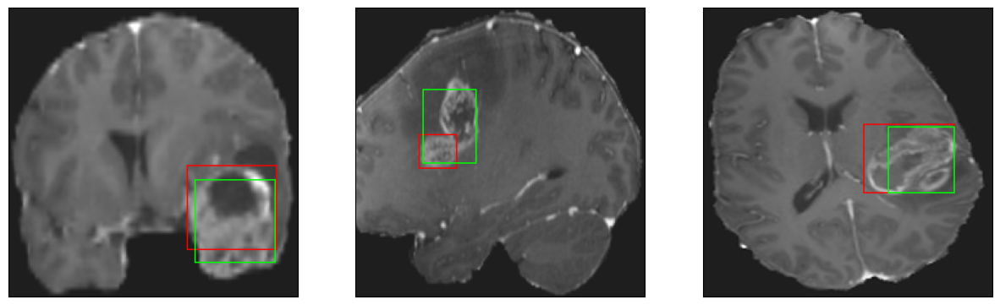

26/26 [==============================] - 7s 278ms/step - loss: 5.8212 - IoU: 0.5752 - val_loss: 8.4413 - val_IoU: 0.5549
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 5.6541 - IoU: 0.5795
Epoch 150: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


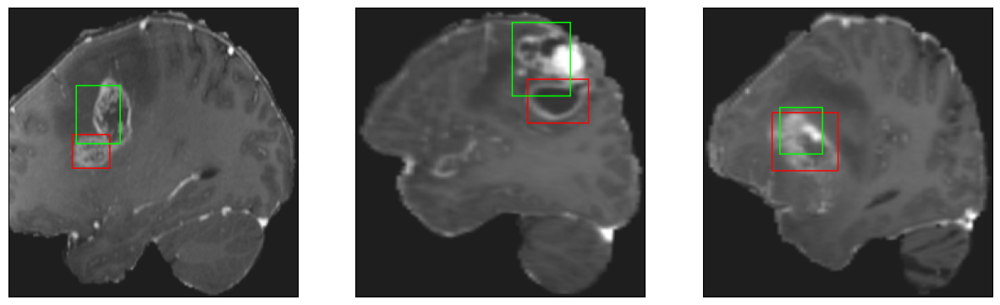

26/26 [==============================] - 8s 313ms/step - loss: 5.6541 - IoU: 0.5795 - val_loss: 9.1878 - val_IoU: 0.5158
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 5.4546 - IoU: 0.5912
Epoch 151: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


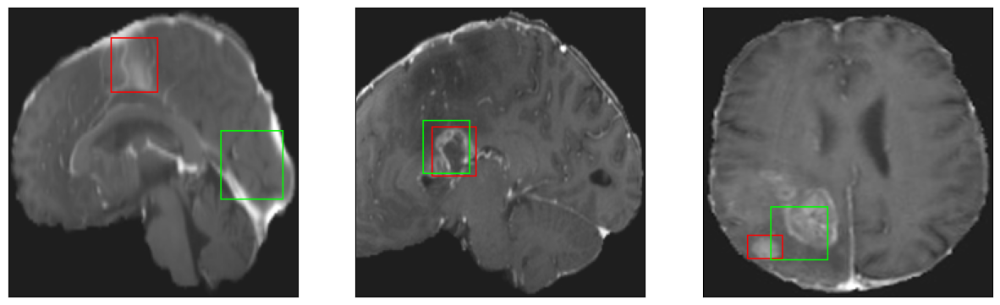

26/26 [==============================] - 7s 280ms/step - loss: 5.4546 - IoU: 0.5912 - val_loss: 8.4743 - val_IoU: 0.5451
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 5.5073 - IoU: 0.5897
Epoch 152: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


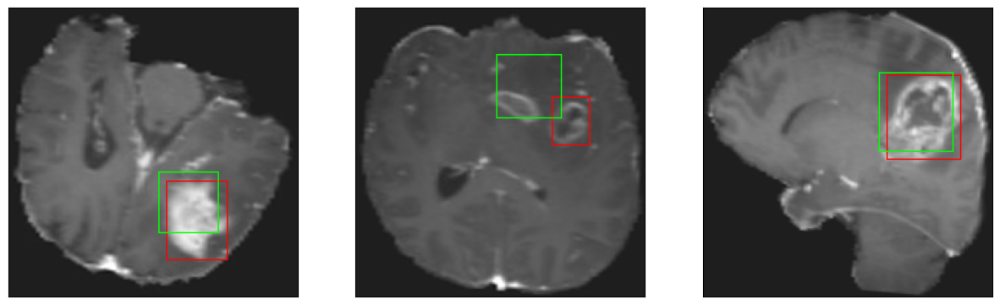

26/26 [==============================] - 8s 312ms/step - loss: 5.5073 - IoU: 0.5897 - val_loss: 8.2711 - val_IoU: 0.5311
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 5.6109 - IoU: 0.5877
Epoch 153: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


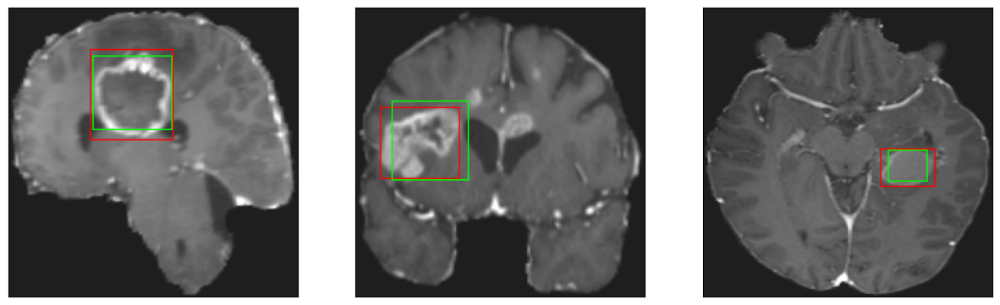

26/26 [==============================] - 8s 301ms/step - loss: 5.6109 - IoU: 0.5877 - val_loss: 8.6890 - val_IoU: 0.5239
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 5.7280 - IoU: 0.5804
Epoch 154: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


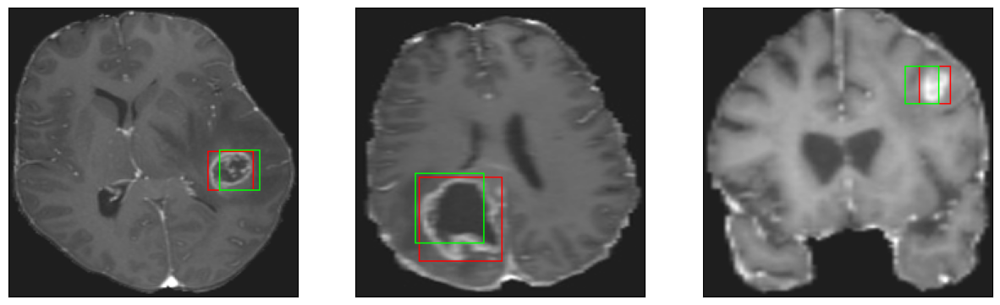

26/26 [==============================] - 7s 274ms/step - loss: 5.7280 - IoU: 0.5804 - val_loss: 8.7107 - val_IoU: 0.5111
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 5.5107 - IoU: 0.5898
Epoch 155: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


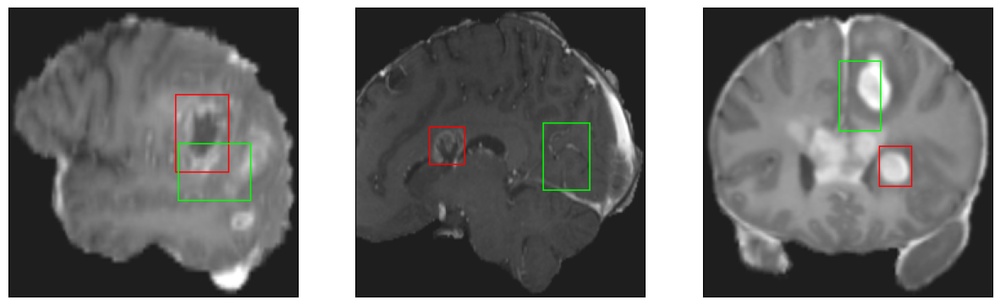

26/26 [==============================] - 7s 286ms/step - loss: 5.5107 - IoU: 0.5898 - val_loss: 9.2286 - val_IoU: 0.4908
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 5.6533 - IoU: 0.5760
Epoch 156: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


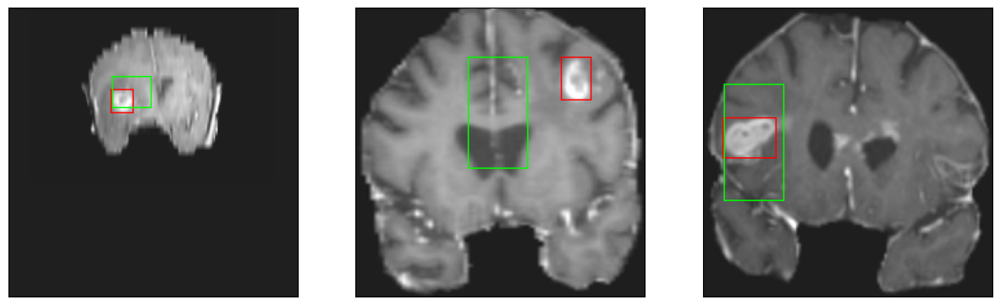

26/26 [==============================] - 7s 273ms/step - loss: 5.6533 - IoU: 0.5760 - val_loss: 26.0068 - val_IoU: 0.2137
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 5.5121 - IoU: 0.5823
Epoch 157: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


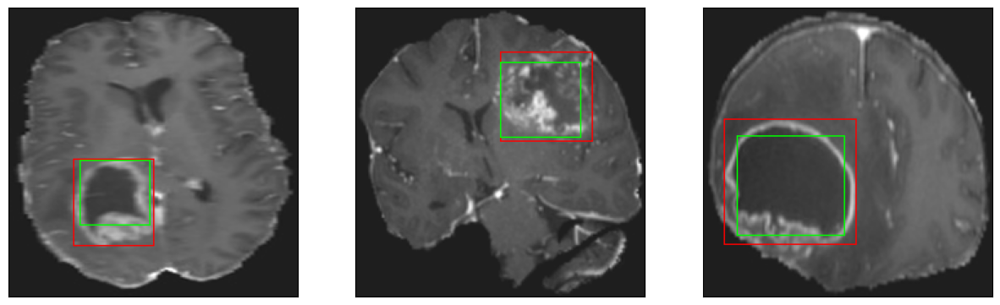

26/26 [==============================] - 8s 289ms/step - loss: 5.5121 - IoU: 0.5823 - val_loss: 8.8461 - val_IoU: 0.5142
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 5.6384 - IoU: 0.5795
Epoch 158: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


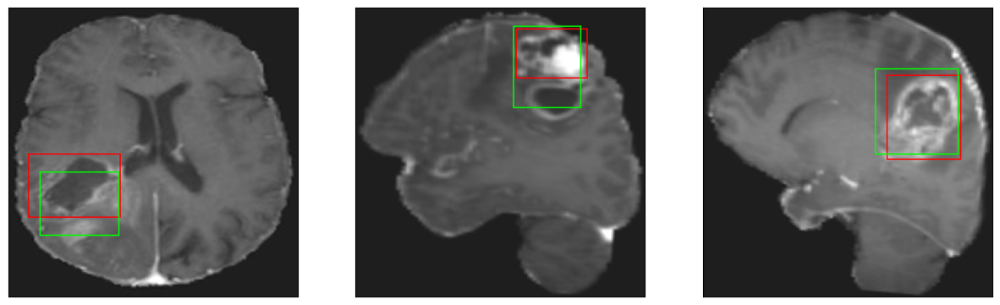

26/26 [==============================] - 8s 311ms/step - loss: 5.6384 - IoU: 0.5795 - val_loss: 8.9622 - val_IoU: 0.5119
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 5.4398 - IoU: 0.5939
Epoch 159: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


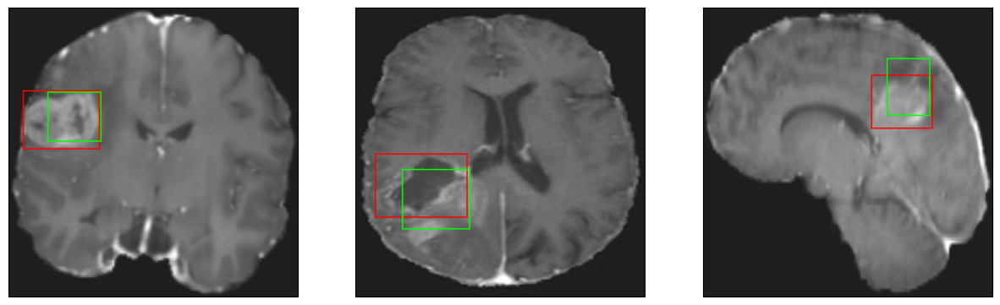

26/26 [==============================] - 8s 312ms/step - loss: 5.4398 - IoU: 0.5939 - val_loss: 8.8926 - val_IoU: 0.5032
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 5.4115 - IoU: 0.5908
Epoch 160: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


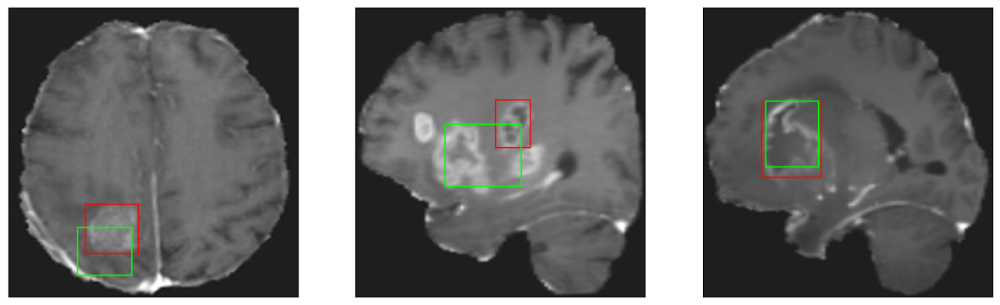

26/26 [==============================] - 8s 308ms/step - loss: 5.4115 - IoU: 0.5908 - val_loss: 7.8360 - val_IoU: 0.5628
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 5.5514 - IoU: 0.5838
Epoch 161: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


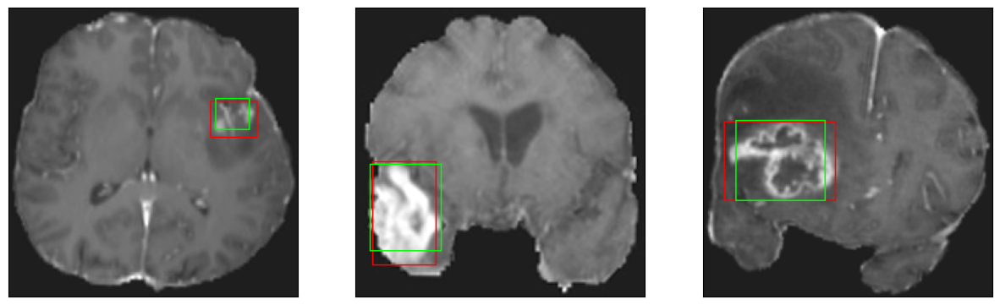

26/26 [==============================] - 7s 286ms/step - loss: 5.5514 - IoU: 0.5838 - val_loss: 9.4309 - val_IoU: 0.5053
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 5.8937 - IoU: 0.5650
Epoch 162: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


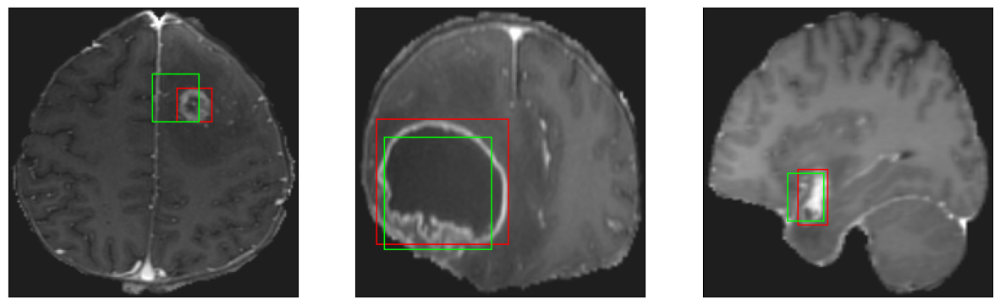

26/26 [==============================] - 8s 301ms/step - loss: 5.8937 - IoU: 0.5650 - val_loss: 8.7434 - val_IoU: 0.5147
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 5.4000 - IoU: 0.5902
Epoch 163: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


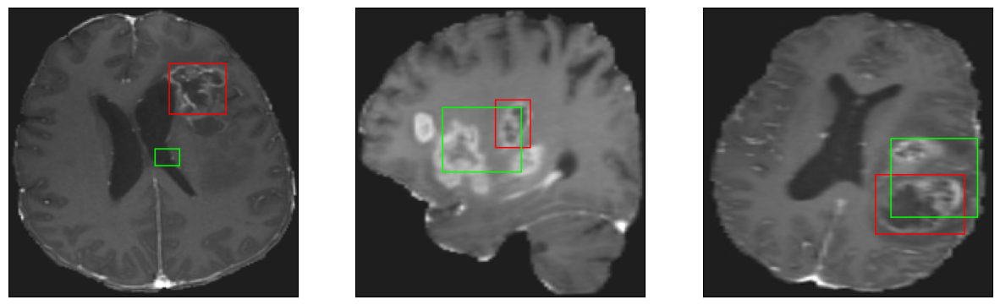

26/26 [==============================] - 8s 297ms/step - loss: 5.4000 - IoU: 0.5902 - val_loss: 8.6653 - val_IoU: 0.5198
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 5.2931 - IoU: 0.5984
Epoch 164: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


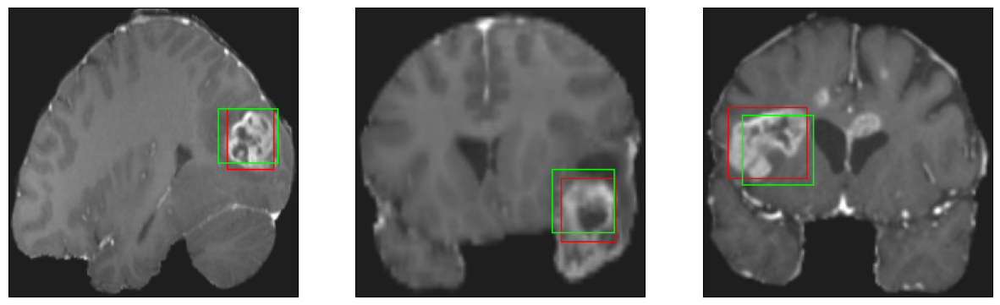

26/26 [==============================] - 8s 301ms/step - loss: 5.2931 - IoU: 0.5984 - val_loss: 8.3738 - val_IoU: 0.5291
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 5.8188 - IoU: 0.5693
Epoch 165: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


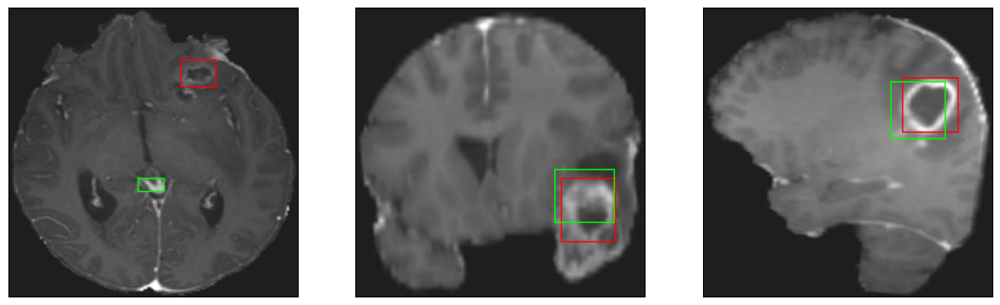

26/26 [==============================] - 8s 321ms/step - loss: 5.8188 - IoU: 0.5693 - val_loss: 8.1321 - val_IoU: 0.5429
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 5.7365 - IoU: 0.5741
Epoch 166: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


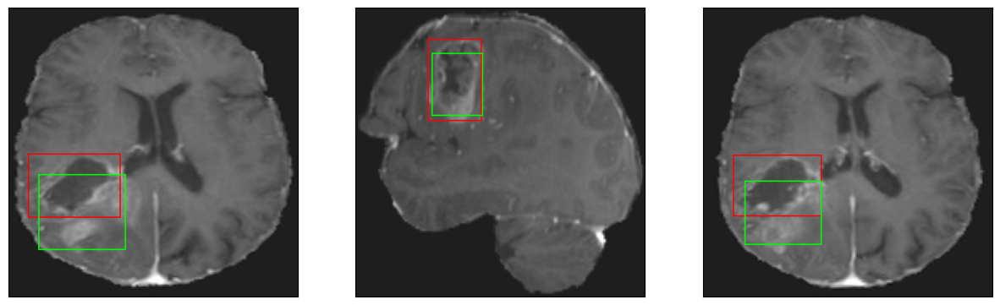

26/26 [==============================] - 7s 277ms/step - loss: 5.7365 - IoU: 0.5741 - val_loss: 8.4751 - val_IoU: 0.5150
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 5.3666 - IoU: 0.5920
Epoch 167: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


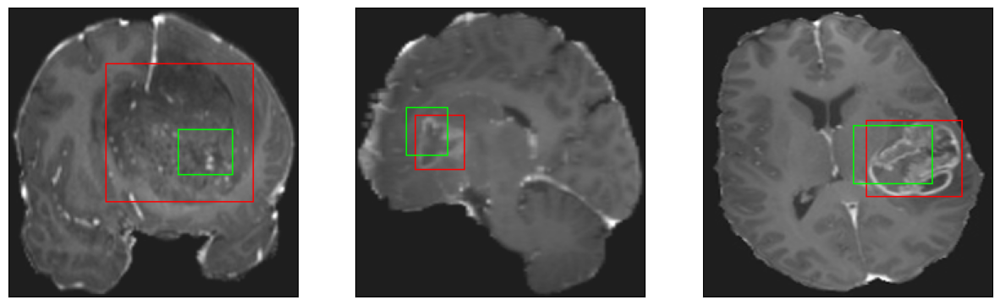

26/26 [==============================] - 7s 276ms/step - loss: 5.3666 - IoU: 0.5920 - val_loss: 8.8256 - val_IoU: 0.5091
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 5.3048 - IoU: 0.6023
Epoch 168: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 45ms/step
4


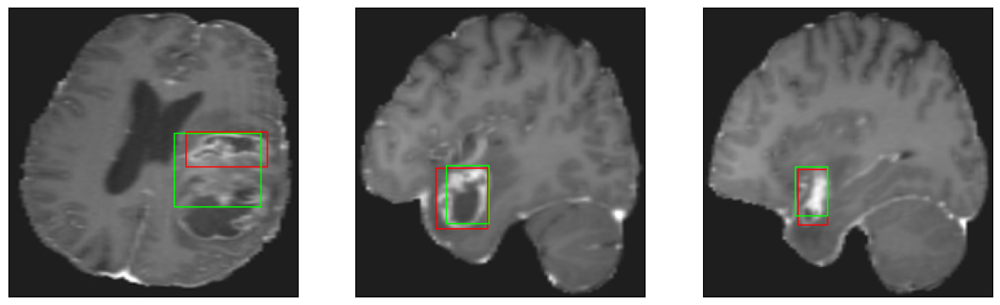

26/26 [==============================] - 8s 301ms/step - loss: 5.3048 - IoU: 0.6023 - val_loss: 8.5336 - val_IoU: 0.5215
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 5.2832 - IoU: 0.5955
Epoch 169: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


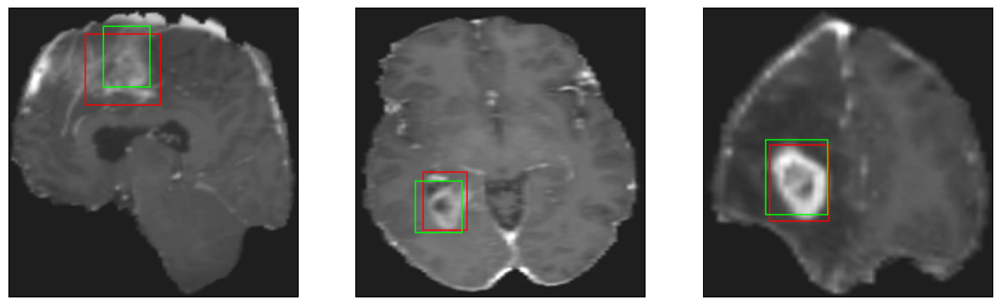

26/26 [==============================] - 7s 286ms/step - loss: 5.2832 - IoU: 0.5955 - val_loss: 8.5855 - val_IoU: 0.5245
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 5.3293 - IoU: 0.5944
Epoch 170: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


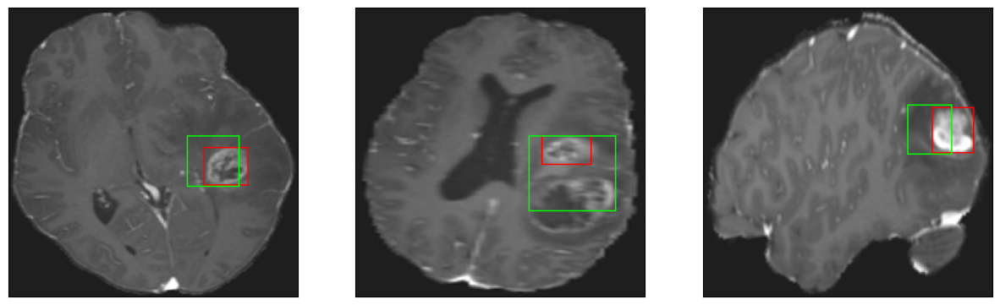

26/26 [==============================] - 8s 296ms/step - loss: 5.3293 - IoU: 0.5944 - val_loss: 8.0212 - val_IoU: 0.5457
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 5.6139 - IoU: 0.5756
Epoch 171: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


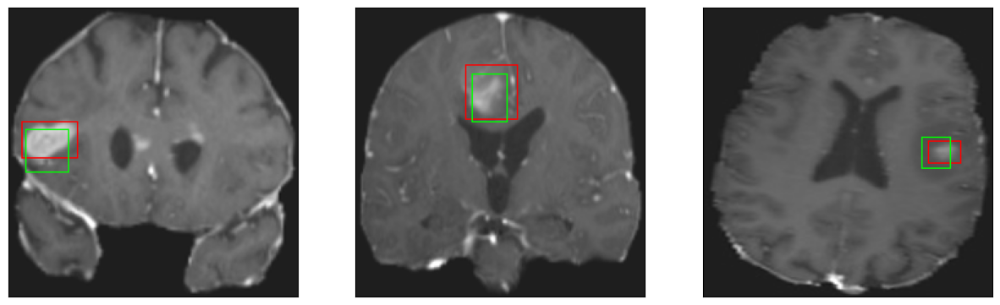

26/26 [==============================] - 7s 287ms/step - loss: 5.6139 - IoU: 0.5756 - val_loss: 8.2032 - val_IoU: 0.5609
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 5.2911 - IoU: 0.5959
Epoch 172: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


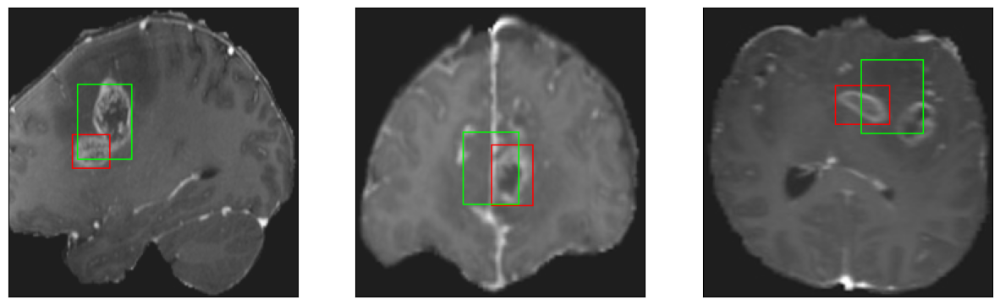

26/26 [==============================] - 8s 297ms/step - loss: 5.2911 - IoU: 0.5959 - val_loss: 8.4127 - val_IoU: 0.5279
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 5.2602 - IoU: 0.6021
Epoch 173: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


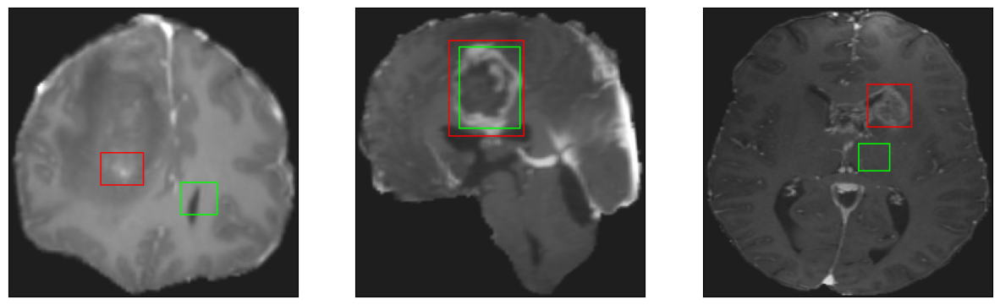

26/26 [==============================] - 7s 275ms/step - loss: 5.2602 - IoU: 0.6021 - val_loss: 8.7000 - val_IoU: 0.5021
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 5.6136 - IoU: 0.5942
Epoch 174: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


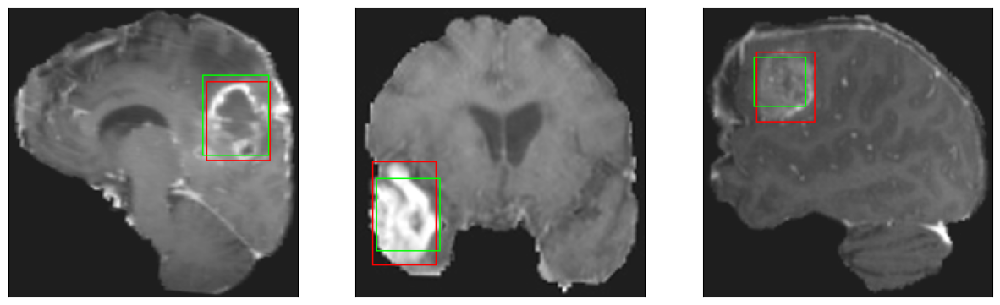

26/26 [==============================] - 8s 309ms/step - loss: 5.6136 - IoU: 0.5942 - val_loss: 9.0062 - val_IoU: 0.5126
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 5.4535 - IoU: 0.5916
Epoch 175: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


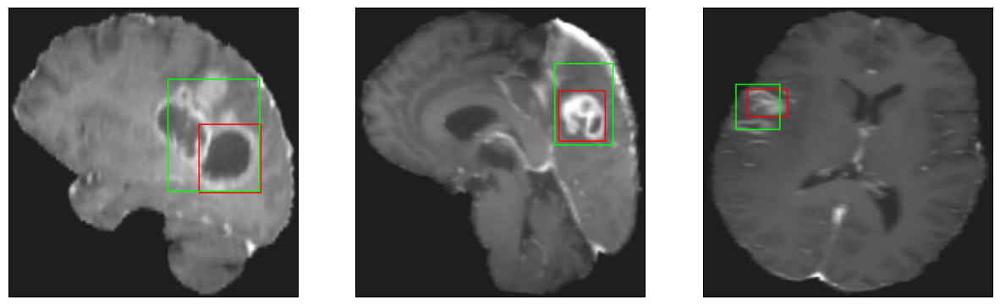

26/26 [==============================] - 8s 293ms/step - loss: 5.4535 - IoU: 0.5916 - val_loss: 8.5862 - val_IoU: 0.5270
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 5.2105 - IoU: 0.5958
Epoch 176: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


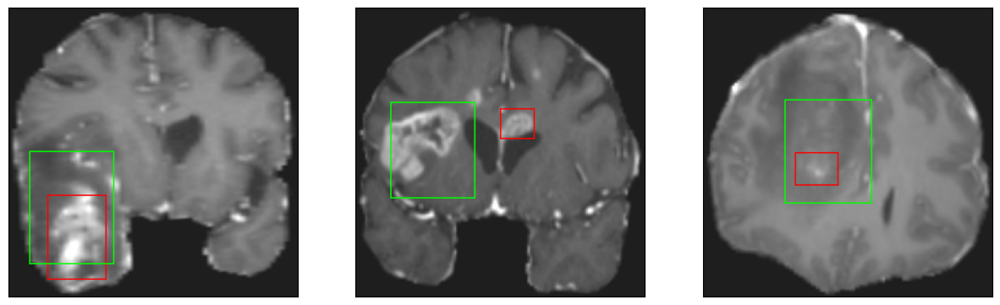

26/26 [==============================] - 8s 297ms/step - loss: 5.2105 - IoU: 0.5958 - val_loss: 15.4154 - val_IoU: 0.3800
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 5.0557 - IoU: 0.6090
Epoch 177: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


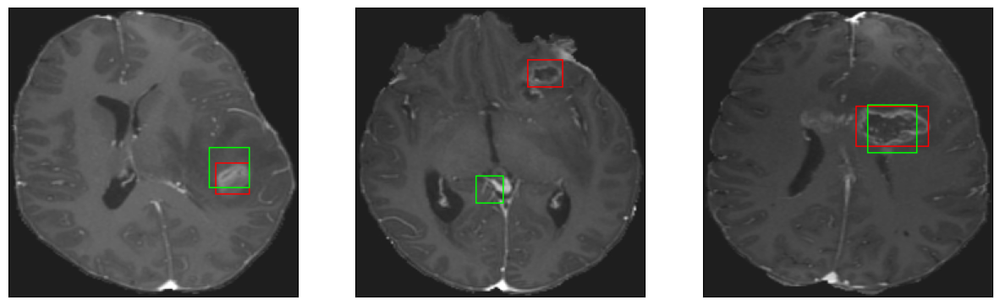

26/26 [==============================] - 8s 310ms/step - loss: 5.0557 - IoU: 0.6090 - val_loss: 7.8415 - val_IoU: 0.5536
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 5.4984 - IoU: 0.5862
Epoch 178: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


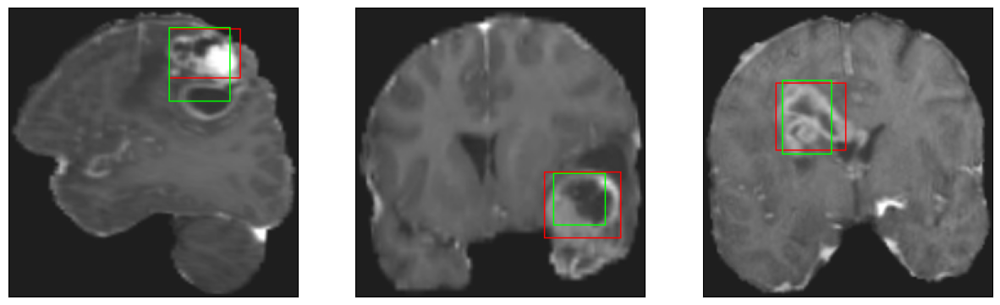

26/26 [==============================] - 8s 308ms/step - loss: 5.4984 - IoU: 0.5862 - val_loss: 9.0203 - val_IoU: 0.5180
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 5.6346 - IoU: 0.5850
Epoch 179: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


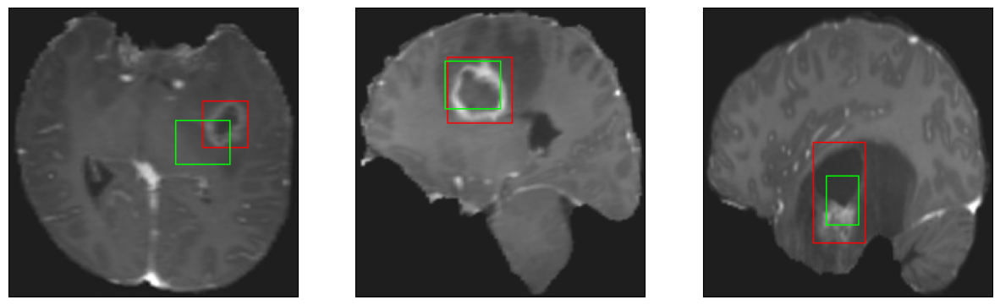

26/26 [==============================] - 7s 289ms/step - loss: 5.6346 - IoU: 0.5850 - val_loss: 10.5226 - val_IoU: 0.4752
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 5.4374 - IoU: 0.5889
Epoch 180: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


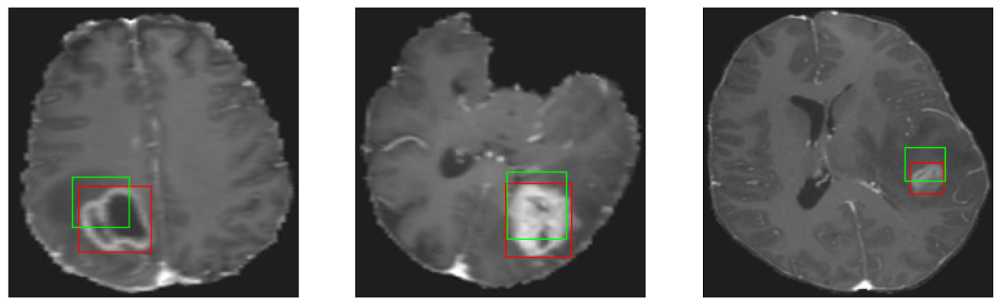

26/26 [==============================] - 8s 311ms/step - loss: 5.4374 - IoU: 0.5889 - val_loss: 9.4916 - val_IoU: 0.4811
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 5.3206 - IoU: 0.5984
Epoch 181: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


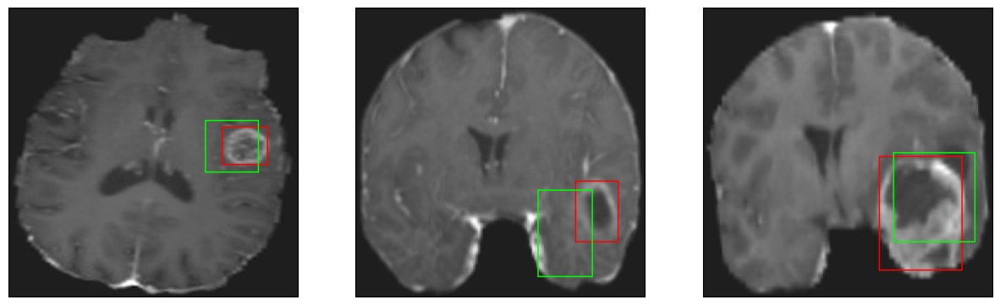

26/26 [==============================] - 8s 303ms/step - loss: 5.3206 - IoU: 0.5984 - val_loss: 10.1768 - val_IoU: 0.4601
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 5.4051 - IoU: 0.5925
Epoch 182: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


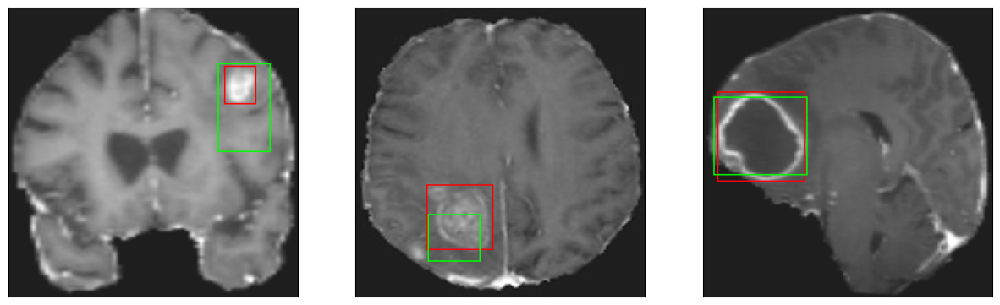

26/26 [==============================] - 7s 274ms/step - loss: 5.4051 - IoU: 0.5925 - val_loss: 10.7137 - val_IoU: 0.4667
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 5.3072 - IoU: 0.5967
Epoch 183: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


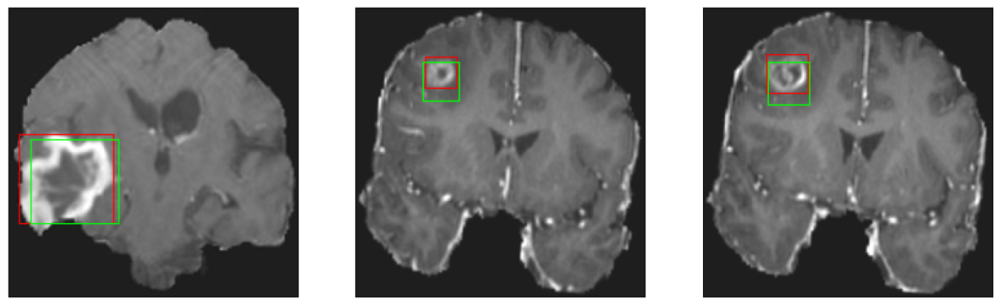

26/26 [==============================] - 8s 300ms/step - loss: 5.3072 - IoU: 0.5967 - val_loss: 8.6211 - val_IoU: 0.5352
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 5.1949 - IoU: 0.5987
Epoch 184: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


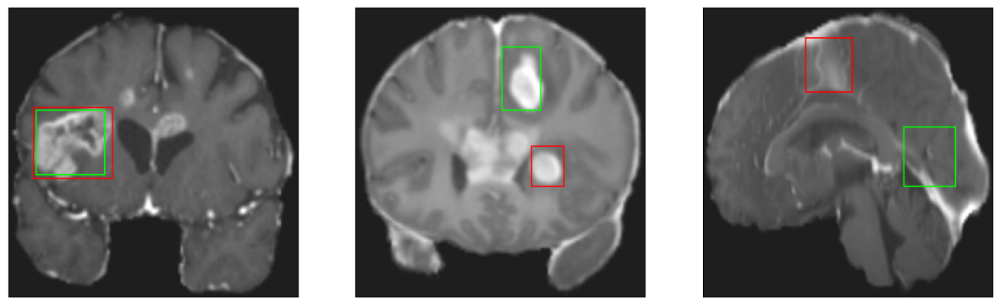

26/26 [==============================] - 8s 303ms/step - loss: 5.1949 - IoU: 0.5987 - val_loss: 12.5364 - val_IoU: 0.4028
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 5.5800 - IoU: 0.5840
Epoch 185: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


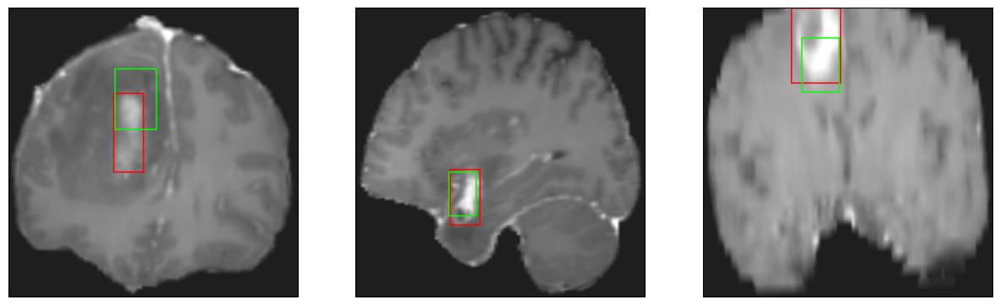

26/26 [==============================] - 7s 289ms/step - loss: 5.5800 - IoU: 0.5840 - val_loss: 9.5242 - val_IoU: 0.4983
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 5.2076 - IoU: 0.6035
Epoch 186: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


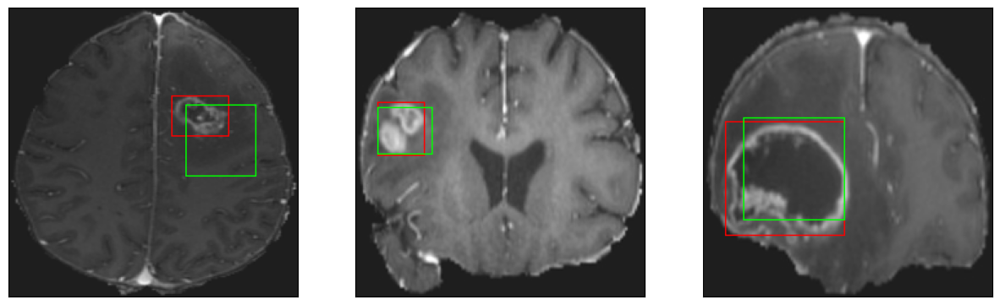

26/26 [==============================] - 8s 305ms/step - loss: 5.2076 - IoU: 0.6035 - val_loss: 7.8616 - val_IoU: 0.5588
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 5.3142 - IoU: 0.5857
Epoch 187: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


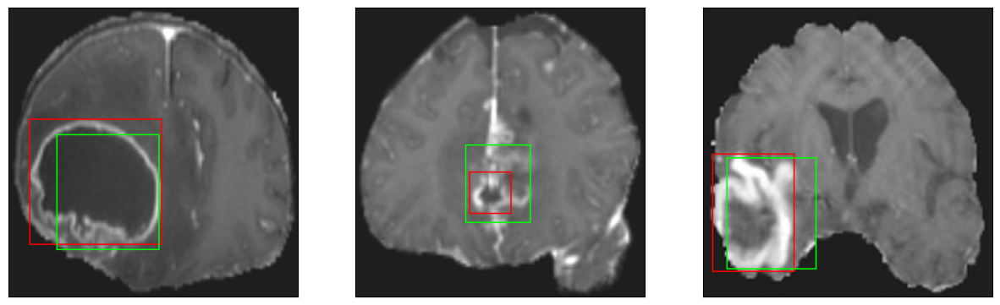

26/26 [==============================] - 8s 307ms/step - loss: 5.3142 - IoU: 0.5857 - val_loss: 8.3340 - val_IoU: 0.5275
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 5.6074 - IoU: 0.5810
Epoch 188: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


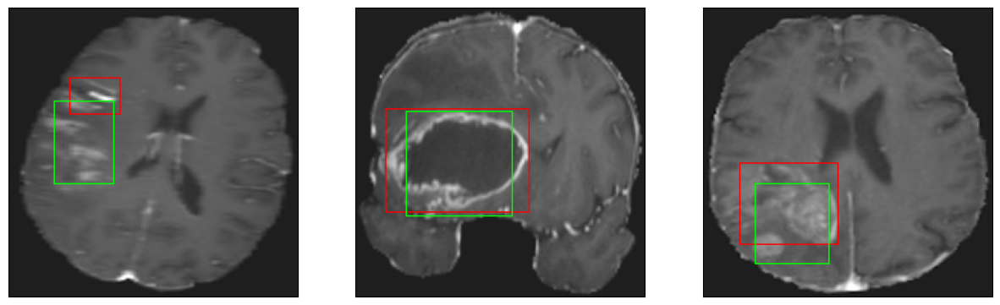

26/26 [==============================] - 8s 292ms/step - loss: 5.6074 - IoU: 0.5810 - val_loss: 8.5840 - val_IoU: 0.5290
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 5.4445 - IoU: 0.5880
Epoch 189: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


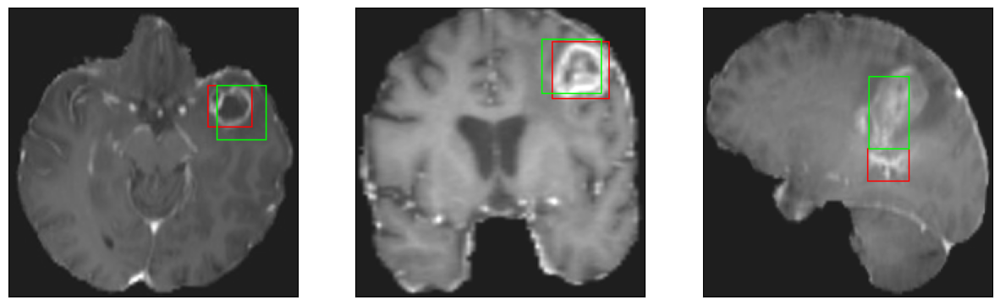

26/26 [==============================] - 8s 306ms/step - loss: 5.4445 - IoU: 0.5880 - val_loss: 8.1412 - val_IoU: 0.5502
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 5.4180 - IoU: 0.5861
Epoch 190: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


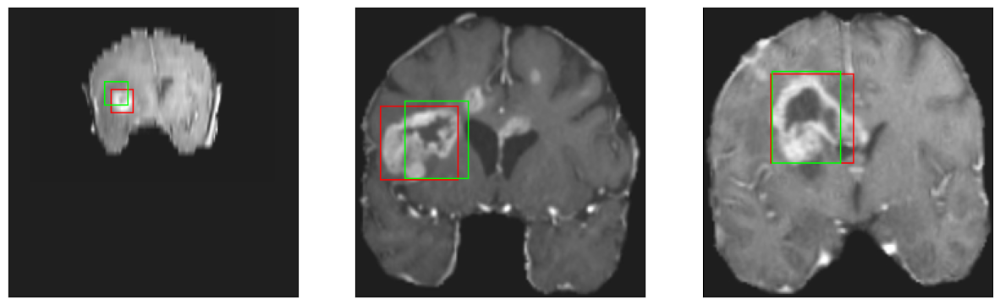

26/26 [==============================] - 7s 278ms/step - loss: 5.4180 - IoU: 0.5861 - val_loss: 8.0576 - val_IoU: 0.5566
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 5.2497 - IoU: 0.5981
Epoch 191: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


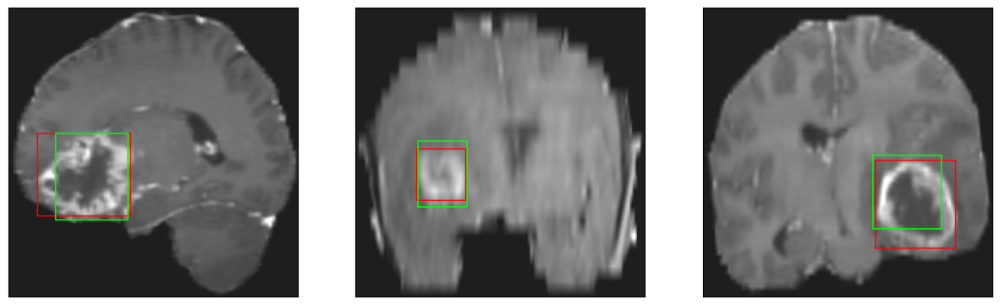

26/26 [==============================] - 7s 284ms/step - loss: 5.2497 - IoU: 0.5981 - val_loss: 9.3993 - val_IoU: 0.4907
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 5.6551 - IoU: 0.5794
Epoch 192: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 44ms/step
4


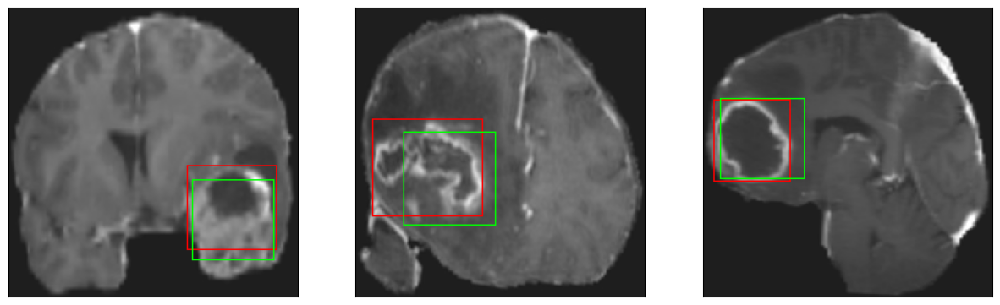

26/26 [==============================] - 8s 305ms/step - loss: 5.6551 - IoU: 0.5794 - val_loss: 7.6673 - val_IoU: 0.5474
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 5.0192 - IoU: 0.6100
Epoch 193: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


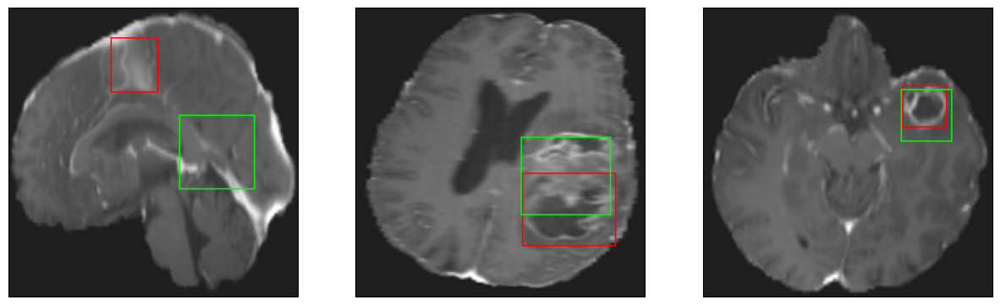

26/26 [==============================] - 7s 278ms/step - loss: 5.0192 - IoU: 0.6100 - val_loss: 7.8226 - val_IoU: 0.5751
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 5.4214 - IoU: 0.5924
Epoch 194: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


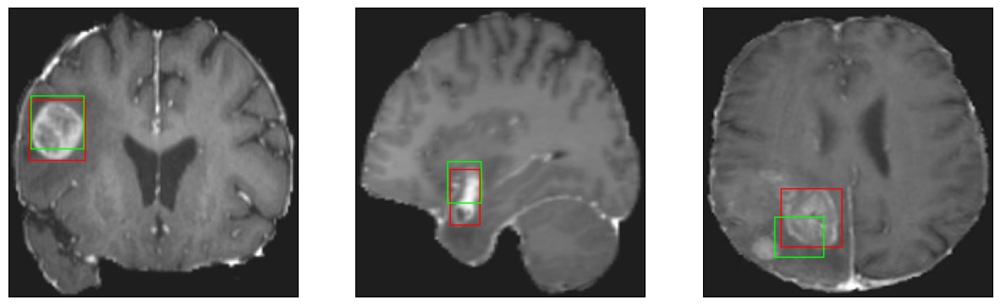

26/26 [==============================] - 8s 292ms/step - loss: 5.4214 - IoU: 0.5924 - val_loss: 8.5550 - val_IoU: 0.5286
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 5.3048 - IoU: 0.5947
Epoch 195: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


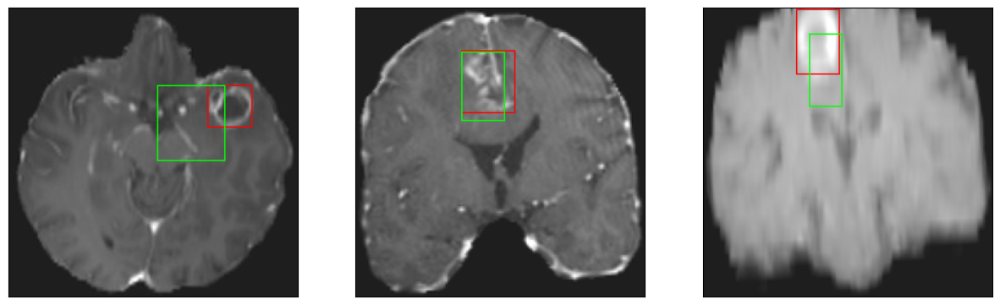

26/26 [==============================] - 8s 310ms/step - loss: 5.3048 - IoU: 0.5947 - val_loss: 12.4944 - val_IoU: 0.4126
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 5.2158 - IoU: 0.6029
Epoch 196: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


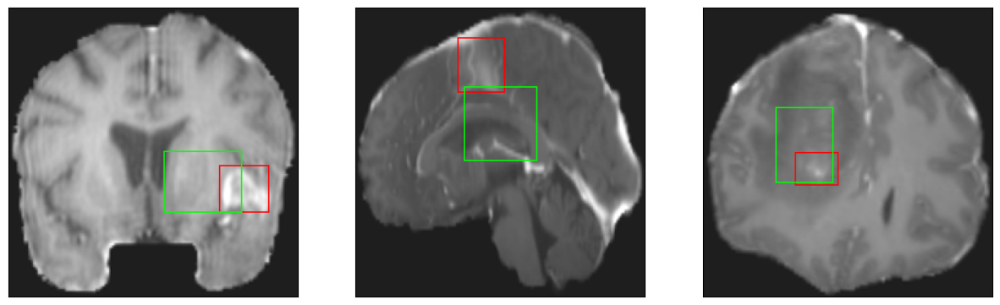

26/26 [==============================] - 8s 308ms/step - loss: 5.2158 - IoU: 0.6029 - val_loss: 8.4005 - val_IoU: 0.5296
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 5.2149 - IoU: 0.5883
Epoch 197: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


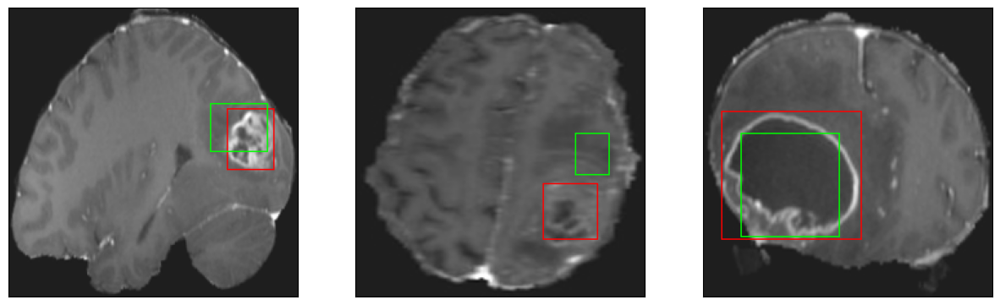

26/26 [==============================] - 7s 286ms/step - loss: 5.2149 - IoU: 0.5883 - val_loss: 8.3543 - val_IoU: 0.5342
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 5.2738 - IoU: 0.6018
Epoch 198: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


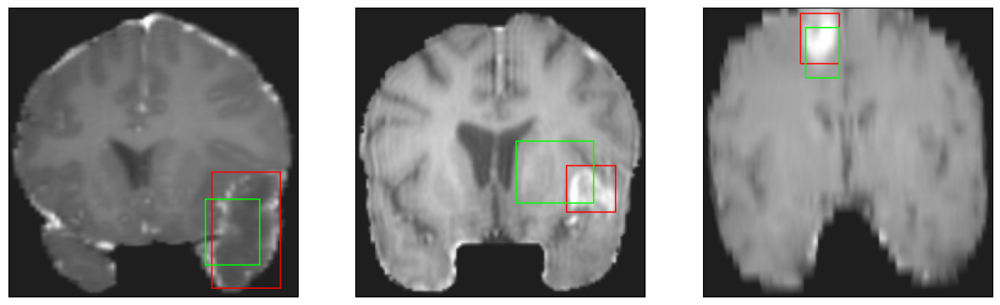

26/26 [==============================] - 8s 301ms/step - loss: 5.2738 - IoU: 0.6018 - val_loss: 8.4079 - val_IoU: 0.5300
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 5.0877 - IoU: 0.6123
Epoch 199: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


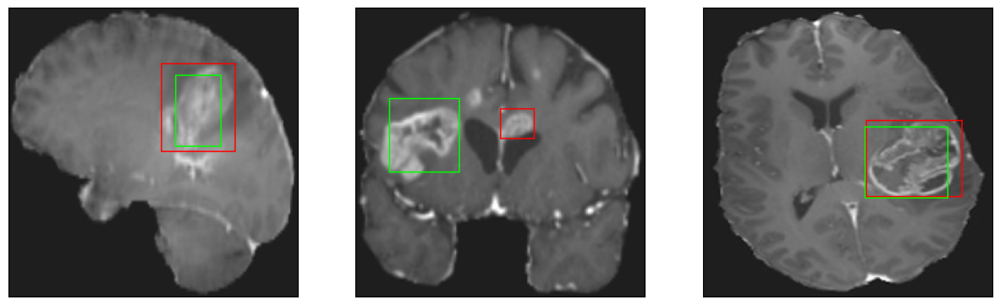

26/26 [==============================] - 8s 309ms/step - loss: 5.0877 - IoU: 0.6123 - val_loss: 8.1779 - val_IoU: 0.5409
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 5.0329 - IoU: 0.6209
Epoch 200: val_IoU did not improve from 0.57625
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


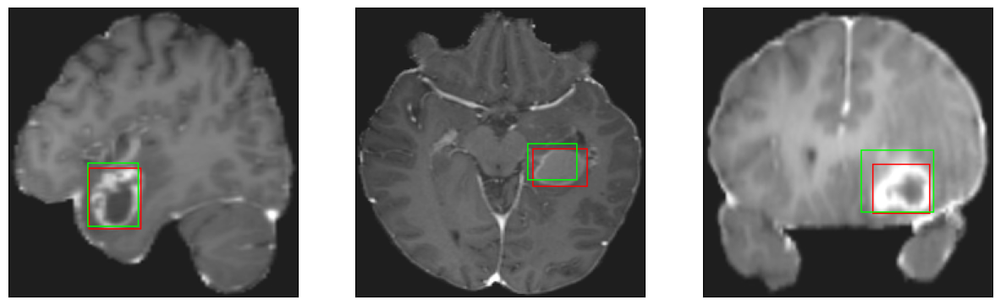

26/26 [==============================] - 8s 295ms/step - loss: 5.0329 - IoU: 0.6209 - val_loss: 8.1761 - val_IoU: 0.5462


In [25]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

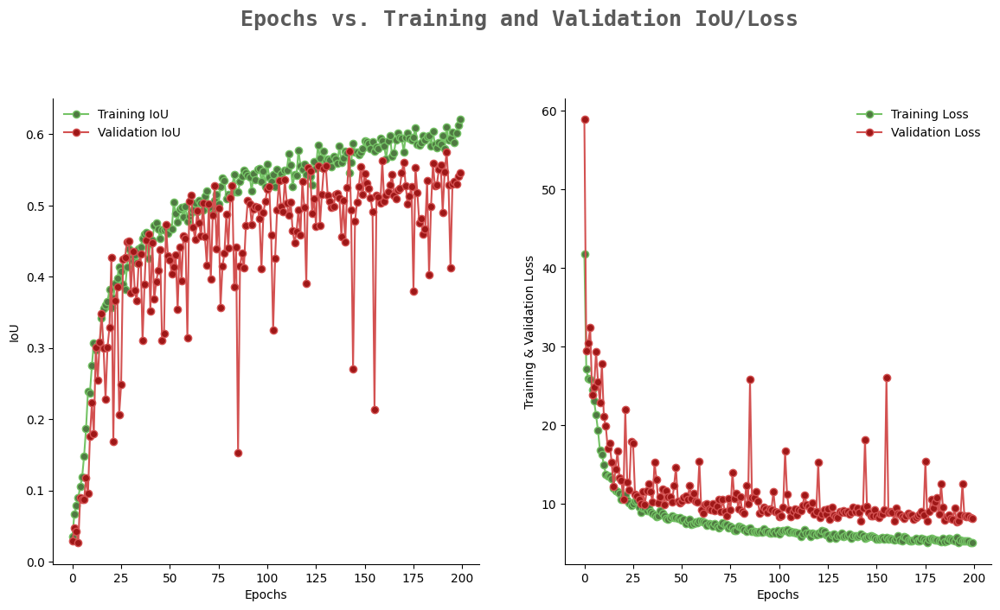

In [26]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [27]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [28]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [29]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 59ms/step - loss: 9.5540 - IoU: 0.4852


[9.554008483886719, 0.48516613245010376]